# Demographic Visualization

In [1]:
# Import Packages
import pandas as pd 
import matplotlib.pyplot as plt
import geopandas as gpd
import seaborn as sns
import json
import pyproj
import math
import numpy as np
import geopandas as gpd
from shapely.geometry import Point
import math
from decimal import Decimal, getcontext
import time
from geopandas import GeoDataFrame

/Users/apple/opt/anaconda3/lib/python3.9/site-packages/geopandas/_compat.py:123: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/var/folders/21/l9ygcw6d6w39m02vcn2t_j6r0000gn/T/ipykernel_72051/1301756820.py:4: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS functions on geometries from GeoPandas), this will then stop working and you are encouraged to migrate from PyGEOS to Shapely 2.0 (https:/

## Read Data

There collected dataset including:

1. Ethnic Group


2. Age Group


3. General Health


4. Income

In [1890]:
# Read Data

# Ethinic Group
ethnic_group_df = pd.read_excel('./data/demographic_dataset/Ethnic group.xlsx', sheet_name='2021',engine="openpyxl")

# Age Group
age_group_df = pd.read_excel('./data/demographic_dataset/Five year age bands.xlsx', sheet_name='2021',engine="openpyxl")

# General Health
general_hea_df = pd.read_excel('./data/demographic_dataset/General health.xlsx', sheet_name='2021',engine="openpyxl")

# Income
income_df = pd.read_excel('./data/demographic_dataset/modelled-household-income-estimates-lsoa2.xlsx', sheet_name='income',engine="openpyxl")

#### Data Preprocessing

### Ethinic Group

1. 将Ethnic group聚合为："White", "Asian", "Black"

In [1891]:
# 将所有列的首行大小写置换并替换空格
ethnic_group_df.columns = [col.lower().replace(' ', '_') for col in ethnic_group_df.columns]

# Total white 
ethnic_group_df['white_total'] = ethnic_group_df['white_british'] + ethnic_group_df['white_irish'] + ethnic_group_df['white_gypsy/irish_traveller'] + \
                                                       ethnic_group_df['white_roma'] + ethnic_group_df['white_other']

# Total Asian
ethnic_group_df['asian_total'] = ethnic_group_df['asian_bangladeshi'] + ethnic_group_df['asian_chinese'] + ethnic_group_df['asian_indian'] + \
                                 ethnic_group_df['asian_other'] + ethnic_group_df['asian_pakistani']


# Total Black
ethnic_group_df['black_total'] = ethnic_group_df['black_african'] + ethnic_group_df['black_caribbean'] + ethnic_group_df['black_other']

In [1892]:
selected_columns = ['lsoa_code', 'local_authority_name', 'all_usual_residents', 'white_total', 'asian_total', 'black_total','asian_bangladeshi','asian_chinese','asian_indian','asian_other','asian_pakistani','white_british','white_irish','white_gypsy/irish_traveller','white_roma','black_african', 'black_caribbean']

ethnic_df = ethnic_group_df[selected_columns]

### Age Group

1. 将Age group聚合为:"teenager", "young", "middle", "old"

In [1851]:
#age_group_df.columns
age_group_df.columns = [col.lower().replace(' ', '_') for col in age_group_df.columns]

# Total teeneger
age_group_df['teenager_age'] = age_group_df['aged_10_to_14'] + age_group_df['aged_15_to_19']

# Total Young Adult
age_group_df['young_age'] = age_group_df['aged_20_to_24'] + age_group_df['aged_25_to_29'] +  age_group_df['aged_30_to_34'] + age_group_df['aged_35_to_39']

# Total Middle Age
age_group_df['middle_age'] = age_group_df['aged_40_to_44'] + age_group_df['aged_45_to_49'] + age_group_df['aged_50_to_54'] + age_group_df['aged_55_to_59'] + age_group_df['aged_60_to_64']

# Total Old
age_group_df['old_age'] = age_group_df['aged_65_to_69'] + age_group_df['aged_70_to_74'] + age_group_df['aged_75_to_79'] + age_group_df['aged_80_to_84'] + age_group_df['aged_85_and_over']

In [1852]:
selected_columns = ['lsoa_code', 'local_authority_name', 'all_usual_residents', 'teenager_age',
                    'young_age', 'middle_age', 'old_age']
age_df = age_group_df[selected_columns]

### General Health

1. 将Health聚合为:"Good", "Fair", "Bad"

In [1853]:
#health_df.columns
general_hea_df.columns =[col.lower().replace(' ', '_') for col in general_hea_df.columns]

# Total Good
general_hea_df['health_good'] = general_hea_df['very_good_health'] + general_hea_df['good_health']

# Total Fair
general_hea_df['health_fair'] = general_hea_df['fair_health']

# Total bad
general_hea_df['health_bad'] = general_hea_df['bad_health'] + general_hea_df['very_bad_health']

In [1854]:
selected_columns = ['lsoa_code','local_authority_name', 'all_usual_residents_', 'health_good',
                    'health_fair', 'health_bad']
health_df = general_hea_df[selected_columns]

### Income

1. Income通过计算2010，2011，2012年三年的平均房价获得

In [1855]:
# income_df columns
income_df.columns =[col.lower().replace(' ', '_') for col in income_df.columns]

# 
income_df['house_pri'] = (income_df['mean_2010/11'] + income_df['mean_2011/12'] + income_df['mean_2012/13'])/ 3

income_df.rename(columns={'code': 'lsoa_code'}, inplace=True)

In [1856]:
selected_columns = ['lsoa_code', 'name', 'house_pri']
income_df = income_df[selected_columns]

## Visalization

### Read Shp Files

In [1883]:
# 读取.shp文件
file_path = "data/demographic_dataset/ESRI/LSOA_2011_London_gen_MHW.shp"
#ile_path = 'data/demographic_dataset/lsoa_2021/LSOA_2021_EW_BGC.shp'
ldnwards = gpd.read_file(file_path)

# 2011与2021的LSOA转换表格
df_lsoa = pd.read_csv('./data/demographic_dataset/LSOA_(2011)_to_LSOA_(2021)_to_Local_Authority_District_(2022)_Lookup_for_England_and_Wales_(Version_2).csv')

# 2011 LSOA中属于各个城市的表格
df_lsoa1 =  pd.read_csv('./data/demographic_dataset/Lower_Layer_Super_Output_Area_(2011)_to_Major_Towns_and_Cities_(December_2015)_Lookup_in_England_and_Wales (1).csv')

In [1835]:
df_lsoa1[df_lsoa1['TCITY15NM']=='London']

,LSOA11CD,LSOA11NM,TCITY15CD,TCITY15NM,FID
0,E01000001,City of London 001A,J01000055,London,1
1,E01000205,Barnet 035A,J01000055,London,2
2,E01000002,City of London 001B,J01000055,London,3
3,E01000003,City of London 001C,J01000055,London,4
4,E01000206,Barnet 033B,J01000055,London,5
...,...,...,...,...,...
32891,E01033742,Greenwich 007F,J01000055,London,32892
32892,E01033743,Greenwich 002H,J01000055,London,32893
32893,E01033744,Greenwich 007G,J01000055,London,32894
32894,E01033745,Greenwich 002I,J01000055,London,32895


In [1825]:
# 将2011年LSOA与2021年LSOA进行合并
merged_df = pd.merge(df_lsoa, df_lsoa1, on='LSOA11CD',how='left',indicator=True)

# 将2011与2021年已经合并的LSOA再与2021年的地理信息进行合并，
# 得到的DataFrame中包含了2011，2021年的LSOA。
merged_df1 = pd.merge(merged_df, ldnwards, on='LSOA21CD')

In [1826]:
merged_df1.columns

Index(['ObjectId', 'LSOA11CD', 'LSOA11NM_x', 'LSOA21CD', 'LSOA21NM_x',
       'LAD22CD', 'LAD22NM', 'LAD22NMW', 'LSOA11NM_y', 'TCITY15CD',
       'TCITY15NM', 'FID', '_merge', 'LSOA21NM_y', 'GlobalID', 'geometry'],
      dtype='object')

In [1828]:
merged_df2 = merged_df1[['ObjectId','LSOA11CD','LSOA11NM_x','LSOA21CD','LSOA21NM_x','TCITY15NM','geometry']]
#merged_df2 = merged_df1[['ObjectId','LSOA11CD','LSOA11NM_x','LSOA21CD','LSOA21NM','TCITY15NM','geometry']]

merged_df3 = merged_df2[merged_df2['TCITY15NM'] == 'London']
merged_df3

,ObjectId,LSOA11CD,LSOA11NM_x,LSOA21CD,LSOA21NM_x,TCITY15NM,geometry
0,1,E01000001,City of London 001A,E01000001,City of London 001A,London,"POLYGON ((532105.312 182010.574, 532162.491 18..."
1,2,E01000002,City of London 001B,E01000002,City of London 001B,London,"POLYGON ((532634.497 181926.016, 532619.141 18..."
2,3,E01000003,City of London 001C,E01000003,City of London 001C,London,"POLYGON ((532135.138 182198.131, 532158.250 18..."
3,4,E01000005,City of London 001E,E01000005,City of London 001E,London,"POLYGON ((533808.018 180767.774, 533649.037 18..."
4,5,E01000006,Barking and Dagenham 016A,E01000006,Barking and Dagenham 016A,London,"POLYGON ((545122.049 184314.931, 545271.849 18..."
...,...,...,...,...,...,...,...
32817,32818,E01033742,Greenwich 007F,E01033742,Greenwich 007F,London,"POLYGON ((544642.562 179824.750, 544766.313 17..."
32818,32819,E01033743,Greenwich 002H,E01033743,Greenwich 002H,London,"POLYGON ((546593.766 181106.448, 546687.036 18..."
32819,32820,E01033744,Greenwich 007G,E01033744,Greenwich 007G,London,"POLYGON ((544536.458 179447.150, 544602.630 17..."
32820,32821,E01033745,Greenwich 002I,E01033745,Greenwich 002I,London,"POLYGON ((546415.745 180152.270, 546320.715 18..."


In [1829]:
london_wards = gpd.GeoDataFrame(merged_df3, geometry='geometry')

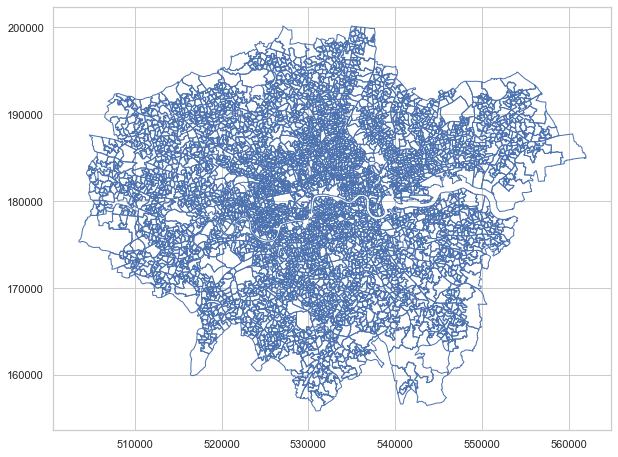

In [1843]:
#Ploting georgraphical boundaries of london wards
london_wards.plot(figsize = (10,15), facecolor = "None", edgecolor = "b")
plt.show()

In [1863]:
lsoa_ldnwards = ldnwards[['LSOA21CD','LSOA21NM','geometry']]
# 将所有列的首行大小写置换并替换空格
lsoa_ldnwards.columns = [col.lower().replace(' ', '_') for col in lsoa_ldnwards.columns]
lsoa_ldnwards.rename(columns={'lsoa21cd': 'lsoa_code'}, inplace=True)

/Users/apple/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:4300: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [1864]:
london_wards.columns = [col.lower().replace(' ', '_') for col in london_wards.columns]
london_wards.rename(columns={'lsoa11cd': 'lsoa_code'}, inplace=True)
london_wards

,objectid,lsoa_code,lsoa11nm_x,lsoa21cd,lsoa21nm_x,tcity15nm,geometry
0,1,E01000001,City of London 001A,E01000001,City of London 001A,London,"POLYGON ((532105.312 182010.574, 532162.491 18..."
1,2,E01000002,City of London 001B,E01000002,City of London 001B,London,"POLYGON ((532634.497 181926.016, 532619.141 18..."
2,3,E01000003,City of London 001C,E01000003,City of London 001C,London,"POLYGON ((532135.138 182198.131, 532158.250 18..."
3,4,E01000005,City of London 001E,E01000005,City of London 001E,London,"POLYGON ((533808.018 180767.774, 533649.037 18..."
4,5,E01000006,Barking and Dagenham 016A,E01000006,Barking and Dagenham 016A,London,"POLYGON ((545122.049 184314.931, 545271.849 18..."
...,...,...,...,...,...,...,...
32817,32818,E01033742,Greenwich 007F,E01033742,Greenwich 007F,London,"POLYGON ((544642.562 179824.750, 544766.313 17..."
32818,32819,E01033743,Greenwich 002H,E01033743,Greenwich 002H,London,"POLYGON ((546593.766 181106.448, 546687.036 18..."
32819,32820,E01033744,Greenwich 007G,E01033744,Greenwich 007G,London,"POLYGON ((544536.458 179447.150, 544602.630 17..."
32820,32821,E01033745,Greenwich 002I,E01033745,Greenwich 002I,London,"POLYGON ((546415.745 180152.270, 546320.715 18..."


### Ethinic Group

#### Visualization

In [1857]:
# 查看london_wards中不存在，但是ethnic_df中存在的LSOA：

# 合并两个DataFrame，并标记来自不同DataFrame的数据行
merged = pd.merge(ethnic_df, lsoa_ldnwards, on='lsoa_code', how='left', indicator=True)

# 筛选出在df1中存在但在df2中不存在的数据行
not_in_df2 = merged.query('_merge == "left_only"')

not_in_df2

,lsoa_code,local_authority_name,all_usual_residents,white_total,asian_total,black_total,asian_bangladeshi,asian_chinese,asian_indian,asian_other,asian_pakistani,white_british,white_irish,white_gypsy/irish_traveller,white_roma,black_african,black_caribbean,lsoa21nm,geometry,_merge


**补齐有空缺的LSOA**
方法：

1. 筛选出ethnic_df中geometry数据为空的所有数据行


2. 将ldnwards中的'geometry'列与ethnic_df中匹配的'lsoa_code'数据进行合并


3. 将ldnwards中的'geometry'赋值给ethnic_df中的'geometry'


**Asian & White & Black**

In [1893]:
#ldnwards
ldnwards.columns = [col.lower().replace(' ', '_') for col in ldnwards.columns]
ldnwards.rename(columns={'lsoa11cd': 'lsoa_code'}, inplace=True)

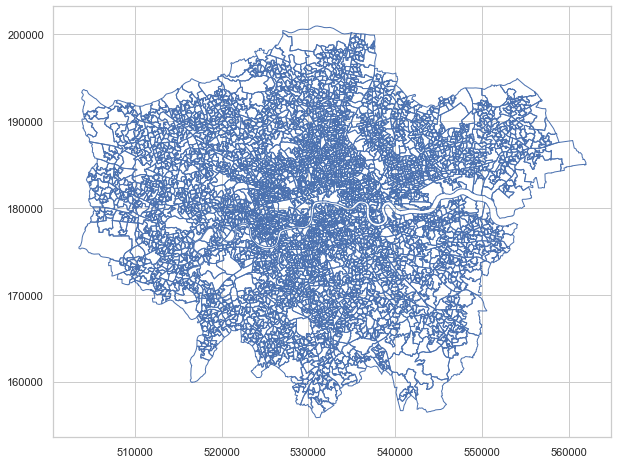

In [1897]:
ldnwards.plot(figsize = (10,15), facecolor = "None", edgecolor = "b")
plt.show()

In [1894]:
# Merge the lsoa geometry dataframe with the ethnic dataframe
#ethnic_df = ethnic_df.merge(london_wards, on='lsoa_code',how='left',indicator=True)
ethnic_df = ethnic_df.merge(ldnwards, on='lsoa_code',how='left',indicator=True)

# 假设df1和df2是两个DataFrame，其中包含'lsoa_code'和'geometry'列

# 筛选出dataframe1中geometry数据为空的所有数据行
empty_geometry_rows = ethnic_df[ethnic_df['geometry'].isnull()]

# 将dataframe2中'geometry'列与dataframe1中匹配的'lsoa_code'数据进行合并
merged_df = pd.merge(empty_geometry_rows[['lsoa_code']], lsoa_ldnwards[['lsoa_code', 'geometry']], on='lsoa_code', how='left')

# 将dataframe2中的'geometry'赋值给dataframe1中的'geometry'
ethnic_df.loc[ethnic_df['geometry'].isnull(), 'geometry'] = merged_df['geometry'].values

#Transform the dataframe into a geometry dataframe
ethnic_df = GeoDataFrame(ethnic_df)

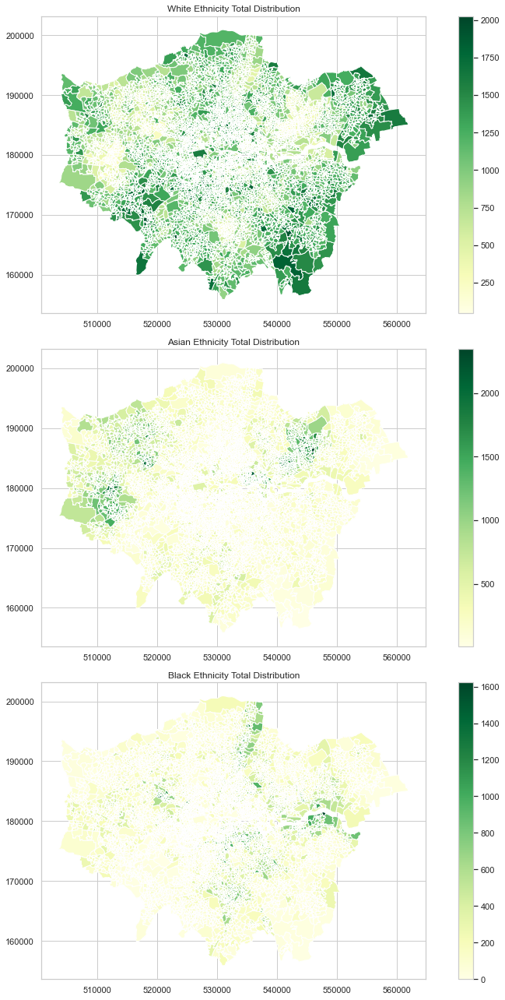

In [1895]:
import matplotlib.pyplot as plt

# Transform london to BNG
ethnic_df.to_crs("EPSG:27700", inplace=True)

# Create a 3x1 subplot layout
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(12, 18))

# Plot the white people distribution
attr = "white_total"
ax = ethnic_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[0])
ax.set_title('White Ethnicity Total Distribution')

# Plot the Asian distribution
attr = "asian_total"
ax = ethnic_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[1])
ax.set_title('Asian Ethnicity Total Distribution')

# Plot the Black distribution
attr = "black_total"
ax = ethnic_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[2])
ax.set_title('Black Ethnicity Total Distribution')

# Adjust spacing between subplots
plt.tight_layout()
plt.savefig('total_ethnicity.pdf')
# Show the subplots
plt.show()


In [182]:
ethnic_df.columns

Index(['lsoa_code', 'local_authority_name', 'all_usual_residents',
       'white_total', 'asian_total', 'black_total', 'asian_bangladeshi',
       'asian_chinese', 'asian_indian', 'asian_other', 'asian_pakistani',
       'objectid', 'lsoa11nm_x', 'lsoa21cd', 'lsoa21nm_x', 'tcity15nm',
       'geometry', '_merge'],
      dtype='object')

**Within Asian**

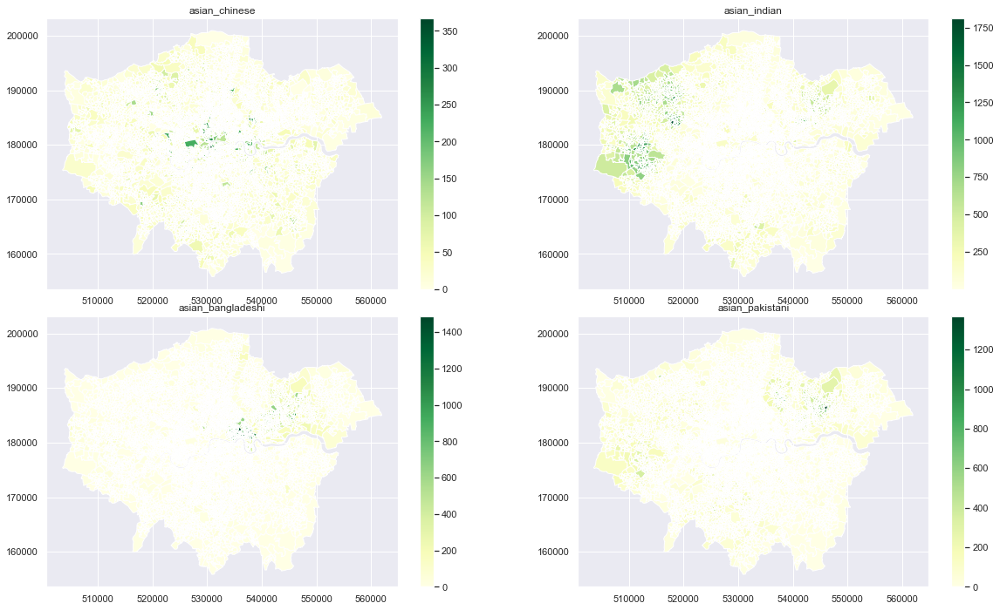

In [1187]:
import matplotlib.pyplot as plt

# Transform London to BNG
ethnic_df.to_crs("EPSG:27700", inplace=True)

# Create a 2x2 main subplot layout
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(20, 12))

# Define the attributes for each subplot
attributes = ["asian_chinese", "asian_indian", "asian_bangladeshi", "asian_pakistani"]

# Create subplots for each ethnic distribution
for i, attr in enumerate(attributes):
    row = i // 2
    col = i % 2
    ax = axs[row, col]

    # Plot the ethnic distribution on the subplot
    ethnic_df.plot(column=attr, cmap='YlGn', legend=True, ax=ax)
    ax.set_title(attr)

# Adjust the space between subplots
plt.subplots_adjust(wspace=0.2, hspace=0.1)
plt.savefig('within_Asian.pdf')
# Show the main plot with subplots
plt.show()

**Within White**

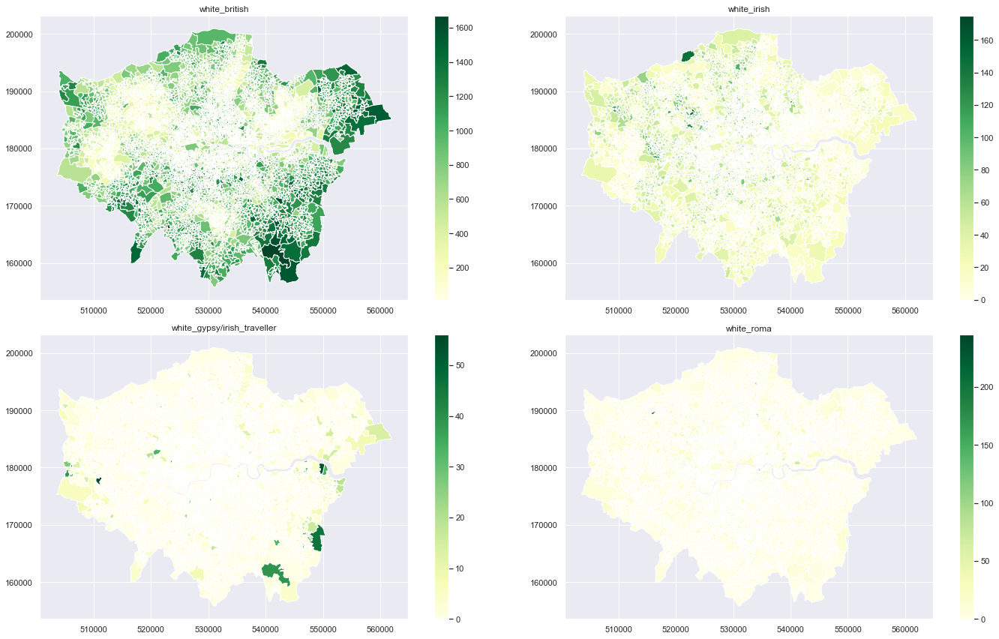

In [1165]:
import matplotlib.pyplot as plt

# Transform london to BNG
ethnic_df.to_crs("EPSG:27700", inplace=True)

# Create a 2x2 subplot layout
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(20, 12))

# Plot the white_british distribution
attr = "white_british"
ax = ethnic_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[0, 0])
ax.set_title(attr)

# Plot the white_irish distribution
attr = "white_irish"
ax = ethnic_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[0, 1])
ax.set_title(attr)

# Plot the white_gypsy/irish_traveller distribution
attr = "white_gypsy/irish_traveller"
ax = ethnic_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[1, 0])
ax.set_title(attr)

# Plot the white_roma distribution
attr = "white_roma"
ax = ethnic_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[1, 1])
ax.set_title(attr)

# Adjust spacing between subplots
plt.tight_layout()
plt.savefig('within_white.pdf')
# Show the subplots
plt.show()


**Within Black**

In [1154]:
ethnic_df.columns

Index(['lsoa_code', 'local_authority_name', 'all_usual_residents',
       'white_total', 'asian_total', 'black_total', 'asian_bangladeshi',
       'asian_chinese', 'asian_indian', 'asian_other', 'asian_pakistani',
       'white_british', 'white_irish', 'white_gypsy/irish_traveller',
       'white_roma', 'black_african', 'black_caribbean', 'objectid',
       'lsoa11nm_x', 'lsoa21cd', 'lsoa21nm_x', 'tcity15nm', 'geometry',
       '_merge'],
      dtype='object')

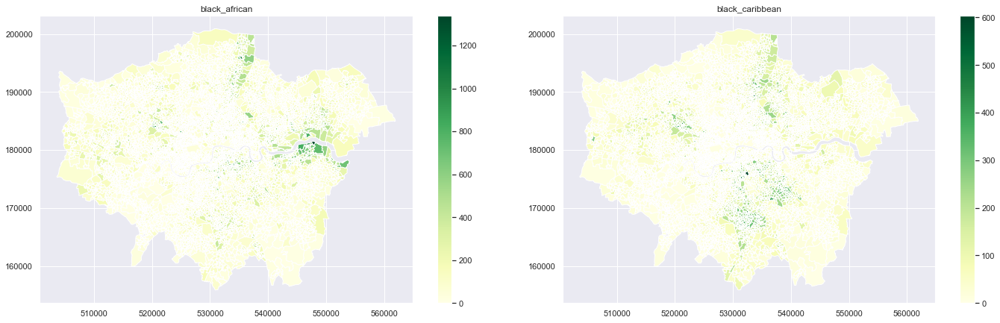

In [1181]:
import matplotlib.pyplot as plt

# Transform london to BNG
ethnic_df.to_crs("EPSG:27700", inplace=True)

# Create a 2x1 subplot layout
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(20, 6))

# Plot the black_african distribution
attr = "black_african"
axs[0].set_title(attr)
ethnic_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[0])

# Plot the black_caribbean distribution
attr = "black_caribbean"
axs[1].set_title(attr)
ethnic_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[1])

# Adjust spacing between subplots
plt.tight_layout()
plt.savefig("within_black.pdf")
# Show the subplots
plt.show()


In [218]:
asian_df.columns

Index(['lsoa_code', 'local_authority_name', 'all_usual_residents',
       'white_total', 'asian_total', 'black_total', 'asian_bangladeshi',
       'asian_chinese', 'asian_indian', 'asian_other', 'asian_pakistani',
       'white_british', 'white_irish', 'white_gypsy/irish_traveller',
       'white_roma', 'black_african', 'black_caribbean', 'objectid',
       'lsoa11nm_x', 'lsoa21cd', 'lsoa21nm_x', 'tcity15nm', 'geometry',
       '_merge'],
      dtype='object')

In [240]:
ethnic_df['white_total_per'] = ethnic_df['white_total'] / ethnic_df['all_usual_residents']
ethnic_df['asian_total_per'] = ethnic_df['asian_total'] / ethnic_df['all_usual_residents']
ethnic_df['black_total_per'] = ethnic_df['black_total'] / ethnic_df['all_usual_residents']


ethnic_df['white_british_per'] = ethnic_df['white_british'] / ethnic_df['all_usual_residents']
ethnic_df['white_irish_per'] = ethnic_df['white_irish'] / ethnic_df['all_usual_residents']
ethnic_df['white_gypsy/irish_traveller_per'] = ethnic_df['white_gypsy/irish_traveller'] / ethnic_df['all_usual_residents']
ethnic_df['white_roma_per'] = ethnic_df['white_roma'] / ethnic_df['all_usual_residents']

ethnic_df['asian_bangladeshi_per'] = ethnic_df['asian_bangladeshi'] / ethnic_df['all_usual_residents']
ethnic_df['asian_chinese_per'] = ethnic_df['asian_chinese'] / ethnic_df['all_usual_residents']
ethnic_df['asian_indian_per'] = ethnic_df['asian_indian'] / ethnic_df['all_usual_residents']
ethnic_df['asian_pakistani_per'] = ethnic_df['asian_pakistani'] / ethnic_df['all_usual_residents']


ethnic_df['black_african_per'] = ethnic_df['black_african'] / ethnic_df['all_usual_residents']
ethnic_df['black_caribbean_per'] = ethnic_df['black_caribbean'] / ethnic_df['all_usual_residents']

In [250]:
tmp_df = ethnic_df.sort_values(by='black_caribbean_per', ascending=False).head(100)
value_counts = tmp_df['local_authority_name'].value_counts(ascending=False)
value_counts

Croydon                   39
Lewisham                  26
Lambeth                   18
Brent                      6
Haringey                   3
Wandsworth                 2
Southwark                  2
Kensington and Chelsea     1
Waltham Forest             1
Hackney                    1
Enfield                    1
Name: local_authority_name, dtype: int64

#### Visualization Description

人口的分布显示出显著的隔离状况；

方法：1.将某族裔按人口占该区域比例，从上到下对区域进行排序；2.获取排名前100中，出现次数最多的区域；3.对这些区域进行社区数据收集


对于白人：

1. 白人族裔在整个伦敦都分布很广，是研究划分的三个族裔中最多的。其中Richmond upon Thames, Bromley, Bexley, Havering的白人居住率非常高。对于这些社区，https://www.uklocalarea.com/ 网站数据表明。例如Richmond upon Thames中，整个社区环境（包括Income Deprivation, Employment Health, Education, Barriers to Services, Living Envirnment, Crime）优于74.46英格兰的其他区域,其中'St Margarets and North Twichenham'优于85.86%的区域；而Bromley整体社区环境优于61的其他区域。虽然这些区域总体上拥有较优的社区，但是每个区域内也有区别。例如对于Bromley来说，Cray Valley East，Cray Valley West，Petts Wood and Knoll，Shortlands都是属于该区域的LSOA。但是前两者的社区环境比其他69%的区域差，而后两者分别优于91%，87%的区域。

2. 其中British在Havering，Bromley，Bexley区域具有最多人口占比，而irish则在Brent，Ealing, Islington有较多人口。white_gypsy/irish_traveller在Bexley和Bromley出现集中。而Roma则没有显著片区聚集


对于亚洲人：

1. 亚洲人分布相对白人较为集中，集中分布在Great London Authority(GLA)的西部和东北部，其中Redbridge, Newham, Ealing, Hounslow, Tower Hamlets, Brent区域出现较密集的聚集。这些区域中亚洲人聚集最密集的Redbridge比47%的其他区域更优。因为asian的分类包含了chinese, indian, bangladeshi, pakistani。其中这其中分布也存在明显隔离情况。

其中chinese主要分布在中部和东部，Tower Hamlets（社区环境一般，但是教育可达性高于平均水准），Southwark（社区环境中等，但教育水平表现突出），Camden（交通便利，教育水平同样突出）

Indian主要分布在伦敦西部：Hounslow, Ealing, Brent；在距离city of london比较远的地方。

bangladeshi在Tower Hamlets处出现聚集，此区域为英国最大的穆斯林社区，超过30%人口为孟加拉裔

pakistani主要分布在：东北部例如Redbridge, Newham


对于黑人：
1. 黑人在伦敦的北部，南部以及东部分布较为明显。例如Southwark, Lewisham, Greenwich, Lambeth等地区。

其中black_african在greenwich, southwark, bexley的分布较为明显

而black_caribbean在croydon, lewisham, lambeth等地具有较多的人口占比。


Richmond upon Thames:

1. Barnes: (91 + 73 + 82 + 64 + 89 + 89 + 31) / 7

2. East Sheen (88 + 98 + 81 + 78 + 84 + 89) / 6

3. Fulwell and Hampton Hill, (85 + 81 + 78 + 93 + 72 + 69) / 6

4. Ham, Peterham and Richmond Riverside (65 + 66 + 76 + 27 + 61 + 87)/6

5. Hampton (96 + 76 + 89 + 93 + 36 + 71)/6

6. Hampton North (87 + 28 + 73 + 63 + 17 + 48)/6

7. Hampton Wick (68 + 92 + 58 + 82 + 84 + 60)/6

8. Heathfield (53 + 27 + 47 + 52 + 81 + 79)/6

9. Kew (95 + 85 + 67 + 84 + 10 + 92) / 6

10. Mortlake and Barnes Common (57 + 62 + 69 + 44 + 79 + 84 + 94)/7

11. North Richmond (91 + 80 + 72 + 51 + 49 + 83 + 67)/7

12. St Margarets and North Twichenham (96 + 75 + 85 + 91 + 81 + 93 + 80)/7

13. South Richmond (78 + 87 + 83 + 73 + 90 + 44 + 91)/7

14. South Twickenham (88 + 91 + 86 + 89 + 82 + 84)/6

15. Teddington (93 + 92 + 59 + 87 +84 + 96)/6

16. Twickenham Riverside (89 + 82 + 89 + 77 + 75 + 77)/6

17. West Twickenham (84 + 89 + 39 + 86 + 87 + 60 + 79)/7

18. Whitton (82 + 62 + 35 + 88 + 76 + 89)/6

计算公式：
(((91 + 73 + 82 + 64 + 89 + 89 + 31) / 7) +\
((88 + 98 + 81 + 78 + 84 + 89) / 6)+\
((85 + 81 + 78 + 93 + 72 + 69) / 6)+\
((65 + 66 + 76 + 27 + 61 + 87)/6) +\
((96 + 76 + 89 + 93 + 36 + 71)/6) +\
((87 + 28 + 73 + 63 + 17 + 48)/6) +\
((68 + 92 + 58 + 82 + 84 + 60)/6) +\
((53 + 27 + 47 + 52 + 81 + 79)/6) +\
((95 + 85 + 67 + 84 + 10 + 92) / 6) +\
((57 + 62 + 69 + 44 + 79 + 84 + 94)/7) +\
((91 + 80 + 72 + 51 + 49 + 83 + 67)/7) +\
((96 + 75 + 85 + 91 + 81 + 93 + 80)/7) +\
((78 + 87 + 83 + 73 + 90 + 44 + 91)/7) +\
((88 + 91 + 86 + 89 + 82 + 84)/6) +\
((93 + 92 + 59 + 87 +84 + 96)/6) +\
((89 + 82 + 89 + 77 + 75 + 77)/6) +\
((84 + 89 + 39 + 86 + 87 + 60 + 79)/7) +\
((82 + 62 + 35 + 88 + 76 + 89)/6))/18

Bromley:

1. Bickley (98 + 76 + 85 + 86 + 73 + 69 + 72 + 92 + 79)/9

2. Biggin Hill (78 + 70 + 85 + 65 + 84 + 75 + 10)/10

3. Bromley Common and Keston (10 + 47 + 46 + 47 + 65 + 93 + 88 + 65 + 77)/9

4. Bromley Town (84 + 70 + 79 + 77 + 61 + 62 + 30 + 58 + 74 + 77)/10

5. Chelsfield and Pratts Bottom (78 + 98 + 97 + 63 + 98 + 60 + 85 + 89 + 98)/9

6. Chislehurst (28 + 76 + 59 + 81 + 62 + 91 + 77 +84 + 96 + 83)/10

7. Clock House (38 + 59 + 61 + 65 + 64 + 62 + 45 + 51 + 97 + 77 + 56)/11

8. Copers Cope (67 + 63 + 86 + 85 + 66 + 82 + 82 + 79 + 24)/9

low 9. Cray Valley East (26 + 10 + 10 + 36 + 61 + 14 + 29 + 57 + 52 + 35)/10 

low 10. Cray Valley West (11 + 11 + 31 + 63 + 37 + 67 + 21 + 28 + 20 + 42 + 10)/11

11. Crystal Palace (22 + 21 + 29 + 11 + 10 + 38 + 39)/7

12. Darwin (42 + 60 + 71)/3

13. Farnborough and Crofton (24 + 84 + 79 + 90 + 81 + 90 + 93 + 93 + 93 + 93)/10

high 14. Hayes and Coney Hall (81 + 72 + 82 + 88 + 92 + 68 + 84 + 98 + 96 + 86)/10

15. Mottingham and Chislehurst North (47 + 31 + 12 + 10 + 14 + 73 + 18)/7

16. Orpington (60 + 36 + 34 + 13 + 52 + 69 + 39 +95 + 95 + 56)/10

17. Penge and Cator (14 + 62 + 10 + 36 + 22 + 34 + 38 + 46 + 81 + 32 + 20)/11

high18. Petts Wood and Knoll (87 + 89 + 96 + 99 + 92 + 65 + 95 + 97 + 99)/9

19. Plaistow and Sundridge (53 + 10 + 62 + 22 + 40 + 10 + 61 + 77 + 49 + 49)/10

high20. Shortlands (96 + 89 + 72 + 85 + 97 + 81)/6

21. West Wickham(89 + 98 + 97 + 79 + 94 + 67 + 91 + 96 + 80 + 93)/10

计算公式：
(((98 + 76 + 85 + 86 + 73 + 69 + 72 + 92 + 79)/9)+\
((78 + 70 + 85 + 65 + 84 + 75 + 10)/10) +\
((10 + 47 + 46 + 47 + 65 + 93 + 88 + 65 + 77)/9) +\
((84 + 70 + 79 + 77 + 61 + 62 + 30 + 58 + 74 + 77)/10) +\
((78 + 98 + 97 + 63 + 98 + 60 + 85 + 89 + 98)/9) +\
((28 + 76 + 59 + 81 + 62 + 91 + 77 +84 + 96 + 83)/10) +\
((38 + 59 + 61 + 65 + 64 + 62 + 45 + 51 + 97 + 77 + 56)/11) +\
((67 + 63 + 86 + 85 + 66 + 82 + 82 + 79 + 24)/9) +\
((26 + 10 + 10 + 36 + 61 + 14 + 29 + 57 + 52 + 35)/10 ) +\
((11 + 11 + 31 + 63 + 37 + 67 + 21 + 28 + 20 + 42 + 10)/11) +\
((22 + 21 + 29 + 11 + 10 + 38 + 39)/7) +\
((42 + 60 + 71)/3) +\
((24 + 84 + 79 + 90 + 81 + 90 + 93 + 93 + 93 + 93)/10) +\
((81 + 72 + 82 + 88 + 92 + 68 + 84 + 98 + 96 + 86)/10) +\
((47 + 31 + 12 + 10 + 14 + 73 + 18)/7) +\
((60 + 36 + 34 + 13 + 52 + 69 + 39 +95 + 95 + 56)/10) +\
( (14 + 62 + 10 + 36 + 22 + 34 + 38 + 46 + 81 + 32 + 20)/11) +\
((87 + 89 + 96 + 99 + 92 + 65 + 95 + 97 + 99)/9) +\
((53 + 10 + 62 + 22 + 40 + 10 + 61 + 77 + 49 + 49)/10) +\
((96 + 89 + 72 + 85 + 97 + 81)/6) +\
((89 + 98 + 97 + 79 + 94 + 67 + 91 + 96 + 80 + 93)/10))/21

Redbridge

1. Aldborough (47 + 29 + 43 + 56 + 42 + 61 + 59 + 37)/8

2. Barkingside (55 + 59 + 82 + 72 + 49 + 60 + 71 + 56)/8

3. Bridge (39 + 69 + 24 + 58 + 30 + 64 + 79)/7

4. Chadwell (38 + 34 + 44 + 49 + 59 + 33 + 10)/7

5. Church End (74 + 79 + 70 + 96 + 39 + 64 + 71)/7

6. Clayhall (63 + 59 + 69 + 70 + 70 + 80 + 49 + 69)/8

7. Clementswood (34 + 39 + 30 + 23 + 10 + 27 + 14)/7

8. Cranbrook (37 + 45 + 47 + 54 + 50 + 31 + 66 + 47)/8

9. Fairlop (53 + 57 + 40 + 44 + 38 + 48 + 37)/7

10. Fullwell (50 + 46 + 55 + 20 + 67 + 71 + 50 + 14)/8

11. Goodmayes (41 + 35 + 33 + 29 + 10 + 37 + 29)/7

12. Hainault (22 + 37 + 30 + 23 + 40 + 29 + 16 + 22)/8

13. Loxford (22 + 17 + 23 + 18 + 10 + 26 + 24 + 10 + 28)/9

14. Mayfield (46 + 52 + 38 + 36 + 43 + 47 + 32)/7

15. Monkhams (75 + 91 + 94 + 93 + 87 + 81 + 57)/7

16. Newbury (44 + 58 + 50 + 56 + 59 + 49 + 36 + 30)/8

17. Roding (86 + 43 + 10 + 53 + 65 + 56 + 75)/7

18. Seven Kings (38 + 30 + 18 + 27 + 39 + 36 + 48 + 41)/8

19. Snarebrook (73 + 80 + 32 + 72 + 64 + 49 + 93)/7

20. Valentines (39 + 33 + 11 + 36 + 22 + 54 + 45 + 28)/8

21. Wanstead (68 + 44 + 49 + 54 + 30 + 67 + 75 + 67)/8

In [177]:
((47 + 29 + 43 + 56 + 42 + 61 + 59 + 37)/8 +\
(55 + 59 + 82 + 72 + 49 + 60 + 71 + 56)/8 +\
(39 + 69 + 24 + 58 + 30 + 64 + 79)/7 +\
(38 + 34 + 44 + 49 + 59 + 33 + 10)/7 +\
(74 + 79 + 70 + 96 + 39 + 64 + 71)/7 +\
(63 + 59 + 69 + 70 + 70 + 80 + 49 + 69)/8 +\
(34 + 39 + 30 + 23 + 10 + 27 + 14)/7 +\
(37 + 45 + 47 + 54 + 50 + 31 + 66 + 47)/8 +\
(53 + 57 + 40 + 44 + 38 + 48 + 37)/7 +\
(50 + 46 + 55 + 20 + 67 + 71 + 50 + 14)/8 +\
(41 + 35 + 33 + 29 + 10 + 37 + 29)/7 +\
(22 + 37 + 30 + 23 + 40 + 29 + 16 + 22)/8 +\
(22 + 17 + 23 + 18 + 10 + 26 + 24 + 10 + 28)/9 +\
(46 + 52 + 38 + 36 + 43 + 47 + 32)/7 +\
(75 + 91 + 94 + 93 + 87 + 81 + 57)/7 +\
(44 + 58 + 50 + 56 + 59 + 49 + 36 + 30)/8 +\
(86 + 43 + 10 + 53 + 65 + 56 + 75)/7 +\
(38 + 30 + 18 + 27 + 39 + 36 + 48 + 41)/8 +\
(73 + 80 + 32 + 72 + 64 + 49 + 93)/7 +\
(39 + 33 + 11 + 36 + 22 + 54 + 45 + 28)/8 +\
(68 + 44 + 49 + 54 + 30 + 67 + 75 + 67)/8)/21

47.4817649281935

### Age Group

#### Visualization

In [1112]:
# 查看london_wards中不存在，但是age_df中存在的LSOA：

# 合并两个DataFrame，并标记来自不同DataFrame的数据行
merged = pd.merge(age_df, lsoa_ldnwards, on='lsoa_code', how='left', indicator=True)

# 筛选出在df1中存在但在df2中不存在的数据行
not_in_df2 = merged.query('_merge == "left_only"')

# Merge the lsoa geometry dataframe with the ethnic dataframe
age_df = age_df.merge(london_wards, on='lsoa_code',how='left',indicator=True)

# 假设df1和df2是两个DataFrame，其中包含'lsoa_code'和'geometry'列

# 筛选出dataframe1中geometry数据为空的所有数据行
empty_geometry_rows = age_df[age_df['geometry'].isnull()]

# 将dataframe2中'geometry'列与dataframe1中匹配的'lsoa_code'数据进行合并
merged_df = pd.merge(empty_geometry_rows[['lsoa_code']], lsoa_ldnwards[['lsoa_code', 'geometry']], on='lsoa_code', how='left')

# 将dataframe2中的'geometry'赋值给dataframe1中的'geometry'
age_df.loc[age_df['geometry'].isnull(), 'geometry'] = merged_df['geometry'].values

#Transform the dataframe into a geometry dataframe
age_df = GeoDataFrame(age_df)

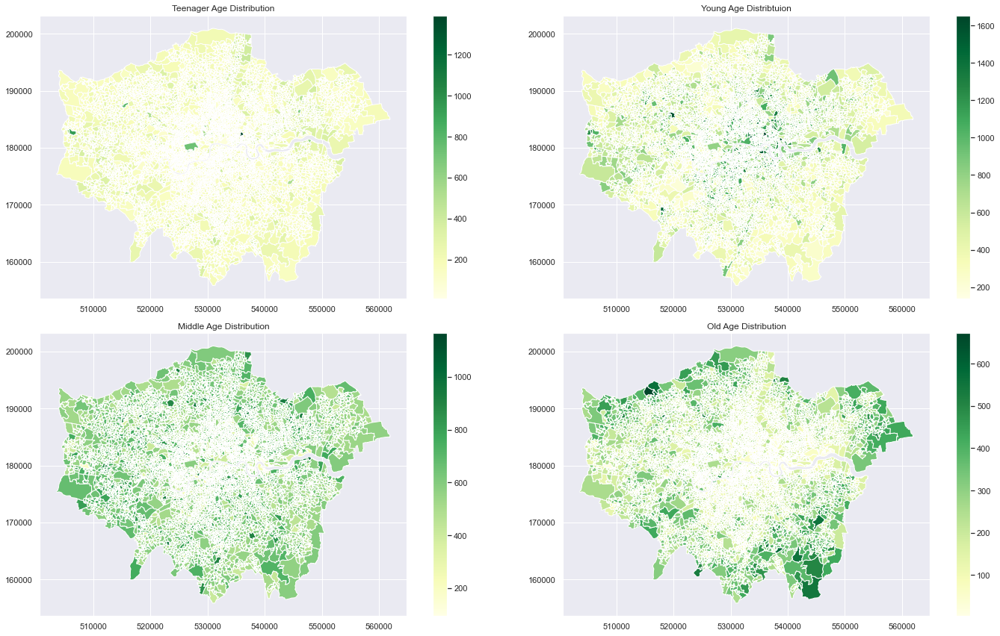

In [1175]:
import matplotlib.pyplot as plt

# Transform london to BNG
age_df.to_crs("EPSG:27700", inplace=True)

# Create a 2x2 subplot layout
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(20, 12))

# Plot the Teenager distribution
attr = "teenager_age"
axs[0, 0].set_title('Teenager Age Distribution')
age_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[0, 0])

# Plot the Young Age distribution
attr = "young_age"
axs[0, 1].set_title('Young Age Distribtuion')
age_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[0, 1])

# Plot the Middle Age distribution
attr = "middle_age"
axs[1, 0].set_title('Middle Age Distribution')
age_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[1, 0])

# Plot the Old Age distribution
attr = "old_age"
axs[1, 1].set_title('Old Age Distribution')
age_df.plot(column=attr, cmap='YlGn', legend=True, ax=axs[1, 1])

# Adjust spacing between subplots
plt.tight_layout()
plt.savefig('Age distribution.pdf')
# Show the subplots
plt.show()


In [232]:
age_df['young_per'] = age_df['young_age']/age_df['all_usual_residents']
age_df['old_per'] = age_df['old_age']/age_df['all_usual_residents']

In [251]:
old_df = age_df.sort_values(by='old_per', ascending=False).head(100)

In [252]:
value_counts = old_df['local_authority_name'].value_counts(ascending=False)
value_counts

Bromley                   22
Havering                  18
Croydon                   11
Barnet                     7
Harrow                     7
Bexley                     6
Sutton                     6
Hillingdon                 4
Enfield                    3
Richmond upon Thames       3
Merton                     3
Camden                     2
Kensington and Chelsea     2
Waltham Forest             2
Redbridge                  2
Hammersmith and Fulham     1
Kingston upon Thames       1
Name: local_authority_name, dtype: int64

#### Visualization Description

1. 年龄的分布中，teenager和middle并没有明显的特征，这两个group在整个伦敦的分布较为均匀。


2. 但是对于young_age（年龄20 - 39): 在临近city of london的人口中具有较多占比，例如在Tower Hamlets, Newham, Lambeth等区域 (这些区域有较多的asian, 以及black）。这个年龄段处于工作年龄，而city of london周围具有大量工作岗位，这是该年龄段在此具有聚集的原因。
                                              
                                                          
3. 而old age则和young_age刚好呈现互补的模式，老年人（年龄>65的人群）更多的选择在伦敦城市郊区生活。特别是东南部，东部，西北部的区域。例如Bromley（东南部）,Havering(东部), Croydon（南部）等区域（Bromley，Havering的地区人口占比中，英国人占比较多），Croydon地区中黑人占比较多。

In [ ]:
# Total Young Adult
age_group_df['young_age'] = age_group_df['aged_20_to_24'] + age_group_df['aged_25_to_29'] +  age_group_df['aged_30_to_34'] + age_group_df['aged_35_to_39']

# Total Middle Age
age_group_df['middle_age'] = age_group_df['aged_40_to_44'] + age_group_df['aged_45_to_49'] + age_group_df['aged_50_to_54'] + age_group_df['aged_55_to_59'] + age_group_df['aged_60_to_64']

# Total Old
age_group_df['old_age'] = age_group_df['aged_65_to_69'] + age_group_df['aged_70_to_74'] + age_group_df['aged_75_to_79'] + age_group_df['aged_80_to_84'] + age_group_df['aged_85_and_over']

人口的分布显示出显著的隔离状况；

方法：1.将某族裔按人口占该区域比例，从上到下对区域进行排序；2.获取排名前100中，出现次数最多的区域；3.对这些区域进行社区数据收集


对于白人：

1. 白人族裔在整个伦敦都分布很广，是研究划分的三个族裔中最多的。其中Richmond upon Thames, Bromley, Bexley, Havering的白人居住率非常高。对于这些社区，https://www.uklocalarea.com/ 网站数据表明。例如Richmond upon Thames中，整个社区环境（包括Income Deprivation, Employment Health, Education, Barriers to Services, Living Envirnment, Crime）优于74.46英格兰的其他区域,其中'St Margarets and North Twichenham'优于85.86%的区域；而Bromley整体社区环境优于61的其他区域。虽然这些区域总体上拥有较优的社区，但是每个区域内也有区别。例如对于Bromley来说，Cray Valley East，Cray Valley West，Petts Wood and Knoll，Shortlands都是属于该区域的LSOA。但是前两者的社区环境比其他69%的区域差，而后两者分别优于91%，87%的区域。

2. 其中British在Havering，Bromley，Bexley区域具有最多人口占比，而irish则在Brent，Ealing, Islington有较多人口。white_gypsy/irish_traveller在Bexley和Bromley出现集中。而Roma则没有显著片区聚集


对于亚洲人：

1. 亚洲人分布相对白人较为集中，集中分布在Great London Authority(GLA)的西部和东北部，其中Redbridge, Newham, Ealing, Hounslow, Tower Hamlets, Brent区域出现较密集的聚集。这些区域中亚洲人聚集最密集的Redbridge比47%的其他区域更优。因为asian的分类包含了chinese, indian, bangladeshi, pakistani。其中这其中分布也存在明显隔离情况。

其中chinese主要分布在中部和东部，Tower Hamlets（社区环境一般，但是教育可达性高于平均水准），Southwark（社区环境中等，但教育水平表现突出），Camden（交通便利，教育水平同样突出）

Indian主要分布在伦敦西部：Hounslow, Ealing, Brent；在距离city of london比较远的地方。

bangladeshi在Tower Hamlets处出现聚集，此区域为英国最大的穆斯林社区，超过30%人口为孟加拉裔

pakistani主要分布在：东北部例如Redbridge, Newham


对于黑人：
1. 黑人在伦敦的北部，南部以及东部分布较为明显。例如Southwark, Lewisham, Greenwich, Lambeth等地区。

其中black_african在greenwich, southwark, bexley的分布较为明显

而black_caribbean在croydon, lewisham, lambeth等地具有较多的人口占比。

### Income Group

#### Visualization

In [1116]:
#计算income的中位数
replacement_val = income_df.house_pri.median()

# 合并两个DataFrame，并标记来自不同DataFrame的数据行
merged = pd.merge(ethnic_df, income_df, on='lsoa_code', how='left')

In [1117]:
# # 筛选出在df1中存在但在df2中不存在的数据行
merged['house_pri'].fillna(replacement_val, inplace=True)

# #Transform the dataframe into a geometry dataframe
income_df = GeoDataFrame(merged)

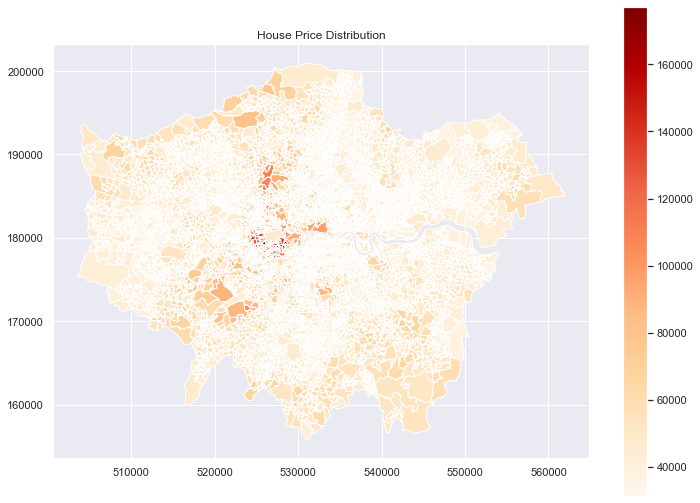

In [1174]:
#transform london to BNG
income_df.to_crs("EPSG:27700", inplace = True)
#ethnic_df1.to_crs("EPSG:27700", inplace = True)

# good health distribution
attr = "house_pri"
ax = income_df.plot(column=attr, cmap='OrRd', legend=True, figsize=(12,9))
ax.set_title('House Price Distribution')
plt.savefig('housepri.pdf')
plt.show()


#### Visualization Description

In [256]:
house_df = income_df.sort_values(by='house_pri', ascending=True).head(100)

In [257]:
value_counts = house_df['local_authority_name'].value_counts(ascending=False)
value_counts

Enfield                 19
Brent                   17
Newham                  11
Croydon                 10
Haringey                10
Ealing                   9
Havering                 3
Bexley                   3
Hackney                  3
Barking and Dagenham     3
Waltham Forest           3
Sutton                   2
Hounslow                 2
Lewisham                 2
Redbridge                2
Bromley                  1
Name: local_authority_name, dtype: int64

而对于House Price，Kensington and Chelsea, Westminster, Camden具有相对最高的房价。Enfiled, Brent, Newham, Croydon具有相对最低的房价，最低房价的住宅区在族裔分布上主要是少数族裔。伦敦东南部和西北部边界地区的房价高于平均水平，这和老年人占比较高的地区分布有重合。

1.把映射图像写成Function

    1.1 先将文件中每个可视化片段用函数替代
    1.2 加入写入csv文件
    1.3 在可视化.ipynb文件中调用写出的csv文件

2.把od_matrix的数据跑出来作为csv文件，在可视化文件中可以调用

3.通过lsoa对应的经纬度找到离每个地铁站最近的lsoa点，将所有demographic数据赋值给这个数据条，作为训练数据

4.LSOA缺失的问题怎么修复

# FSIP & Demographic Visualization

## Read 'od_matrix' file

In [1073]:
od_matrix = pd.read_excel('./data/od_matrix/od_matrix.xlsx',sheet_name='od_matrix',engine="openpyxl")
# 删除第一列
od_matrix = od_matrix.drop(columns=od_matrix.columns[0])

## Define the visualization function

In [286]:
def odmatrix_vis(od_df, col_name, lines, alphas):
    for i in range(0,len(od_df)):
        x1 = [od_df['orig_x'][i],  od_df['dest_x'][i]]
        y1 = [od_df['orig_y'][i],  od_df['dest_y'][i]]
        tmp_fsip = od_df[col_name][i]
        # 绘制线条并设置宽度
        quan_25 = od_df[col_name].quantile(0.2)
        quan_50 = od_df[col_name].quantile(0.5)
        quan_75 = od_df[col_name].quantile(0.8)
        quan_100 = max(od_df[col_name])


        #print(fsip_ampeak_workandedu, max(od_matrix_cleaned["place_based_fsip(other)"]))
        if(quan_75 < tmp_fsip <= quan_100):
            plt.plot(x1, y1, linewidth=tmp_fsip / max(od_df[col_name])*lines[0], color='Blue',alpha=alphas[0])

        elif(quan_50 < tmp_fsip <= quan_75):
            plt.plot(x1, y1, linewidth=(tmp_fsip / max(od_df[col_name]))*lines[1], color="Green",alpha=alphas[1])

        elif(quan_25 < tmp_fsip <= quan_50):
            plt.plot(x1, y1, linewidth=(tmp_fsip / max(od_df[col_name]))*lines[2], color="Red",alpha=alphas[2])

        elif(tmp_fsip <= quan_25):
            plt.plot(x1, y1, linewidth=(tmp_fsip / max(od_df[col_name]))*lines[3], color="magenta",alpha=alphas[3])

In [287]:
def plot_fsip(df_fsip, df_demo, col_fsip, col_demo,tittle,lines, alphas):
    ax = df_demo.plot(column=col_demo, cmap='OrRd', legend=True, figsize=(12,9))
    ax.set_title(tittle)
    
    odmatrix_vis(df_fsip,col_fsip, lines, alphas)
    
    plt.show()

## Stations Exclusion

筛选出离National Rail距离较近的地铁站，因为这类地铁站的通勤乘客很多来自于火车站，而非住在地铁站附近。因此人口统计可视化并不能与当地居民真实情况相对应，因此删除此类地铁站。

1. 筛选掉 还没开门的/已经关闭了的 的地铁站

2. 获取所有包含火车站的 且 火车站已经开始运行的 且 火车站没有关闭运行的 对应地铁站的坐标

3. 火车站包括：“National Rail”和 "Tramlink"

4. coordinates中第一个值为longitude（经度），第二个值为latitude（纬度）

5. 将这些数据的coordinates转换为National British Grid下的坐标

5. 标记任何离这些火车站一定距离内的地铁站

6. 删除包含这些地铁站的flow

In [43]:
# 读取JSON文件中的JSON数组
with open('./data/tfl_stations.json', 'r') as file:
    stations = json.load(file)

# 读取JSON文件中的JSON数组
with open('./data/tfl_lines.json', 'r') as file:
    lines = json.load(file)

In [44]:
# index1: 多少行数据
# index2: 行数据中的第几个
def add_data(index1, index2,df):
    tmp_data={}
    if(stations['features'][index1]['properties']['lines'][index2]['name'] == 'National Rail' or stations['features'][index1]['properties']['lines'][index2]['name'] == 'Tramlink' ):
        tmp_data = {'stations':stations['features'][index1]['properties']['name'] ,
                    'coordinates':stations['features'][index1]['geometry']['coordinates'] ,
                    'lines':stations['features'][index1]['properties']['lines'][index2]['name']}
        df = df.append(tmp_data,ignore_index=True)
    return df

In [45]:
#定义excluded_sta

columns = ['stations','coordinates','lines']
excluded_sta = pd.DataFrame(columns=columns)

# 筛选出tfl_stations中包含 'Tramlink' 和 'National Rail'的地铁站 （其中有重复数据）
for i in range(0,len(stations['features'])):
    if(len(stations['features'][i]['properties']['lines']) == 1):
        excluded_sta = add_data(i,0,excluded_sta)                  
    elif(len(stations['features'][i]['properties']['lines']) == 2):
        excluded_sta = add_data(i,0,excluded_sta)
        excluded_sta = add_data(i,1,excluded_sta) 
    elif(len(stations['features'][i]['properties']['lines']) == 3):
        excluded_sta = add_data(i,0,excluded_sta)
        excluded_sta = add_data(i,1,excluded_sta) 
        excluded_sta = add_data(i,2,excluded_sta)
    elif(len(stations['features'][i]['properties']['lines']) == 4):
        excluded_sta = add_data(i,0,excluded_sta)
        excluded_sta = add_data(i,1,excluded_sta) 
        excluded_sta = add_data(i,2,excluded_sta)
        excluded_sta = add_data(i,3,excluded_sta) 
    elif(len(stations['features'][i]['properties']['lines']) == 5):
        excluded_sta = add_data(i,0,excluded_sta)
        excluded_sta = add_data(i,1,excluded_sta) 
        excluded_sta = add_data(i,2,excluded_sta)
        excluded_sta = add_data(i,3,excluded_sta) 
        excluded_sta = add_data(i,4,excluded_sta)
    elif(len(stations['features'][i]['properties']['lines']) == 6):
        excluded_sta = add_data(i,0,excluded_sta)
        excluded_sta = add_data(i,1,excluded_sta) 
        excluded_sta = add_data(i,2,excluded_sta)
        excluded_sta = add_data(i,3,excluded_sta) 
        excluded_sta = add_data(i,4,excluded_sta)
        excluded_sta = add_data(i,5,excluded_sta)
    elif(len(stations['features'][i]['properties']['lines']) == 7):
        excluded_sta = add_data(i,0,excluded_sta)
        excluded_sta = add_data(i,1,excluded_sta) 
        excluded_sta = add_data(i,2,excluded_sta)
        excluded_sta = add_data(i,3,excluded_sta) 
        excluded_sta = add_data(i,4,excluded_sta)
        excluded_sta = add_data(i,6,excluded_sta)

In [994]:
# 根据'stations'列进行筛选，找出独特的数据行
excluded_sta = excluded_sta.drop_duplicates(subset=['stations'])
excluded_sta.reset_index(drop=True, inplace=True)

In [995]:
excluded_sta

,stations,coordinates,lines,coordinates_x,coordinates_y,geometry
0,Blackfriars,"[-0.103139988780659, 51.51177409676423]",National Rail,531727.424144,180910.571417,POINT (531727.424 180910.571)
1,Elephant & Castle,"[-0.100544988787323, 51.49538329675418]",National Rail,531954.789432,179092.536181,POINT (531954.789 179092.536)
2,Finsbury Park,"[-0.1063375688362, 51.56463857774401]",National Rail,531353.378259,186783.547920,POINT (531353.378 186783.548)
3,Greenford,"[-0.344816288858051, 51.54218769678803]",National Rail,514881.148818,183885.817658,POINT (514881.149 183885.818)
4,Harrow & Wealdstone,"[-0.335398788831483, 51.59232129681883]",National Rail,515407.300643,189475.854557,POINT (515407.301 189475.855)
...,...,...,...,...,...,...
136,West Croydon,"[-0.1023, 51.3784239]",National Rail,532169.875931,166083.274734,POINT (532169.876 166083.275)
137,West Drayton,"[-0.471897288922074, 51.5098128967703]",National Rail,506143.942598,180093.761381,POINT (506143.943 180093.761)
138,West Ealing,"[-0.320472588861861, 51.51351309676991]",National Rail,516642.430420,180735.491713,POINT (516642.430 180735.492)
139,Wandsworth Road,"[-0.138179469161229, 51.46968303029571]",National Rail,529415.128556,176167.470693,POINT (529415.129 176167.471)


**坐标转换**

In [996]:
# Transform Coordinates from WGB84 to National Britsh Grid

# Define the CRS84 (latitude, longitude) and BNG (British National Grid) coordinate reference systems
crs84 = pyproj.CRS("EPSG:4326")  # EPSG code for CRS84 (WGS 84)
bng = pyproj.CRS("EPSG:27700")   # EPSG code for British National Grid

# Create a coordinate transformer
transformer = pyproj.Transformer.from_crs(crs84, bng, always_xy=True)

coord_x = []
coord_y = []

# Transform the coordinates and update the JSON
for i in range (0,len(excluded_sta)):
    lon, lat = excluded_sta['coordinates'][i][0], excluded_sta['coordinates'][i][1]
    x, y = transformer.transform(lon, lat)
    coord_x.append(x)
    coord_y.append(y)
    
    
excluded_sta["coordinates_x"] = coord_x
excluded_sta["coordinates_y"] = coord_y

**删除掉不在伦敦地图范围内的数据**

/Users/apple/opt/anaconda3/lib/python3.9/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


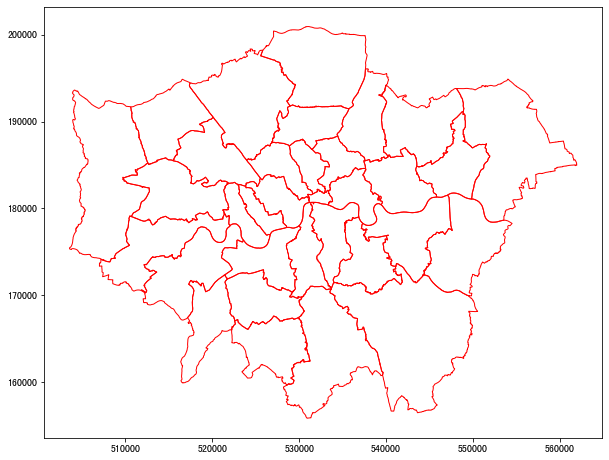

In [997]:
# Read London Data
file = "./data/LAD_Dec_2015_Generalised_Clipped_Boundaries_GB.geojson"
EW = gpd.read_file(file)

London = EW[EW.lad15cd.str.contains("E09")]

#transform london to BNG
London.to_crs("EPSG:27700", inplace = True)
#We can check that this has occured by plotting the results
London.plot(figsize = (10,15), facecolor = "None", edgecolor = "r")
plt.show()

In [50]:
# 定义地图范围的边界框，假设为[minx, miny, maxx, maxy]
minx, miny, maxx, maxy = London.total_bounds
excluded_sta = excluded_sta[(excluded_sta['coordinates_x'] >= minx) & (excluded_sta['coordinates_x'] <= maxx)]
excluded_sta = excluded_sta[(excluded_sta['coordinates_y'] >= miny) & (excluded_sta['coordinates_y'] <= maxy)]
excluded_sta

,stations,coordinates,lines,coordinates_x,coordinates_y
0,Blackfriars,"[-0.103139988780659, 51.51177409676423]",National Rail,531727.424144,180910.571417
1,Elephant & Castle,"[-0.100544988787323, 51.49538329675418]",National Rail,531954.789432,179092.536181
2,Finsbury Park,"[-0.1063375688362, 51.56463857774401]",National Rail,531353.378259,186783.547920
3,Greenford,"[-0.344816288858051, 51.54218769678803]",National Rail,514881.148818,183885.817658
4,Harrow & Wealdstone,"[-0.335398788831483, 51.59232129681883]",National Rail,515407.300643,189475.854557
...,...,...,...,...,...
145,West Croydon,"[-0.1023, 51.3784239]",National Rail,532169.875931,166083.274734
146,West Drayton,"[-0.471897288922074, 51.5098128967703]",National Rail,506143.942598,180093.761381
147,West Ealing,"[-0.320472588861861, 51.51351309676991]",National Rail,516642.430420,180735.491713
148,Wandsworth Road,"[-0.138179469161229, 51.46968303029571]",National Rail,529415.128556,176167.470693


这个DataFrame包含了火车站

/Users/apple/opt/anaconda3/lib/python3.9/site-packages/geopandas/base.py:31: UserWarning: The indices of the two GeoSeries are different.
  warn("The indices of the two GeoSeries are different.")
/Users/apple/opt/anaconda3/lib/python3.9/site-packages/geopandas/geodataframe.py:1415: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super().__getitem__(key)


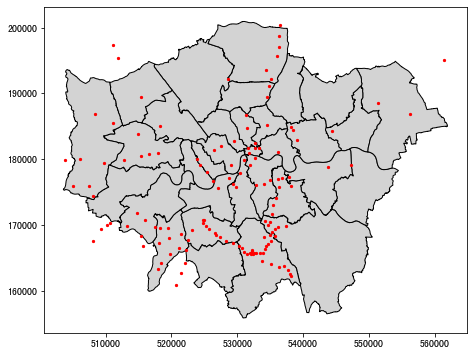

In [51]:
# 假设DataFrame中的坐标列分别为'x'和'y'
geometry = gpd.points_from_xy(excluded_sta['coordinates_x'], excluded_sta['coordinates_y'])
gdf = gpd.GeoDataFrame(excluded_sta, geometry=geometry)
# 设置gdf的坐标系统为当前的WGS84 (EPSG:4326)
gdf.set_crs(epsg=27700, inplace=True)

# 转换gdf的坐标系统为National British Grid (EPSG:27700)
#invalid_geometries = gdf[gdf.geometry.is_valid == False]
#gdf = gdf.to_crs(epsg=27700)
gdf

# 删除不在地图范围内的数据，并重置索引
gdf_within_bounds = gdf[gdf['geometry'].within(London)].reset_index(drop=True)
gdf_within_bounds

# 假设DataFrame中的坐标列分别为'x'和'y'
#geometry = gpd.points_from_xy(excluded_sta["coordinates_x"], excluded_sta["coordinates_y"])
#gdf_within_bounds.plot(ax=ax, marker='o', color='red', markersize=5)
ax = London.plot(color='lightgrey', edgecolor='black', figsize=(10, 6))
gdf.plot(ax=ax, marker='o', color='red', markersize=5)
#London.plot(figsize = (10,15), facecolor = "None", edgecolor = "r")
plt.show()

In [52]:
od_matrix

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
0,500,Acton Town,505,Alperton,0,50,0,99,0,0,...,0.339512,15.666253,6.674350,2.347233,1.367824,0.410014,3.336039,7.385811,3.273341,2.256353
1,500,Acton Town,507,Angel,1,10,2,0,3,0,...,0.309987,15.666253,32.012554,0.489378,1.367824,2.762027,0.495225,7.385811,17.585092,0.420004
2,500,Acton Town,508,Archway,0,0,0,0,0,2,...,NaN,15.666253,15.345480,1.020903,1.367824,1.333474,1.025760,7.385811,8.875331,0.832173
3,500,Acton Town,510,Arsenal,0,0,13,15,0,0,...,NaN,15.666253,2.839828,5.516621,1.367824,0.232093,5.893437,7.385811,2.084092,3.543899
4,500,Acton Town,511,Baker Street,0,17,0,0,0,0,...,0.298023,15.666253,37.124183,0.421996,1.367824,3.358702,0.407248,7.385811,21.162684,0.349002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30229,789,North Greenwich,767,Wimbledon,0,0,0,29,0,0,...,NaN,30.837140,12.325134,2.501972,2.570090,0.913843,2.812398,14.322496,5.915057,2.421362
30230,789,North Greenwich,770,Wood Green,12,10,0,0,0,0,...,0.319766,30.837140,14.776118,2.086958,2.570090,1.232144,2.085868,14.322496,7.427092,1.928412
30231,789,North Greenwich,599,Wood Lane,0,8,0,0,0,0,...,0.295927,30.837140,4.419083,6.978177,2.570090,0.409171,6.281216,14.322496,2.541702,5.635003
30232,789,North Greenwich,769,Woodford,0,0,0,10,17,0,...,NaN,30.837140,3.724753,8.278976,2.570090,0.294261,8.734061,14.322496,1.934033,7.405507


**判断哪些od_matrix中哪些地铁站是需要删除的**

1. 首先将statio_origin以及其对应的坐标保存为一个单独的dataframe

2. 将step1中得到dataframe与excluded_sta一一进行比较计算，当两个站之间的distance小于1km时，删除掉这些

In [1074]:
#  step1
df = od_matrix[['station_origin','orig_x','orig_y']]
df.drop_duplicates(subset=['station_origin'], keep='first', inplace=True)
df.reset_index(drop=True, inplace=True)
excluded_sta.reset_index(drop=True, inplace=True)

/var/folders/21/l9ygcw6d6w39m02vcn2t_j6r0000gn/T/ipykernel_72051/1230323999.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop_duplicates(subset=['station_origin'], keep='first', inplace=True)


In [1075]:
from numpy import sqrt 

# 筛选出需要删除的地铁站
selected_sta = pd.DataFrame(columns = df.columns)
tmp = 0
for i in range(0,len(df)):
    for j in range(0, len(excluded_sta)):
        tmp_dis = sqrt((df['orig_x'][i] - excluded_sta['coordinates_x'][j])**2 + (df['orig_y'][i] - excluded_sta['coordinates_y'][j])**2)
        if(tmp_dis < 1000):
            new_row = {'station_origin':df['station_origin'][i],'orig_x':df['orig_x'][i] ,'orig_y':df['orig_y'][i]}
            selected_sta = selected_sta.append(new_row, ignore_index=True)

In [1076]:
# 删除od_matrix中的对应数据

values_to_exclude = selected_sta['station_origin'].tolist()
mask1 = od_matrix['station_origin'].isin(values_to_exclude)
mask2 = od_matrix['station_destination'].isin(values_to_exclude)

combined_mask = mask1 | mask2

od_matrix_new = od_matrix[~combined_mask]
od_matrix_new.reset_index(drop=True, inplace=True)

In [1077]:
od_matrix_new

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,place_based_fsip(other),relative_outflow(workandedu),relative_inflow(workandedu),place_based_fsip(workandedu),relative_outflow(eduandother),relative_inflow(eduandother),place_based_fsip(eduandother),relative_outflow(workandother),relative_inflow(workandother),place_based_fsip(workandother)
0,500,Acton Town,505,Alperton,0,50,0,99,0,0,...,2.257304,9.342471,3.411165,2.738792,6.326567,2.304111,2.745773,21.455004,9.416650,2.278412
1,500,Acton Town,507,Angel,1,10,2,0,3,0,...,0.416760,9.342471,18.791078,0.497176,6.326567,13.815537,0.457931,21.455004,46.859360,0.457860
2,500,Acton Town,508,Archway,0,0,0,0,0,2,...,0.000000,9.342471,9.081543,0.000000,6.326567,6.854904,0.000000,21.455004,23.075369,0.929779
3,500,Acton Town,519,Belsize Park,0,0,0,0,0,0,...,0.000000,9.342471,7.773844,0.000000,6.326567,5.783447,0.000000,21.455004,19.881741,1.079131
4,500,Acton Town,787,Bermondsey,0,0,0,3,0,0,...,0.000000,9.342471,6.018939,0.000000,6.326567,4.331522,0.000000,21.455004,14.764110,1.453186
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10693,789,North Greenwich,763,Whitechapel,1,21,64,0,0,45,...,1.112500,18.044475,13.728760,1.314356,12.069006,10.046574,1.201306,42.175344,34.534734,1.221244
10694,789,North Greenwich,765,Willesden Green,0,5,45,3,63,41,...,3.518198,18.044475,4.601919,3.921076,12.069006,3.194973,3.777499,42.175344,11.535384,3.656172
10695,789,North Greenwich,770,Wood Green,12,10,0,0,0,0,...,1.918865,18.044475,8.592153,2.100111,12.069006,6.051372,1.994425,42.175344,21.014292,2.006984
10696,789,North Greenwich,769,Woodford,0,0,0,10,17,0,...,0.000000,18.044475,2.122389,0.000000,12.069006,1.515943,0.000000,42.175344,5.446979,7.742887


----

## Visualize each FSIP

有三个不同的groups，

**1. "To Work",**


**2. "To Education",**


**3. "To Other"**

在可视化中，一共三个不同的指数：**Absolute, Relative, Place-Based**

每个指数下有都有三个group的六种不同组合: **work, education, other, work&education, work&other, education&other**

We adopted three different travel purpose in this study: G1: People travel to work, G2: People travel to education, G3: People travel to other(tourist, hotel, shop, and other purposes). The distance decay parameter \beta is set as -0.91 after calibrated based on doubly constrained model. The amount of people traveling between places is employed as the basic attractiveness of each flow.

In [ ]:
# 需要解决的问题：
# 1. LSOA不全
# 2. 怎么可视化所有的demographic
# 3. 

In [101]:
od_matrix_new


test_od = od_matrix_new.sample(3000,random_state=42)

In [102]:
test_od.reset_index(drop=True, inplace=True)

### Absolute Measures

#### Flows Description

通过Absolute Measures计算的flows的总体分布不是很显著，

In [280]:
od_matrix_new

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
0,500,Acton Town,505,Alperton,0,50,0,99,0,0,...,0.339217,15.802151,6.733013,2.346966,1.376677,0.406434,3.387208,7.283573,3.226669,2.257304
1,500,Acton Town,507,Angel,1,10,2,0,3,0,...,0.309075,15.802151,32.207660,0.490633,1.376677,2.767077,0.497520,7.283573,17.476667,0.416760
2,500,Acton Town,508,Archway,0,0,0,0,0,2,...,NaN,15.802151,15.430389,1.024093,1.376677,1.337502,1.029289,7.283573,8.830943,0.824779
3,500,Acton Town,519,Belsize Park,0,0,0,0,0,0,...,NaN,15.802151,13.326492,1.185770,1.376677,1.123906,1.224904,7.283573,7.494710,0.971829
4,500,Acton Town,787,Bermondsey,0,0,0,3,0,0,...,NaN,15.802151,10.235291,1.543889,1.376677,0.883155,1.558818,7.283573,5.361708,1.358443
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10693,789,North Greenwich,763,Whitechapel,1,21,64,0,0,45,...,0.315006,31.067612,23.783936,1.306243,2.575045,1.995146,1.290655,14.137112,12.707513,1.112500
10694,789,North Greenwich,765,Willesden Green,0,5,45,3,63,41,...,0.235914,31.067612,8.210991,3.783662,2.575045,0.636486,4.045720,14.137112,4.018282,3.518198
10695,789,North Greenwich,770,Wood Green,12,10,0,0,0,0,...,0.318710,31.067612,14.861683,2.090450,2.575045,1.236673,2.082235,14.137112,7.367435,1.918865
10696,789,North Greenwich,769,Woodford,0,0,0,10,17,0,...,NaN,31.067612,3.736692,8.314201,2.575045,0.295151,8.724498,14.137112,1.924895,7.344354


In [281]:
od_matrix_new1 = od_matrix_new.sort_values(by='fsip_2work', ascending=True).head(100)
od_matrix_new1

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
10697,789,North Greenwich,771,Woodside Park,0,0,0,0,0,4,...,NaN,31.067612,4.741002,6.552963,2.575045,0.334131,7.706685,14.137112,2.158937,6.548183
9209,708,South Kensington,787,Bermondsey,0,0,38,60,59,28,...,NaN,16.446532,10.235291,1.606846,1.642851,0.883155,1.860208,10.392509,5.361708,1.938283
4621,592,Hainault,621,Kew Gardens,14,0,0,0,0,0,...,NaN,12.063468,8.267823,1.459086,0.739914,0.578346,1.279363,5.015144,3.912436,1.281847
9210,708,South Kensington,520,Bethnal Green,0,0,23,37,19,29,...,NaN,16.446532,17.691175,0.929646,1.642851,1.286165,1.277325,10.392509,9.295506,1.118014
9211,708,South Kensington,522,Blackhorse Road,0,0,37,14,47,67,...,NaN,16.446532,6.650662,2.472916,1.642851,0.549951,2.987267,10.392509,3.070050,3.385127
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9239,708,South Kensington,567,East Putney,0,0,24,162,75,29,...,NaN,16.446532,10.043090,1.637597,1.642851,0.764901,2.147795,10.392509,5.235079,1.985168
4551,582,Gants Hill,529,Brent Cross,0,0,0,0,0,5,...,NaN,18.825632,3.446731,5.461880,1.265866,0.304722,4.154172,6.942822,1.795025,3.867812
4548,582,Gants Hill,787,Bermondsey,0,0,20,0,0,0,...,NaN,18.825632,10.235291,1.839287,1.265866,0.883155,1.433346,6.942822,5.361708,1.294890
4488,738,Upney,706,Southgate,0,0,0,8,0,0,...,NaN,10.463319,7.413724,1.411345,0.710749,0.624555,1.138008,4.792231,3.500270,1.369103


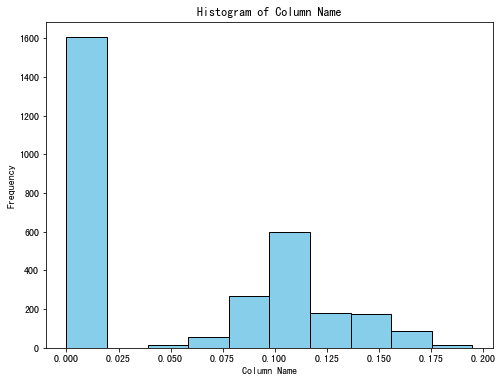

In [273]:
import pandas as pd
import matplotlib.pyplot as plt

# 假设你的DataFrame名为df，列名为'column_name'
# 你可以使用以下代码绘制直方图
plt.figure(figsize=(8, 6))
plt.hist(test_od['fsip_2other(relative)'], bins=10, color='skyblue', edgecolor='black')
plt.xlabel('Column Name')
plt.ylabel('Frequency')
plt.title('Histogram of Column Name')
plt.show()


#### Ethnic -> Asian

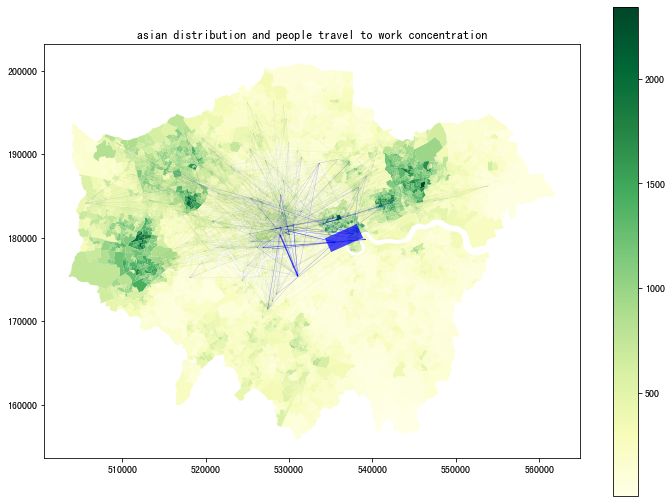

In [276]:
alphas = [0.7, 1.0, 1.0, 1.0]
lines = [15.0, 100.0, 100.0, 100.0]

# To work
plot_fsip(test_od, ethnic_df,'fsip_2work','asian_total','asian distribution and people travel to work concentration',lines,alphas)

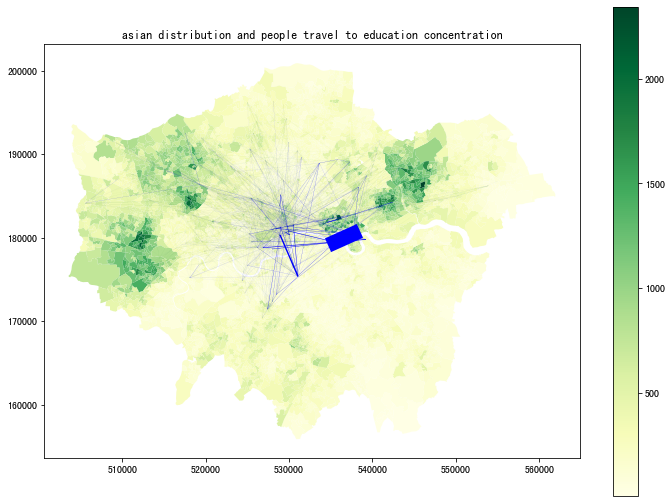

In [277]:
alphas = [1.0, 1.0, 1.0, 1.0]
lines = [15.0, 100.0, 100.0, 100.0]

# To education
plot_fsip(test_od, ethnic_df,'fsip_2edu','asian_total','asian distribution and people travel to education concentration',lines,alphas)

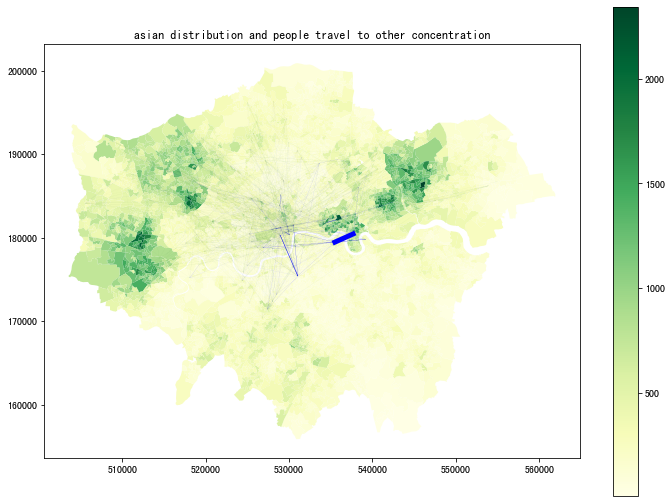

In [261]:
# To other
plot_fsip(test_od, ethnic_df,'fsip_2other','asian_total','asian distribution and people travel to other concentration',lines,alphas)

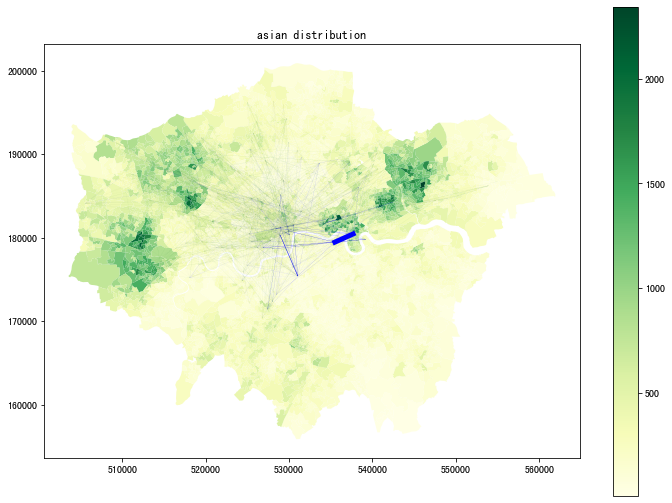

In [113]:
# To workandedu
plot_fsip(test_od, ethnic_df,'fsip_ampeak_workandedu','asian_total','asian distribution',lines,alphas)



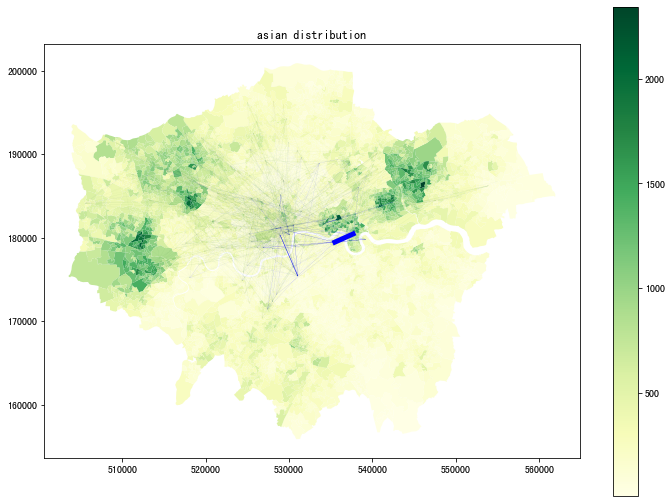

In [114]:
# To workandother
plot_fsip(test_od, ethnic_df,'fsip_ampeak_workandother','asian_total','asian distribution',lines,alphas)



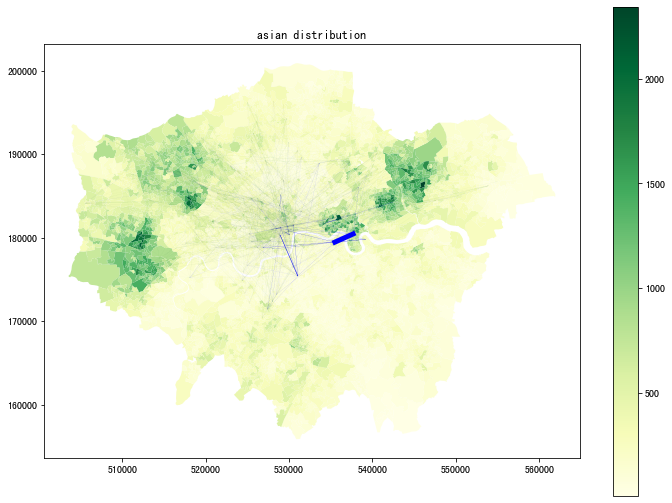

In [115]:
# To eduandother
plot_fsip(test_od, ethnic_df,'fsip_ampeak_eduandother','asian_total','asian distribution',lines,alphas)

#### Age -> Young & Old

##### Young

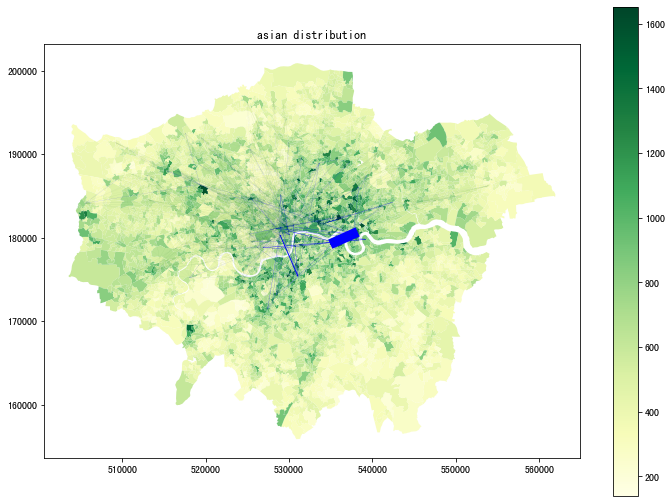

In [121]:
alphas = [1.0, 1.0, 1.0, 1.0]
lines = [10.0, 100.0, 100.0, 100.0]

# To work
plot_fsip(test_od, age_df,'fsip_2work','young_age','asian distribution',lines,alphas)

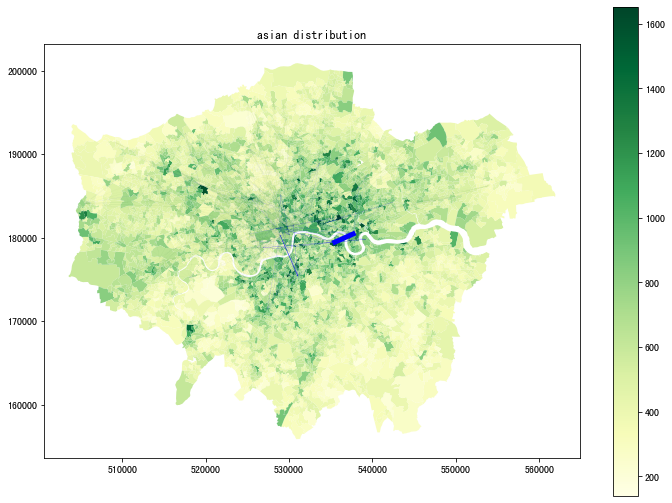

In [122]:
alphas = [1.0, 1.0, 1.0, 1.0]
lines = [5.0, 100.0, 100.0, 100.0]

# To education
plot_fsip(test_od, age_df,'fsip_2edu','young_age','asian distribution',lines,alphas)

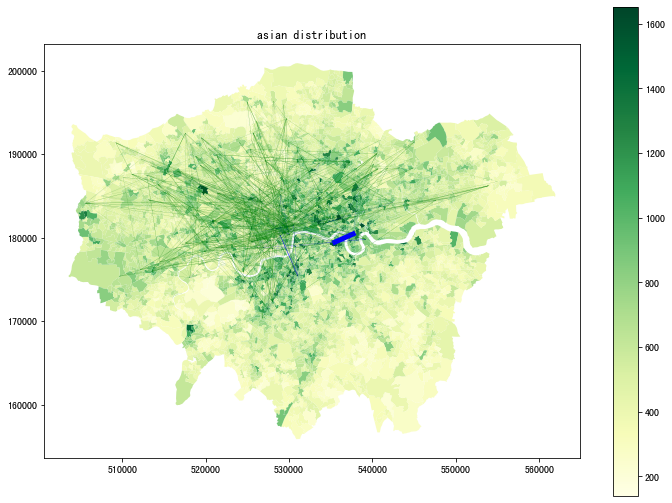

In [123]:
alphas = [1.0, 1.0, 1.0, 1.0]
lines = [5.0, 1000.0, 1000.0, 1000.0]

# To other
plot_fsip(test_od, age_df,'fsip_2other','young_age','asian distribution',lines,alphas)

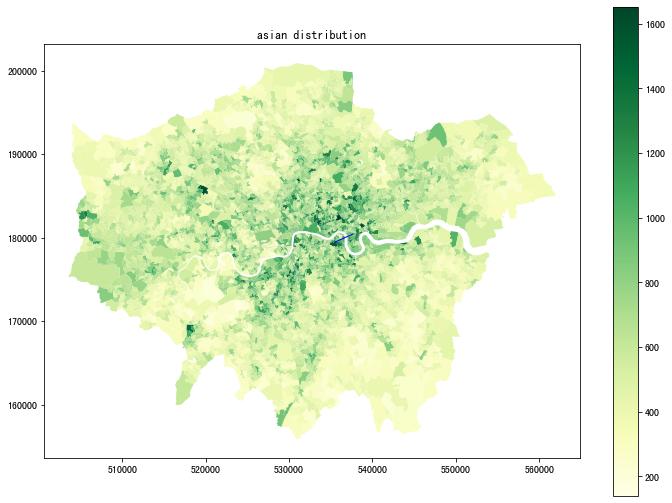

In [124]:
alphas = [1.0, 1.0, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To workandedu
plot_fsip(test_od, age_df,'fsip_ampeak_workandedu','young_age','asian distribution',lines,alphas)

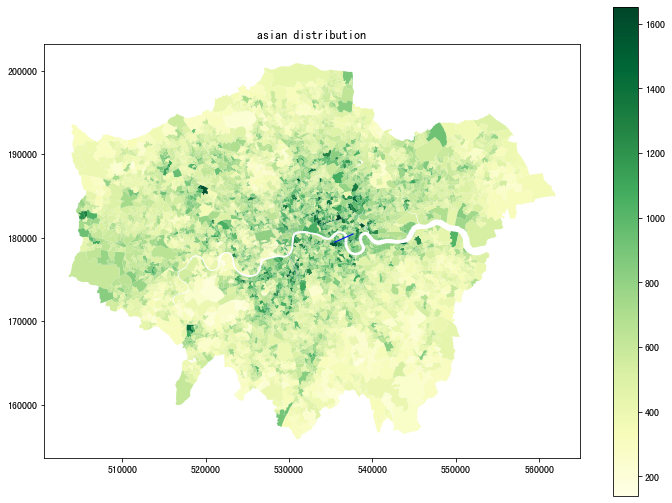

In [125]:
alphas = [1.0, 1.0, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To workandother
plot_fsip(test_od, age_df,'fsip_ampeak_workandother','young_age','asian distribution',lines,alphas)

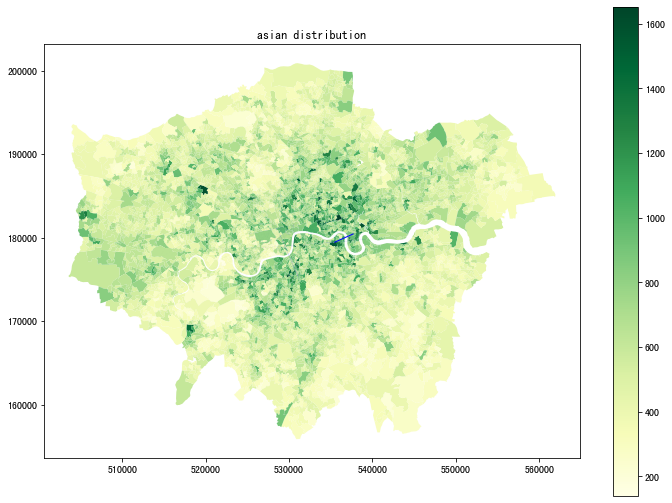

In [126]:
alphas = [1.0, 1.0, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To eduandother
plot_fsip(test_od, age_df,'fsip_ampeak_eduandother','young_age','asian distribution',lines,alphas)

##### Old

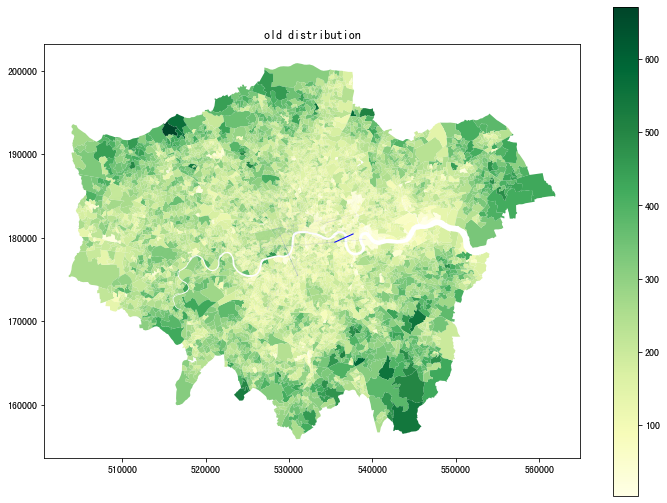

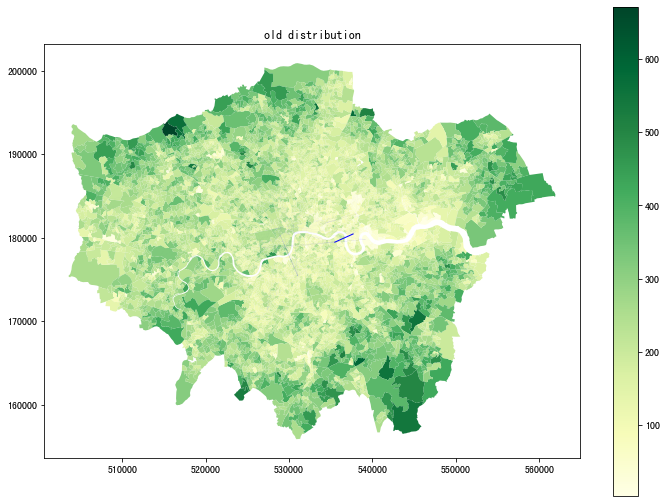

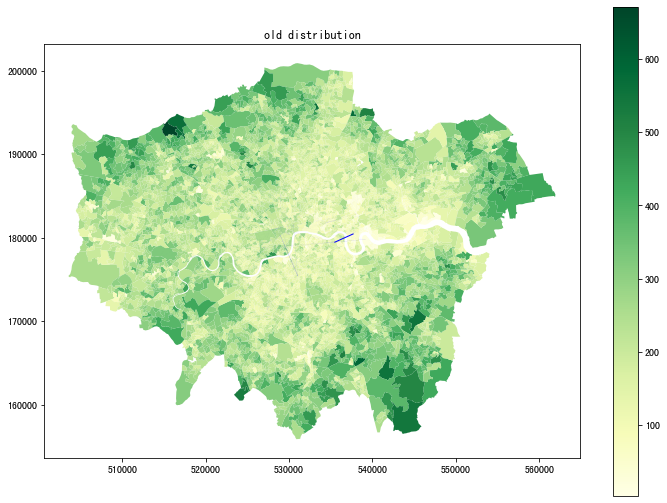

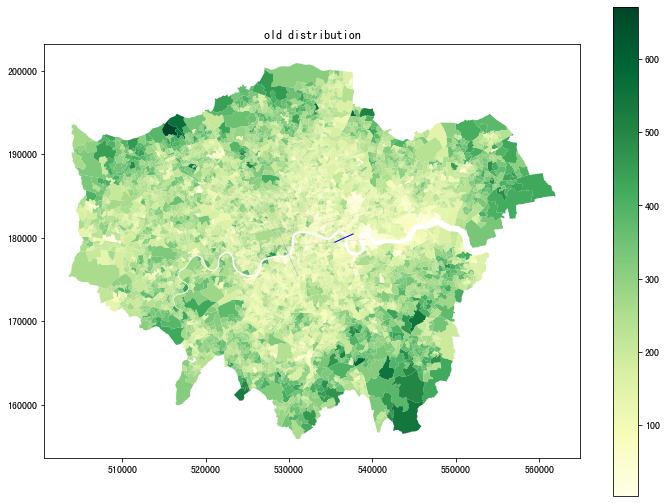

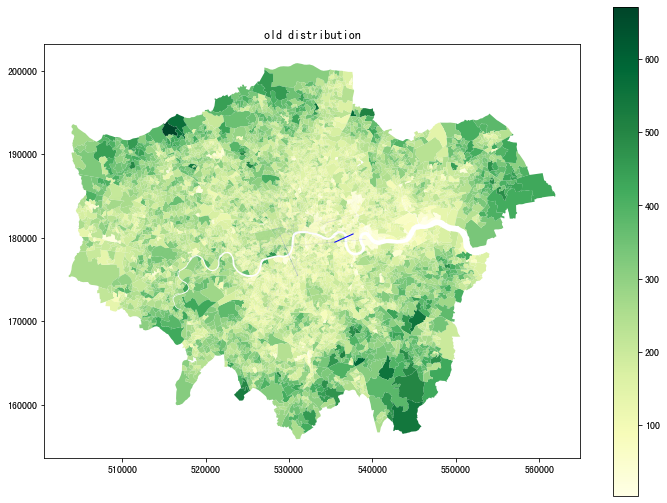

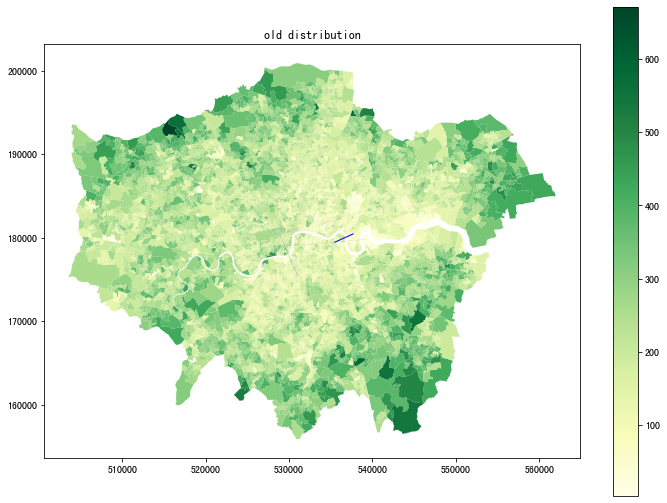

In [127]:
alphas = [1.0, 1.0, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(test_od, age_df,'fsip_2work','old_age','old distribution',lines,alphas)

# To education
plot_fsip(test_od, age_df,'fsip_2edu','old_age','old distribution',lines,alphas)

# To other
plot_fsip(test_od, age_df,'fsip_2other','old_age','old distribution',lines,alphas)

# To workandedu
plot_fsip(test_od, age_df,'fsip_ampeak_workandedu','old_age','old distribution',lines,alphas)

# To workandother
plot_fsip(test_od, age_df,'fsip_ampeak_workandother','old_age','old distribution',lines,alphas)

# To eduandother
plot_fsip(test_od, age_df,'fsip_ampeak_eduandother','old_age','old distribution',lines,alphas)

#### House -> House Price

TypeError: odmatrix_vis() missing 2 required positional arguments: 's' and 'alpha'

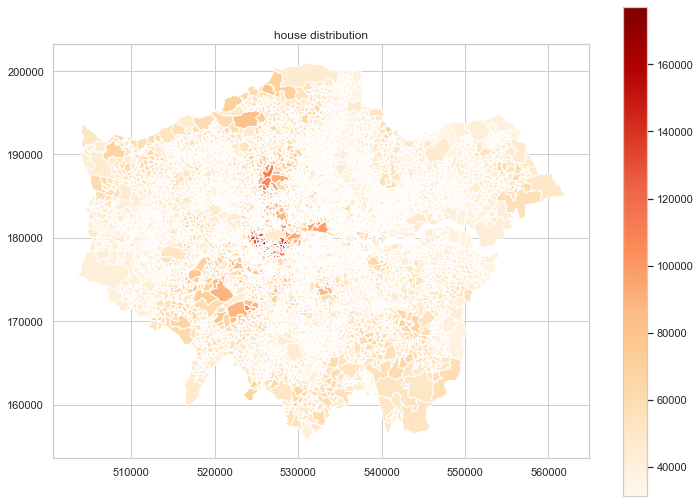

In [1832]:
alphas = [1.0, 1.0, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(test_od, income_df,'fsip_2work','house_pri','house distribution',lines,alphas)

# To education
plot_fsip(test_od, income_df,'fsip_2edu','house_pri','house distribution',lines,alphas)

# To other
plot_fsip(test_od, income_df,'fsip_2other','house_pri','house distribution',lines,alphas)

# To workandedu
plot_fsip(test_od, income_df,'fsip_ampeak_workandedu','house_pri','house distribution',lines,alphas)

# To workandother
plot_fsip(test_od, income_df,'fsip_ampeak_workandother','house_pri','house distribution',lines,alphas)

# To eduandother
plot_fsip(test_od, income_df,'fsip_ampeak_eduandother','house_pri','house distribution',lines,alphas)

----

### Relative Measures

#### Flows Visua

In [356]:
od_matrix_new['fsip_2work(relative)']

0      0.195759
1      0.235852
2      0.000000
3      0.000000
4      0.000000
         ...   
995    0.000000
996    0.000000
997    0.000000
998    0.000000
999    0.248523
Name: fsip_2work(relative), Length: 1000, dtype: float64

Flows Description:

描述纬度：1. 单纯的flow描述（对哪个group: 从哪到哪的线路出现聚集，聚集强度有多高）

线路的关系：
1. Work(Concentration):  在地铁线路中，前去工作的人群之间出现大量高强度的交互。这些这些交互指数都属于大于80%的强交互水准。除此之外，工作人群在Wemister区域附近也出现大量的高强度交互。

2. 中等强度的交互发生的总体分布与高强度交互动的分布类似，但是更多在伦敦的中西部地区，这说明这些区域的上班人群更有可能选择其他交通方式进行通勤

3. 交互潜力指数最高的线路包括：Gants Hill - Holborn, Hainault - Canary Wharf, Woodford - Green Park, Woodford - Oxford Circus, Woodford - Bond Street.这些终点站都是伦敦地铁线路的重要站点，各条地铁线路之间的交互。虽然无法获取上班人群的准确移动轨迹，但是可以推测大部分上班族需要在这些站点进行转站。


和族裔人口统计的关系：
1. 白人族裔在整个伦敦中的占比较多且分布较广，难以直接从流动分布和族裔分布地图上获取直观信息。但是在Rainham, Dagenham, Romford, Upminster这些东部郊区，出现长距离的线路高强度交互以及聚集。且这些区域大多数居住的都是大于工作年纪的老人，且这些区域的房价低于平均市场水平，因此推测该区域居住的工作年龄人群都是在此居住，选择了离工作单位较远但是房价比较便宜的地区进行居住。

2. 对于例如东部地区在亚洲族裔聚集较多的Hounslow, Ealing, Brent等区域，有出现大量流入中心区域的趋势。但是这些交互指数大多属于中等水平。说明早高峰期间，从郊区通勤前往中心并不是很拥挤。其中pakistani分布密集的Redbridge, Newham附近的地铁线路出现高强度互动，但是互动并不密集。这同样说明大部分居住在这两个区域的pakistani是在区域内或附近工作。

3. 对于北部和中西部黑人族裔人口占比较多的区域，在早高峰的流动情况同样体现为向市区流动，说明这些区域的黑人多半是上班族。而对于南部黑人人口占比较多的地区，地铁可达性并不是很高，且位于南部的地铁线路并没有在早高峰时段出现大量的聚集，因此推测南部的黑人族裔通常在居住地区附近工作。

和年龄人口统计的关系：

1. Young
工作年龄人群大多居住在zone1-2。其中位于泰晤士河北面例如工作人群较多聚集的Tower Hamlets, Hackney在早高峰时段出现聚集，但聚集程度和交互强度都弱于位于泰晤士河南面的工作人群聚集地（Southwark, Lambeth）。推测位于Tower Hamlets, Hackney的早高峰通勤工作年龄人群在通勤选择上更多样化

2.Old
老年人人口占比较大的区域通常分布在离地铁线路较远的地区。

In [351]:
od_matrix_new

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
0,500,Acton Town,505,Alperton,0,50,0,99,0,0,...,0.339217,15.802151,6.733013,2.346966,1.376677,0.406434,3.387208,7.283573,3.226669,2.257304
1,500,Acton Town,507,Angel,1,10,2,0,3,0,...,0.309075,15.802151,32.207660,0.490633,1.376677,2.767077,0.497520,7.283573,17.476667,0.416760
2,500,Acton Town,508,Archway,0,0,0,0,0,2,...,NaN,15.802151,15.430389,1.024093,1.376677,1.337502,1.029289,7.283573,8.830943,0.824779
3,500,Acton Town,519,Belsize Park,0,0,0,0,0,0,...,NaN,15.802151,13.326492,1.185770,1.376677,1.123906,1.224904,7.283573,7.494710,0.971829
4,500,Acton Town,787,Bermondsey,0,0,0,3,0,0,...,NaN,15.802151,10.235291,1.543889,1.376677,0.883155,1.558818,7.283573,5.361708,1.358443
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10693,789,North Greenwich,763,Whitechapel,1,21,64,0,0,45,...,0.315006,31.067612,23.783936,1.306243,2.575045,1.995146,1.290655,14.137112,12.707513,1.112500
10694,789,North Greenwich,765,Willesden Green,0,5,45,3,63,41,...,0.235914,31.067612,8.210991,3.783662,2.575045,0.636486,4.045720,14.137112,4.018282,3.518198
10695,789,North Greenwich,770,Wood Green,12,10,0,0,0,0,...,0.318710,31.067612,14.861683,2.090450,2.575045,1.236673,2.082235,14.137112,7.367435,1.918865
10696,789,North Greenwich,769,Woodford,0,0,0,10,17,0,...,NaN,31.067612,3.736692,8.314201,2.575045,0.295151,8.724498,14.137112,1.924895,7.344354


In [633]:
sorted_df = od_matrix_new.sort_values(by='fsip_2work(relative)', ascending=False).head(100)
sorted_df.reset_index(drop=True, inplace=True)
sorted_df.head(30)

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
0,582,Gants Hill,607,Holborn,36,190,7,31,1,0,...,0.321534,18.825632,45.771078,0.411300,1.265866,4.169561,0.303597,6.942822,25.708049,0.270064
1,592,Hainault,852,Canary Wharf,79,260,34,0,0,0,...,0.325535,12.063468,45.798127,0.263405,0.739914,3.987372,0.185564,5.015144,22.521573,0.222682
2,769,Woodford,590,Green Park,23,72,2,10,0,0,...,0.318555,18.156973,43.463635,0.417751,1.320466,4.104732,0.321694,6.841541,25.464410,0.268671
3,769,Woodford,669,Oxford Circus,18,148,35,6,20,3,...,0.317577,18.156973,46.786058,0.388085,1.320466,4.419400,0.298789,6.841541,27.333197,0.250302
4,769,Woodford,524,Bond Street,61,133,49,30,0,13,...,0.315697,18.156973,38.975502,0.465856,1.320466,3.519879,0.375145,6.841541,22.349188,0.306120
5,537,Canons Park,669,Oxford Circus,22,118,0,25,0,0,...,0.318793,12.687439,46.786058,0.271180,0.939559,4.419400,0.212599,4.815996,27.333197,0.176196
6,742,Walthamstow Central,727,Tooting Broadway,60,129,74,0,31,0,...,0.321580,26.566361,17.399059,1.526885,2.343641,1.343347,1.744628,10.556554,7.964740,1.325411
7,592,Hainault,763,Whitechapel,34,111,0,0,0,0,...,0.320810,12.063468,23.783936,0.507211,0.739914,1.995146,0.370857,5.015144,12.707513,0.394660
8,582,Gants Hill,674,Piccadilly Circus,27,115,24,0,0,0,...,0.319631,18.825632,41.975525,0.448491,1.265866,3.695687,0.342525,6.942822,23.878899,0.290751
9,592,Hainault,602,High Barnet,24,48,0,0,0,0,...,0.338425,12.063468,6.693992,1.802134,0.739914,0.518916,1.425884,5.015144,3.036165,1.651802


#### To work

##### Ethnic(White)

In [342]:
od_matrix_new.columns

Index(['From', 'station_origin', 'To', 'station_destination', 'early_flows',
       'ampeak_flows', 'midday_flows', 'pmpeak_flows', 'evening_flows',
       'late_flows', 'total_flows', 'orig_x', 'orig_y', 'dest_x', 'dest_y',
       'orig_coord_lat', 'orig_coord_lon', 'dest_coord_lat', 'dest_coord_lon',
       'fsip', 'fsip_ampeak', 'station_dis', 'ampeak_2work_flows',
       'ampeak_2edu_flows', 'ampeak_2other_flows', 'fsip_2work', 'fsip_2edu',
       'fsip_2other', 'fsip_ampeak_workandedu', 'fsip_ampeak_workandother',
       'fsip_ampeak_eduandother', 'fsip_2work(relative)',
       'fsip_2edu(relative)', 'fsip_2other(relative)',
       'fsip_ampeak_workandedu(relative)', 'fsip_ampeak_eduandother(relative)',
       'fsip_ampeak_workandother(relative)', 'relative_outflow(work)',
       'relative_inflow(work)', 'place_based_fsip(work)',
       'relative_outflow(edu)', 'relative_inflow(edu)',
       'place_based_fsip(edu)', 'relative_outflow(other)',
       'relative_inflow(other)', 'plac

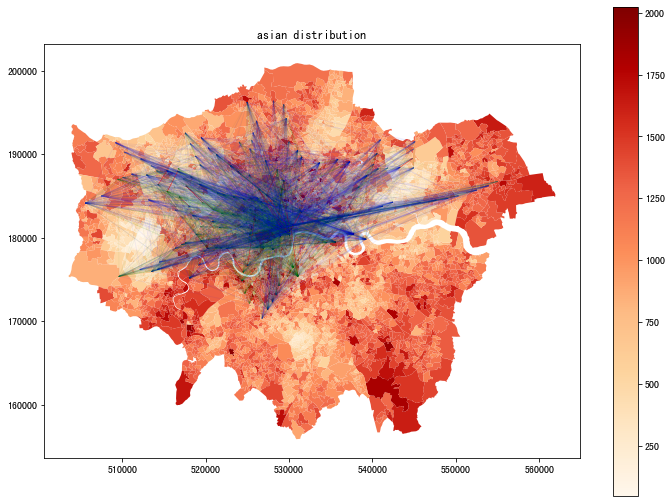

In [636]:
alphas = [0.05, 0.05, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, ethnic_df,'fsip_2work(relative)','white_total','asian distribution',lines,alphas)

##### Ethnic(Asian)

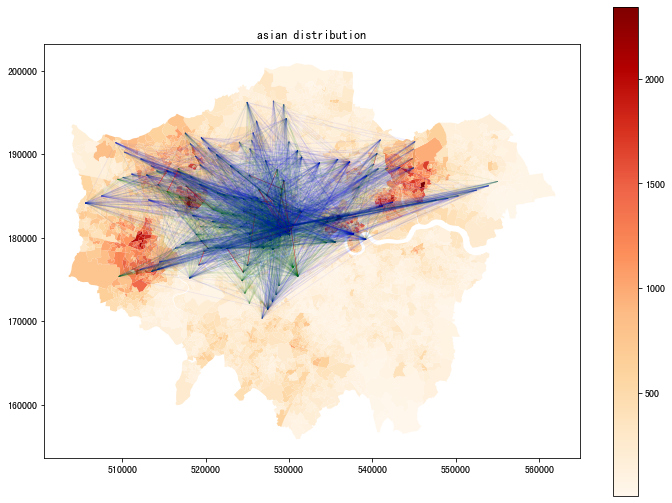

In [637]:
alphas = [0.05, 0.05, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, ethnic_df,'fsip_2work(relative)','asian_total','asian distribution',lines,alphas)

##### Ethnic(Black)

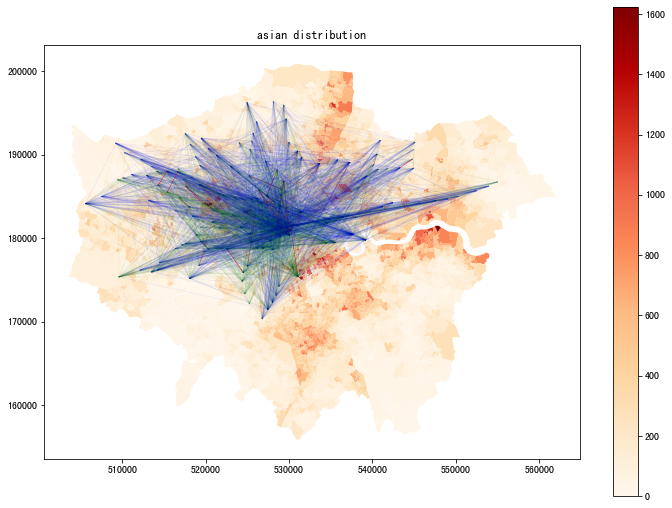

In [379]:
alphas = [0.05, 0.05, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, ethnic_df,'fsip_2work(relative)','black_total','asian distribution',lines,alphas)

##### Age(Young)

In [319]:
age_df.columns

Index(['lsoa_code', 'local_authority_name', 'all_usual_residents',
       'teenager_age', 'young_age', 'middle_age', 'old_age', 'objectid',
       'lsoa11nm_x', 'lsoa21cd', 'lsoa21nm_x', 'tcity15nm', 'geometry',
       '_merge', 'young_per', 'old_per'],
      dtype='object')

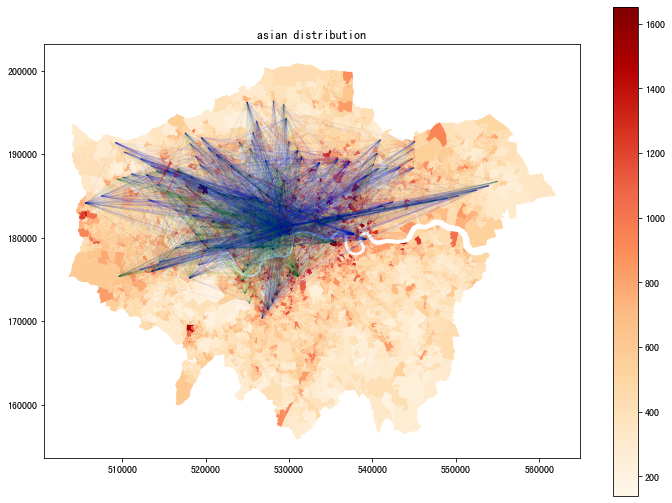

In [381]:
alphas = [0.05, 0.05, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, age_df,'fsip_2work(relative)','young_age','asian distribution',lines,alphas)

##### Age(Old)

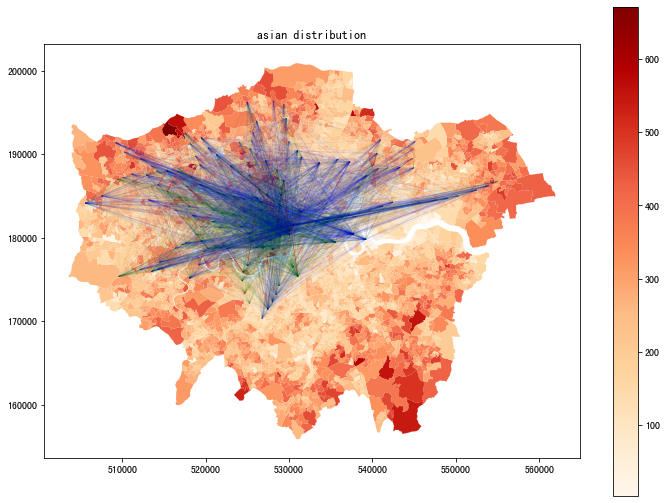

In [383]:
alphas = [0.05, 0.05, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, age_df,'fsip_2work(relative)','old_age','asian distribution',lines,alphas)

##### House Price

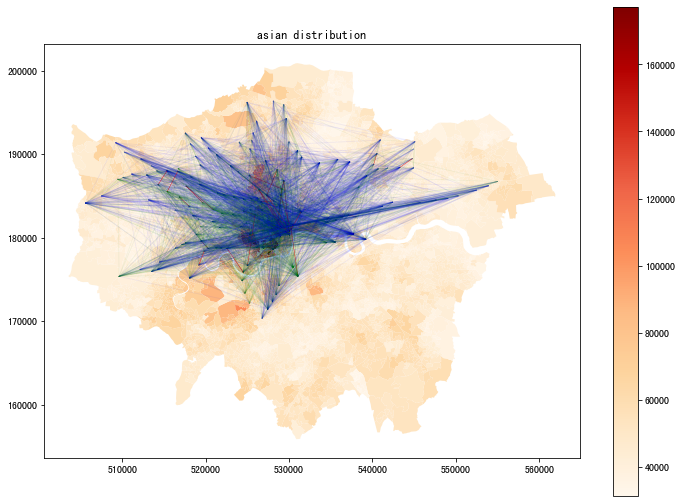

In [384]:
alphas = [0.05, 0.05, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, income_df,'fsip_2work(relative)','house_pri','asian distribution',lines,alphas)

#### To Edu

In [411]:
sorted_df = od_matrix_new.sort_values(by='fsip_2edu(relative)', ascending=False).head(100)
sorted_df.reset_index(drop=True, inplace=True)
sorted_df.head(40)

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
0,698,Seven Sisters,778,Brixton,217,186,252,318,145,33,...,0.328276,26.874125,21.371197,1.257493,2.710400,1.788777,1.515226,13.115144,11.623964,1.128285
1,742,Walthamstow Central,669,Oxford Circus,267,862,617,115,6,30,...,0.324923,26.566361,46.786058,0.567826,2.343641,4.419400,0.530307,10.556554,27.333197,0.386217
2,698,Seven Sisters,669,Oxford Circus,391,1034,613,97,114,21,...,0.329966,26.874125,46.786058,0.574405,2.710400,4.419400,0.613296,13.115144,27.333197,0.479825
3,742,Walthamstow Central,507,Angel,0,64,40,37,0,0,...,0.318219,26.566361,32.207660,0.824846,2.343641,2.767077,0.846973,10.556554,17.476667,0.604037
4,742,Walthamstow Central,674,Piccadilly Circus,62,181,67,8,45,0,...,0.322892,26.566361,41.975525,0.632901,2.343641,3.695687,0.634156,10.556554,23.878899,0.442087
5,698,Seven Sisters,590,Green Park,114,356,61,0,22,27,...,0.329734,26.874125,43.463635,0.618313,2.710400,4.104732,0.660311,13.115144,25.464410,0.515038
6,698,Seven Sisters,626,Knightsbridge,0,117,117,0,7,0,...,0.328012,26.874125,33.830178,0.794383,2.710400,2.884534,0.939632,13.115144,19.144071,0.685076
7,742,Walthamstow Central,607,Holborn,102,299,107,37,23,0,...,0.324564,26.566361,45.771078,0.580418,2.343641,4.169561,0.562083,10.556554,25.708049,0.410632
8,698,Seven Sisters,702,Sloane Square,46,205,73,0,0,0,...,0.328944,26.874125,30.855623,0.870964,2.710400,2.640531,1.026460,13.115144,17.506027,0.749179
9,698,Seven Sisters,607,Holborn,56,404,246,59,5,0,...,0.330389,26.874125,45.771078,0.587142,2.710400,4.169561,0.650045,13.115144,25.708049,0.510157


**Flows Description**


线路描述：

旅行目的为教育的人群在整个地铁线路中高强度交互大多分布在伦敦北部，中部，南部。而西部和东部的交互相对较弱。这与工作人群的组内聚集出现明显隔离特征。其中交互指数最高的地铁线路包括：Seven Sisters - Brixton, Walthamstow Central - Oxford Circusm, Seven Sisters - Oxford Circus, Walthamstow Central - Angle, Walthamstow Central - Piccadiliy Circus。这些终点站分布在伦敦中心段落，附近有大量的学校分布。与此同时，交互指数最低的地铁线路起点地铁站包括：North Greenwich, Ravenscourt Park, Putney Bridge, Westbourne Park，可以推测居住在这些地铁站附近的学生数量占当地居民比例很小。



Ethnic:
1. White
通勤目的为教育的人群与白人族裔在北部的分布有明显重叠情况

2. Asian
Ealing, Brent区域有向市区中心区域流动的趋势。这与该区域的亚洲人（印度人）分布有重合。这与该区域上班人群的聚集相似，说明该区域的印度裔通常在市区内工作或接受教育。对于其他亚洲人族裔，中国和孟加拉族裔的分布与高强度交互的地区同样出现重叠。而巴基斯坦族裔占比较多的Redbridge, Newham未出现聚集特征。

3. Black
居住在southwark的black_african同样有大量是学生

Age(Young):


Age(Old):
年龄分布上接受教育的人群与上班人群分类重合相似。这和现实情况相符合，绝大部分接受教育的都是年轻人。

House Price:

##### Ethnic(White)

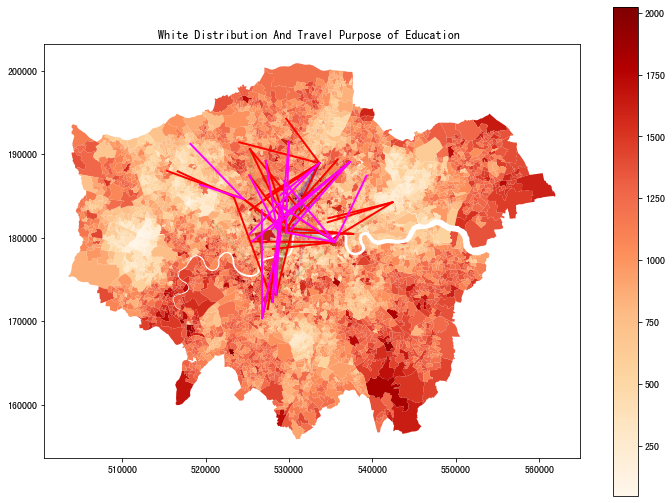

In [415]:
alphas = [0.1, 0.1, 1.0, 1.0]
lines = [2.0, 2.0, 2.0, 2.0]

# To work
plot_fsip(sorted_df, ethnic_df,'fsip_2edu(relative)','white_total','White Distribution And Travel Purpose of Education ',lines,alphas)

##### Ethnic(Asian)

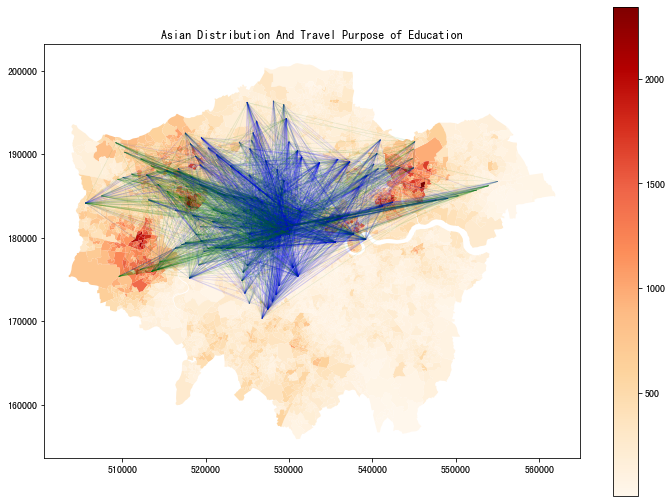

In [388]:
alphas = [0.1, 0.1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, ethnic_df,'fsip_2edu(relative)','asian_total','Asian Distribution And Travel Purpose of Education',lines,alphas)

##### Ethnic(Black)

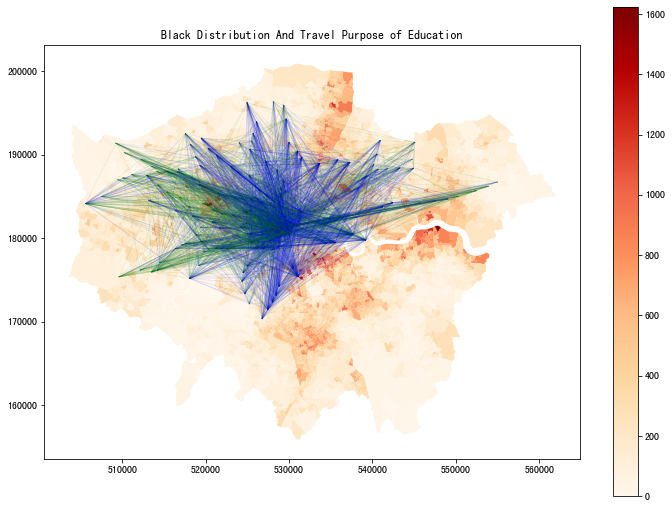

In [389]:
alphas = [0.1, 0.1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, ethnic_df,'fsip_2edu(relative)','black_total','Black Distribution And Travel Purpose of Education',lines,alphas)

##### Age(Young)

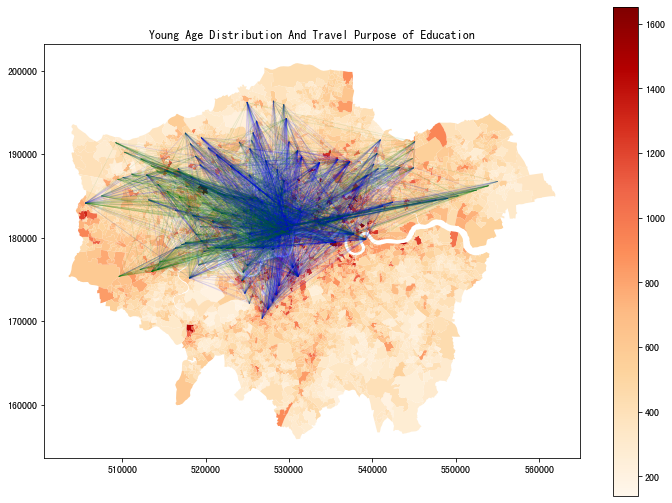

In [390]:
alphas = [0.1, 0.1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, age_df,'fsip_2edu(relative)','young_age','Young Age Distribution And Travel Purpose of Education',lines,alphas)

##### Age(Old)

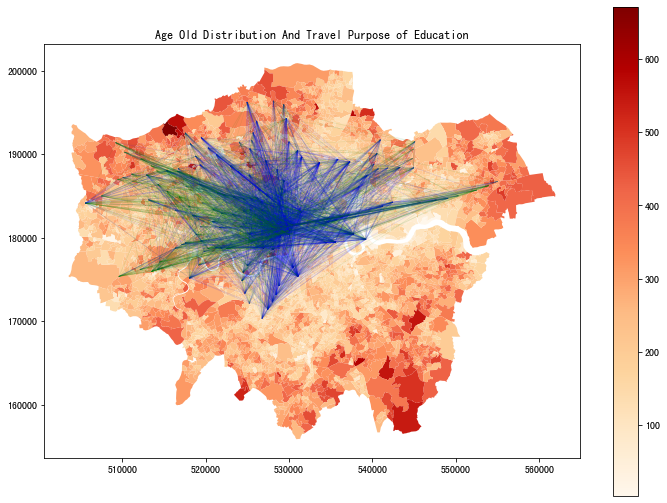

In [391]:
alphas = [0.1, 0.1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, age_df,'fsip_2edu(relative)','old_age','Age Old Distribution And Travel Purpose of Education',lines,alphas)

##### House Price

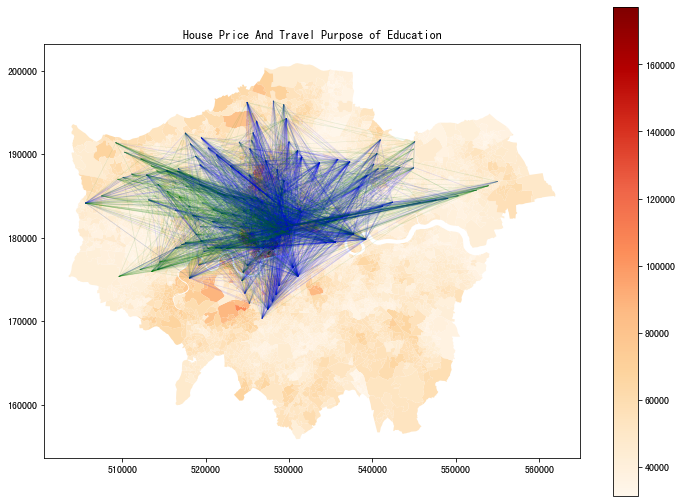

In [392]:
alphas = [0.1, 0.1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, income_df,'fsip_2edu(relative)','house_pri','House Price And Travel Purpose of Education',lines,alphas)

#### To Other

**Flows Description**


线路描述：

旅行目的为其他的人群在整个地铁线路中的交互大多属于中度交互水平，且并没有出现像工作或教育的聚集现象。导致这一现象有两个原因，一是other中目的包括tourist, hotel, shop, and other purposes（tourist占比最高）。这些不同的旅行目的通常在目的地选择上有较大不同，因此不容易聚集。第二是在早高峰阶段，属于该分类的出行人群数量占比最小。

强聚集的区域出现在伦敦中部，其中包括Charing Cross - Regent's Park, Southfields - Putney Bridge, Charing Cross - Oxford Circus, Southfields - Wimbledon Park, Charing Cross - Tottenham Court Road。这些地铁线路中，除开为交通枢纽的地铁终点站，其他终点站附近通常包含公园，和大量著名旅游景点。且指数排名前100的线路都是一些短途线路，同时在Kensington and Chelsea和Westminster此类中心但高房价的地区有聚集，这很好地体现了该类人群的旅行特征属性。	

因为该分类大部分人群并非居民，因此不讨论与人口统计的分布关系。

In [550]:
sorted_df = od_matrix_new.sort_values(by='fsip_2other(relative)', ascending=False).head(100)
sorted_df.reset_index(drop=True, inplace=True)
sorted_df.head(40)

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
0,718,Charing Cross,685,Regent's Park,39,420,167,66,37,15,...,0.354294,15.977632,13.786662,1.158919,1.490451,1.088423,1.369368,12.907907,8.162090,1.581446
1,705,Southfields,678,Putney Bridge,1,191,11,0,11,0,...,0.354545,15.781466,13.184606,1.196961,1.496946,0.991657,1.509540,9.634885,6.692066,1.439747
2,718,Charing Cross,669,Oxford Circus,98,1545,905,351,85,29,...,0.354336,15.977632,46.786058,0.341504,1.490451,4.419400,0.337252,12.907907,27.333197,0.472243
3,705,Southfields,768,Wimbledon Park,0,32,9,3,0,0,...,0.337041,15.781466,2.349627,6.716582,1.496946,0.192155,7.790299,9.634885,1.290711,7.464788
4,718,Charing Cross,728,Tottenham Court Road,10,127,250,90,33,0,...,0.351932,15.977632,38.743370,0.412397,1.490451,3.546020,0.420317,12.907907,21.872125,0.590153
5,718,Charing Cross,590,Green Park,0,73,66,19,8,0,...,0.351529,15.977632,43.463635,0.367609,1.490451,4.104732,0.363106,12.907907,25.464410,0.506900
6,718,Charing Cross,674,Piccadilly Circus,13,197,256,104,0,0,...,0.352294,15.977632,41.975525,0.380642,1.490451,3.695687,0.403295,12.907907,23.878899,0.540557
7,718,Charing Cross,524,Bond Street,14,47,101,33,16,0,...,0.343772,15.977632,38.975502,0.409940,1.490451,3.519879,0.423438,12.907907,22.349188,0.577556
8,705,Southfields,567,East Putney,0,35,42,15,7,0,...,0.343943,15.781466,10.043090,1.571376,1.496946,0.764901,1.957045,9.634885,5.235079,1.840447
9,685,Regent's Park,607,Holborn,0,21,45,23,0,0,...,0.331333,2.615807,45.771078,0.057150,0.240262,4.169561,0.057623,2.200546,25.708049,0.085598


##### Ethnic(White)

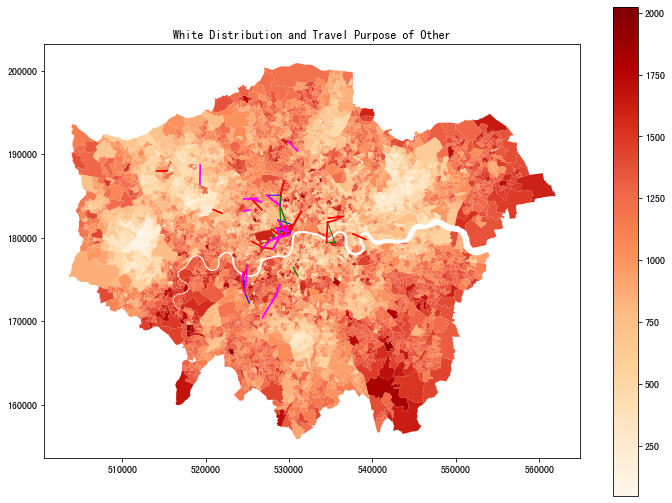

In [551]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 2.0, 2.0]

# To work
plot_fsip(sorted_df, ethnic_df,'fsip_2other(relative)','white_total','White Distribution and Travel Purpose of Other',lines,alphas)

##### Ethnic(Asian)

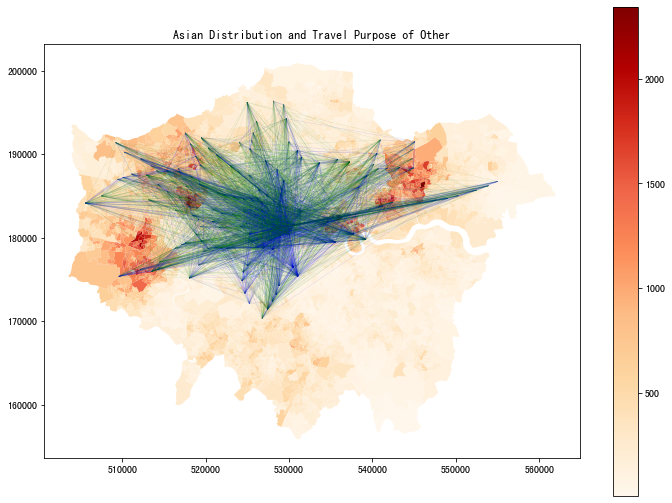

In [417]:
alphas = [0.1, 0.1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, ethnic_df,'fsip_2other(relative)','asian_total','Asian Distribution and Travel Purpose of Other',lines,alphas)

##### Ethnic(Black)

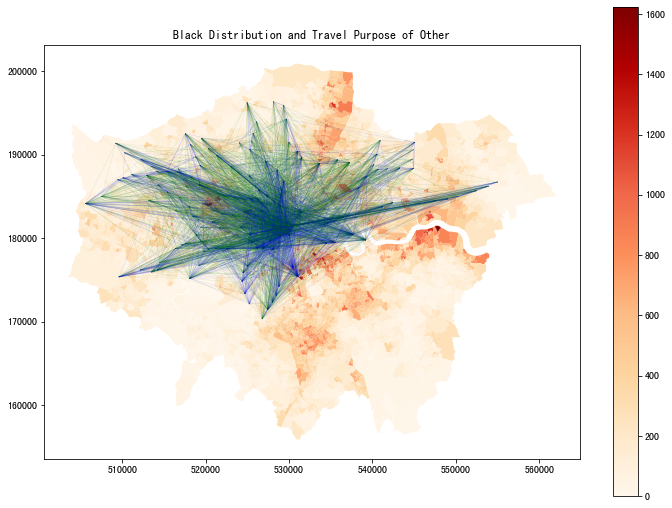

In [418]:
alphas = [0.1, 0.1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, ethnic_df,'fsip_2other(relative)','black_total','Black Distribution and Travel Purpose of Other',lines,alphas)

##### Age(Young)

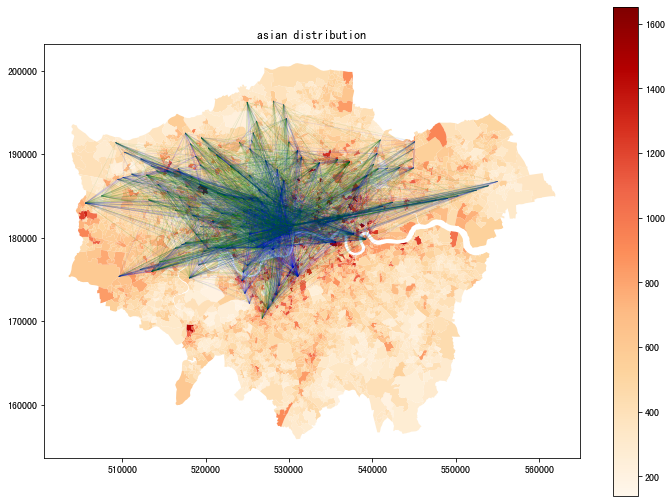

In [337]:
alphas = [0.1, 0.1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, age_df,'fsip_2other(relative)','young_age','Age Distribution and Travel Purpose of Young',lines,alphas)

##### Age(Old)

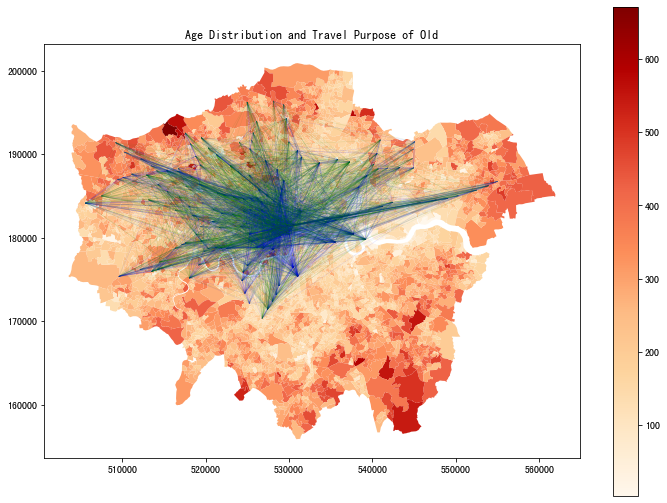

In [419]:
alphas = [0.1, 0.1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(od_matrix_new, age_df,'fsip_2other(relative)','old_age','Age Distribution and Travel Purpose of Old',lines,alphas)

##### House Price

In [436]:
sorted_df1 = income_df.sort_values(by='house_pri', ascending=False).head(100)
sorted_df1.reset_index(drop=True, inplace=True)
sorted_df1.head(30)

,lsoa_code,local_authority_name,all_usual_residents,white_total,asian_total,black_total,objectid,lsoa11nm_x,lsoa21cd,lsoa21nm_x,tcity15nm,geometry,_merge,name,house_pri
0,E01002903,Kensington and Chelsea,1269,1084,91,15,3189.0,Kensington and Chelsea 018E,E01002903,Kensington and Chelsea 018E,London,"POLYGON ((527786.517 178437.607, 527872.000 17...",both,Kensington and Chelsea 018E,177253.333333
1,E01002890,Kensington and Chelsea,1402,1045,172,18,3176.0,Kensington and Chelsea 010C,E01002890,Kensington and Chelsea 010C,London,"POLYGON ((526020.795 179583.957, 526039.462 17...",both,Kensington and Chelsea 010C,174403.333333
2,E01004687,Westminster,1316,1011,127,46,4523.0,Westminster 019A,E01004687,Westminster 019A,London,"POLYGON ((528382.540 179169.090, 528461.000 17...",both,Westminster 019A,166110.000000
3,E01004690,Westminster,1064,782,118,30,4526.0,Westminster 019D,E01004690,Westminster 019D,London,"POLYGON ((528593.339 179522.261, 528773.004 17...",both,Westminster 019D,162470.000000
4,E01002860,Kensington and Chelsea,1142,927,93,18,2535.0,Kensington and Chelsea 012D,E01002860,Kensington and Chelsea 012D,London,"POLYGON ((527586.014 179079.539, 527636.863 17...",both,Kensington and Chelsea 012D,155123.333333
5,E01002871,Kensington and Chelsea,1466,1143,156,23,3061.0,Kensington and Chelsea 007B,E01002871,Kensington and Chelsea 007B,London,"POLYGON ((524334.000 180528.000, 524390.316 18...",both,Kensington and Chelsea 007B,148230.000000
6,E01002863,Kensington and Chelsea,1116,842,99,18,2538.0,Kensington and Chelsea 012E,E01002863,Kensington and Chelsea 012E,London,"POLYGON ((528102.733 179186.149, 528124.818 17...",both,Kensington and Chelsea 012E,147576.666667
7,E01004692,Westminster,1026,558,253,33,4531.0,Westminster 019F,E01004692,Westminster 019F,London,"POLYGON ((527371.401 179688.733, 527385.959 17...",both,Westminster 019F,143933.333333
8,E01002868,Kensington and Chelsea,1357,933,238,18,3005.0,Kensington and Chelsea 009D,E01002868,Kensington and Chelsea 009D,London,"POLYGON ((524827.503 180066.005, 524906.426 17...",both,Kensington and Chelsea 009D,142276.666667
9,E01002865,Kensington and Chelsea,1448,1040,164,34,2903.0,Kensington and Chelsea 011E,E01002865,Kensington and Chelsea 011E,London,"POLYGON ((525128.941 179326.113, 524957.261 17...",both,Kensington and Chelsea 011E,139963.333333


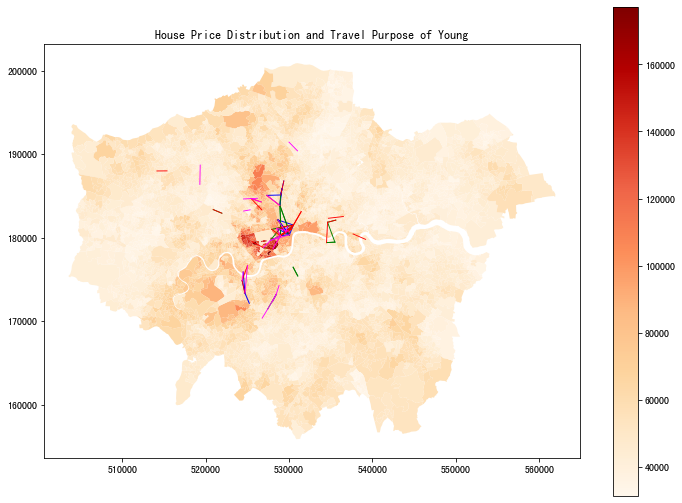

In [552]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df, income_df,'fsip_2other(relative)','house_pri','House Price Distribution and Travel Purpose of Young',lines,alphas)

#### To Work and Edu

**Flows Description**


线路描述：

上班人群和教育人群的交互情况与教育人群大致相似，这是因为早高峰通勤人数远大于教育人数。之间的聚集结果揭示了上班人群和教育人群在早高峰通勤所存在的隔离。因此我们将抽取交互排名较高的线路进行单独可视化，以此捕捉两个组别之间的交互特征。

这两个组别发生交互较高的前5条地铁线路为：Walthamstow Central - Marble Arch, Walthamstow Central - High Street Kensington	, Walthamstow Central - Oxford Circus, Walthamstow Central - Piccadilly Circus, Walthamstow Central - Tooting Broadway

这些线路大部分属于长线路，这说明工作人群和教育人群更容易在较长路线上产生交互。

对于交互指数前100的线路中，线路中起点站出现频次前5的站台分别为：Seven Sisters(0.24), Walthamstow Central(0.23), East Ham(0.11), Gants Hill(0.08), Woodford(0.05); 而终点站排前5的站台为: Tottenham Court Road , Oxford Circus , Canary Whar, South Kensington,Green Park  。


可视化结果显示了Seven Sisters，Walthamstow Central地区人口中有大量上班和教育人群。对于族裔分布上，白人族裔高占比地区的分布重合度最大。对于少数族裔，居住东北部的亚洲裔，以及二区北部的黑人所高度聚集的地区附近都存在高强度交互线路。这表明伦敦的地铁线路内存在潜在的种族隔离。

In [1182]:
sorted_df2 = od_matrix_new.sort_values(by='fsip_ampeak_workandedu(relative)', ascending=False).head(100)
sorted_df2.reset_index(drop=True, inplace=True)

In [1185]:
# 假设df是你的DataFrame，'column_name'是你想要计算占比的列名
value_counts = sorted_df2['station_origin'].value_counts()
total_rows = len(df)

# 计算各个值的占比
value_proportions = value_counts / total_rows

# 打印结果
print(value_proportions)# 假设df是你的DataFrame，'column_name'是你想要计算占比的列名
# value_counts = sorted_df2['station_destination'].value_counts()
# total_rows = len(df)

# # 计算各个值的占比
# value_proportions = value_counts / total_rows

# # 打印结果
# print(value_proportions)

Seven Sisters          0.098765
Walthamstow Central    0.094650
East Ham               0.045267
Gants Hill             0.032922
Woodford               0.020576
Canary Wharf           0.016461
Upton Park             0.016461
Finchley Central       0.016461
Blackhorse Road        0.016461
Colliers Wood          0.012346
Kilburn                0.012346
Willesden Green        0.008230
Golders Green          0.004115
Tooting Bec            0.004115
Tooting Broadway       0.004115
Wembley Park           0.004115
Balham                 0.004115
Name: station_origin, dtype: float64


In [600]:
sorted_df2.head(30)

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
0,742,Walthamstow Central,640,Marble Arch,0,302,198,0,0,0,...,0.322733,26.566361,24.634182,1.078435,2.343641,2.156423,1.086819,10.556554,13.401640,0.787706
1,742,Walthamstow Central,605,High Street Kensington,57,115,40,0,0,0,...,0.320944,26.566361,30.908033,0.859529,2.343641,2.604973,0.899680,10.556554,16.980850,0.621674
2,742,Walthamstow Central,669,Oxford Circus,267,862,617,115,6,30,...,0.324923,26.566361,46.786058,0.567826,2.343641,4.419400,0.530307,10.556554,27.333197,0.386217
3,742,Walthamstow Central,674,Piccadilly Circus,62,181,67,8,45,0,...,0.322892,26.566361,41.975525,0.632901,2.343641,3.695687,0.634156,10.556554,23.878899,0.442087
4,742,Walthamstow Central,727,Tooting Broadway,60,129,74,0,31,0,...,0.321580,26.566361,17.399059,1.526885,2.343641,1.343347,1.744628,10.556554,7.964740,1.325411
5,742,Walthamstow Central,590,Green Park,208,361,131,71,36,0,...,0.322723,26.566361,43.463635,0.611232,2.343641,4.104732,0.570961,10.556554,25.464410,0.414561
6,742,Walthamstow Central,723,Swiss Cottage,0,61,0,0,0,0,...,0.317406,26.566361,15.675829,1.694734,2.343641,1.208801,1.938814,10.556554,8.715578,1.211228
7,742,Walthamstow Central,507,Angel,0,64,40,37,0,0,...,0.318219,26.566361,32.207660,0.824846,2.343641,2.767077,0.846973,10.556554,17.476667,0.604037
8,742,Walthamstow Central,626,Knightsbridge,96,153,25,40,0,5,...,0.319537,26.566361,33.830178,0.785286,2.343641,2.884534,0.812485,10.556554,19.144071,0.551427
9,742,Walthamstow Central,607,Holborn,102,299,107,37,23,0,...,0.324564,26.566361,45.771078,0.580418,2.343641,4.169561,0.562083,10.556554,25.708049,0.410632


In [601]:
#sorted_df2['station_origin'].values_counts()

value_counts = sorted_df2['station_origin'].value_counts()
total_rows = len(sorted_df2)

# 计算各个值的占比
value_proportions = value_counts / total_rows

# 打印结果
print(value_proportions)

Seven Sisters          0.24
Walthamstow Central    0.23
East Ham               0.11
Gants Hill             0.08
Woodford               0.05
Canary Wharf           0.04
Upton Park             0.04
Finchley Central       0.04
Blackhorse Road        0.04
Colliers Wood          0.03
Kilburn                0.03
Willesden Green        0.02
Golders Green          0.01
Tooting Bec            0.01
Tooting Broadway       0.01
Wembley Park           0.01
Balham                 0.01
Name: station_origin, dtype: float64


##### Ethnic(White)

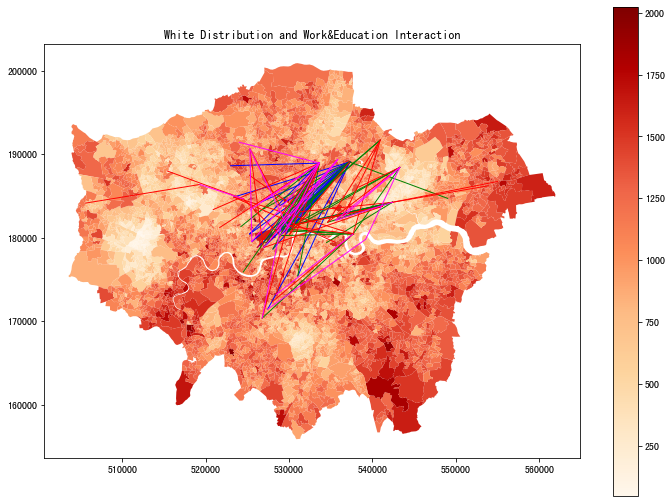

In [602]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, ethnic_df,'fsip_ampeak_workandedu(relative)','white_total','White Distribution and Work&Education Interaction',lines,alphas)

##### Ethnic(Asian)

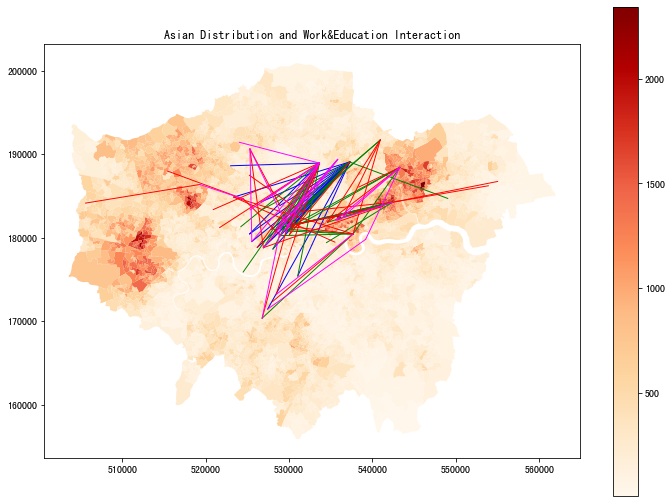

In [603]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, ethnic_df,'fsip_ampeak_workandedu(relative)','asian_total','Asian Distribution and Work&Education Interaction',lines,alphas)

##### Ethnic(Black)

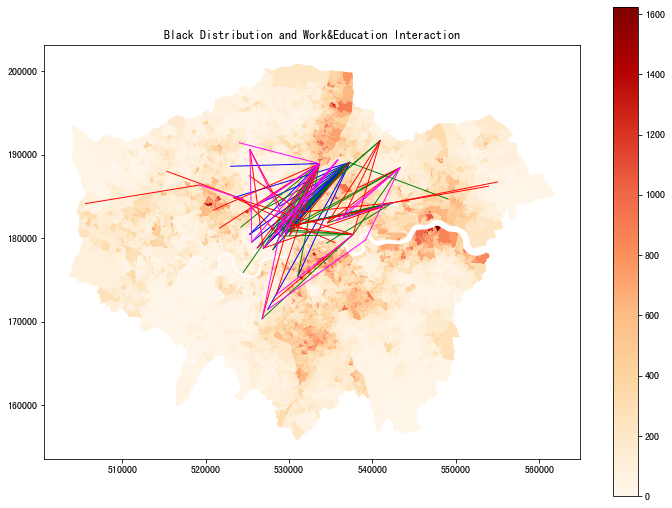

In [604]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, ethnic_df,'fsip_ampeak_workandedu(relative)','black_total','Black Distribution and Work&Education Interaction',lines,alphas)

##### Age(Young)

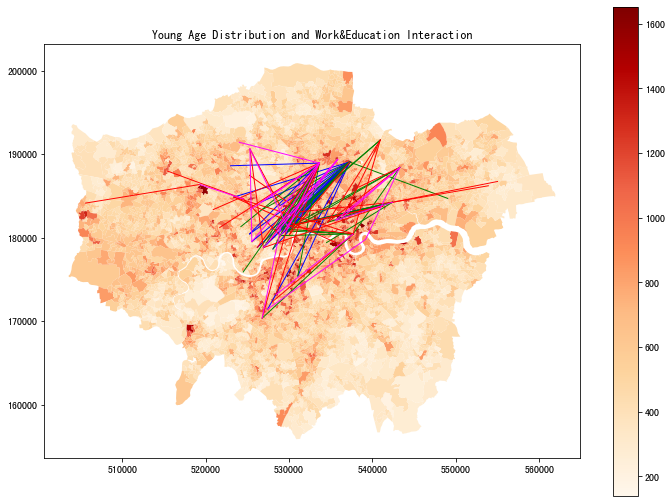

In [605]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, age_df,'fsip_ampeak_workandedu(relative)','young_age','Young Age Distribution and Work&Education Interaction',lines,alphas)

##### Age(Old)

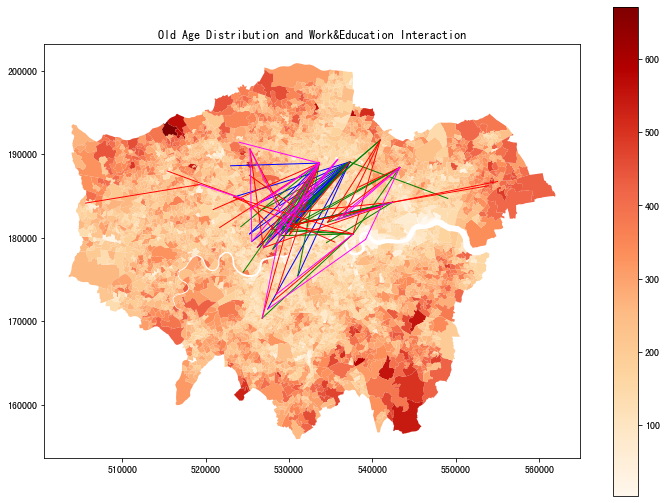

In [563]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, age_df,'fsip_ampeak_workandedu(relative)','old_age','Old Age Distribution and Work&Education Interaction',lines,alphas)

##### House Price

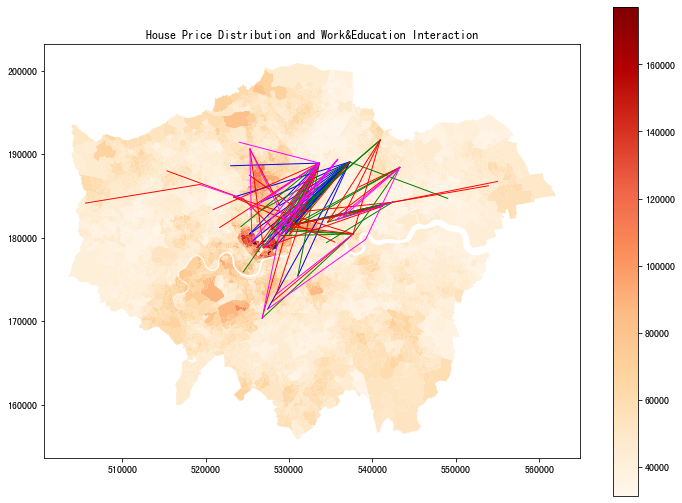

In [564]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, income_df,'fsip_ampeak_workandedu(relative)','house_pri','House Price Distribution and Work&Education Interaction',lines,alphas)

#### To Work and Other

**Flows Description**

线路描述：

上班人群与其他人群的容易发生交互线路分布较广，且呈现横向分布趋势。


这两个组别发生交互最高的前5条线路为: Canary Wharf - North Greenwich, Nortth Greenwich - Canary Wharf, Wembley Park - Kingsbury, Canada Water - Whitechapel, Balham - Tooting Broadway.

交互指数出现频次前5的起点站台包括: Brixton, Canada Water, Charing Cross, Green Park, Tottenham Court Road;终点站排前5的终点站台包括: Oxford Circus, Green Park, Canary Wharf, Bond Street, Tottenham Court Road。可以发现上班人群与其他通勤目的的团队发生高频交互的地点都是重要枢纽站点。除了枢纽站台外，Kew Gardem, Richmond, Hamstead等距离市区较远的终点站也出现较高强度的交互。

南北部线路没有出现显著的交互聚集，这和other团体的通勤模式相符，因为这一团体的通勤线路主要为中心地段，短途。

对于不同族裔的上班团体，白人族裔更多的与其他group在伦敦中心区域发生交互且交互程度较强。而少数族裔上班团体更容易与other group在长地铁线路上产生交互，但交互程度较弱。

In [566]:
sorted_df2 = od_matrix_new.sort_values(by='fsip_ampeak_workandother(relative)', ascending=False).head(100)
sorted_df2.reset_index(drop=True, inplace=True)

In [584]:
sorted_df2.head(10)

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
0,852,Canary Wharf,789,North Greenwich,0,205,631,1548,759,211,...,0.363487,22.713707,20.719564,1.096244,1.963642,1.619656,1.212382,10.259112,9.878305,1.038550
1,789,North Greenwich,852,Canary Wharf,339,1536,635,404,211,446,...,0.359191,31.067612,45.798127,0.678360,2.575045,3.987372,0.645800,14.137112,22.521573,0.627714
2,752,Wembley Park,624,Kingsbury,0,164,319,200,221,14,...,0.358381,16.876434,4.833290,3.491707,1.519551,0.357129,4.254907,7.590518,2.305565,3.292259
3,788,Canada Water,763,Whitechapel,0,184,182,0,0,0,...,0.358367,29.096902,23.783936,1.223385,2.835293,1.995146,1.421095,15.666147,12.707513,1.232826
4,512,Balham,727,Tooting Broadway,51,385,527,455,260,117,...,0.357876,19.844401,17.399059,1.140544,2.123676,1.343347,1.580884,11.261436,7.964740,1.413911
5,650,Newbury Park,515,Barkingside,0,137,0,0,12,0,...,0.357785,14.603954,2.206434,6.618805,1.010078,0.165332,6.109393,6.262068,1.218793,5.137925
6,590,Green Park,669,Oxford Circus,0,86,530,333,82,25,...,0.357658,12.188054,46.786058,0.260506,1.159102,4.419400,0.262276,8.985804,27.333197,0.328751
7,788,Canada Water,787,Bermondsey,0,123,225,264,237,66,...,0.357656,29.096902,10.235291,2.842802,2.835293,0.883155,3.210415,15.666147,5.361708,2.921857
8,728,Tottenham Court Road,535,Camden Town,0,27,336,210,116,100,...,0.357562,12.946684,23.021372,0.562377,0.993048,2.143700,0.463240,8.593016,13.755545,0.624695
9,590,Green Park,626,Knightsbridge,0,46,308,234,71,0,...,0.357312,12.188054,33.830178,0.360272,1.159102,2.884534,0.401833,8.985804,19.144071,0.469378


In [589]:
# 假设df是你的DataFrame，'column_name'是你想要计算占比的列名
value_counts = sorted_df2['station_destination'].value_counts()
total_rows = len(df)

# 计算各个值的占比
value_proportions = value_counts / total_rows

# 打印结果
print(value_proportions)

Oxford Circus             0.032922
Green Park                0.024691
Canary Wharf              0.020576
Bond Street               0.016461
Tottenham Court Road      0.016461
Holborn                   0.016461
Piccadilly Circus         0.012346
Tooting Broadway          0.012346
Whitechapel               0.012346
Bermondsey                0.012346
Balham                    0.012346
Canada Water              0.012346
Angel                     0.008230
Sloane Square             0.008230
Knightsbridge             0.008230
Camden Town               0.008230
North Greenwich           0.008230
South Kensington          0.008230
Covent Garden             0.004115
Stanmore                  0.004115
Kew Gardens               0.004115
Richmond                  0.004115
Hampstead                 0.004115
Upton Park                0.004115
Bounds Green              0.004115
St. John's Wood           0.004115
Kingsbury                 0.004115
Colindale                 0.004115
Blackhorse Road     

##### Ethnic(White)

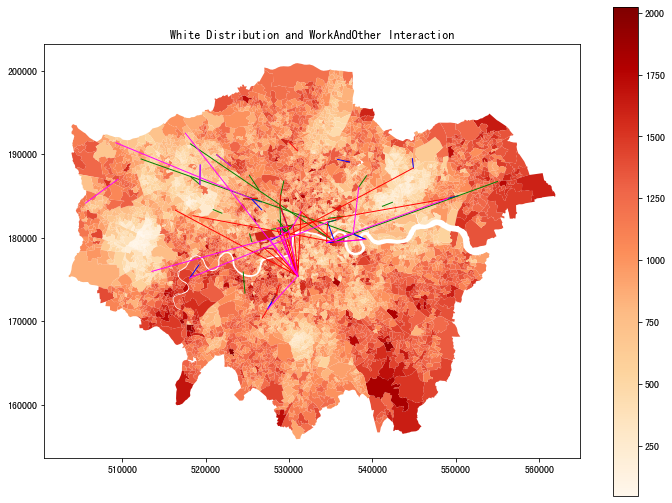

In [568]:
alphas = [1, 1, 1, 1]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, ethnic_df,'fsip_ampeak_workandother(relative)','white_total','White Distribution and WorkAndOther Interaction',lines,alphas)

##### Ethnic(Asian)

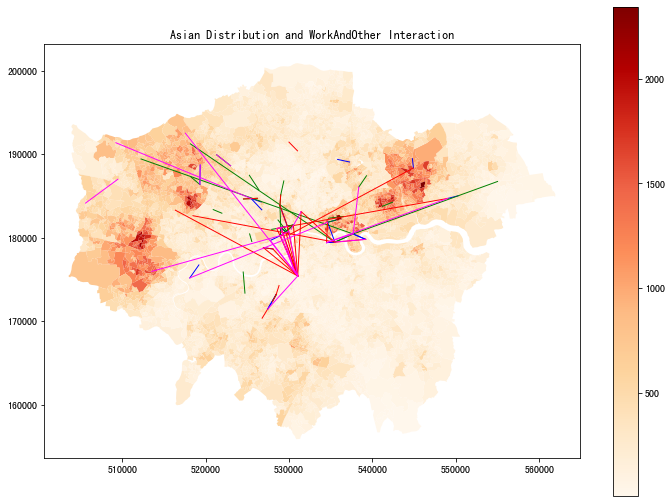

In [571]:
alphas = [1, 1, 1, 1]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, ethnic_df,'fsip_ampeak_workandother(relative)','asian_total','Asian Distribution and WorkAndOther Interaction',lines,alphas)

##### Ethnic(Black)

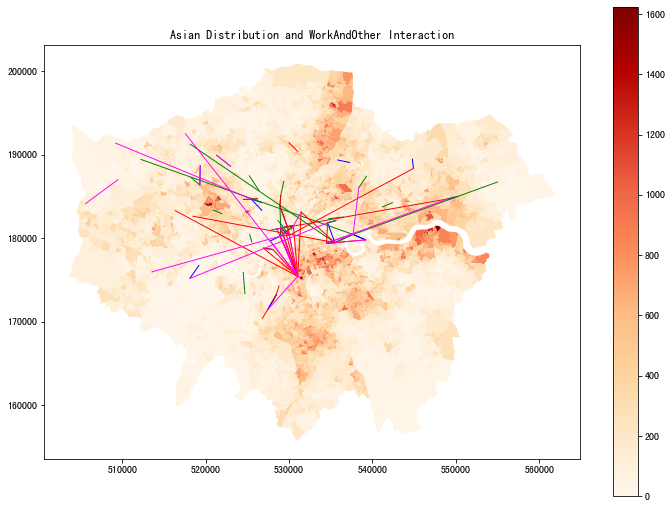

In [573]:
alphas = [1, 1, 1, 1]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, ethnic_df,'fsip_ampeak_workandother(relative)','black_total','Asian Distribution and WorkAndOther Interaction',lines,alphas)

##### Age(Young)

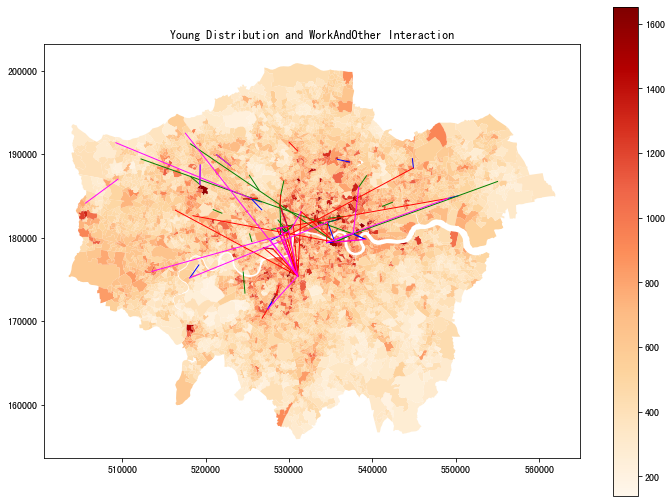

In [575]:
alphas = [1, 1, 1, 1]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, age_df,'fsip_ampeak_workandother(relative)','young_age','Young Distribution and WorkAndOther Interaction',lines,alphas)

##### Age(Old)

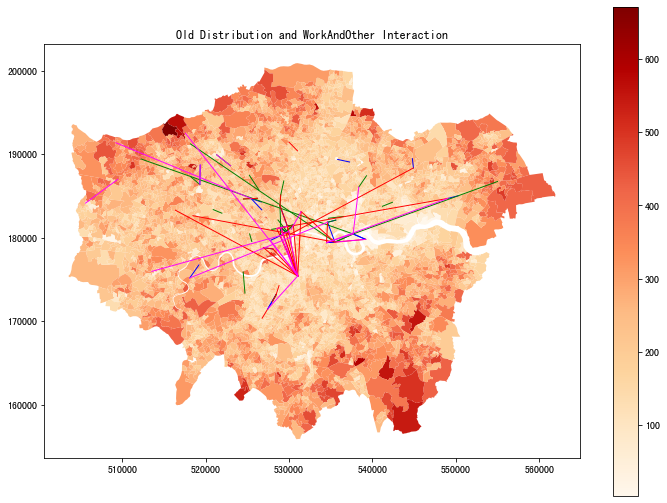

In [577]:
alphas = [1, 1, 1, 1]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, age_df,'fsip_ampeak_workandother(relative)','old_age','Old Distribution and WorkAndOther Interaction',lines,alphas)

##### House Price

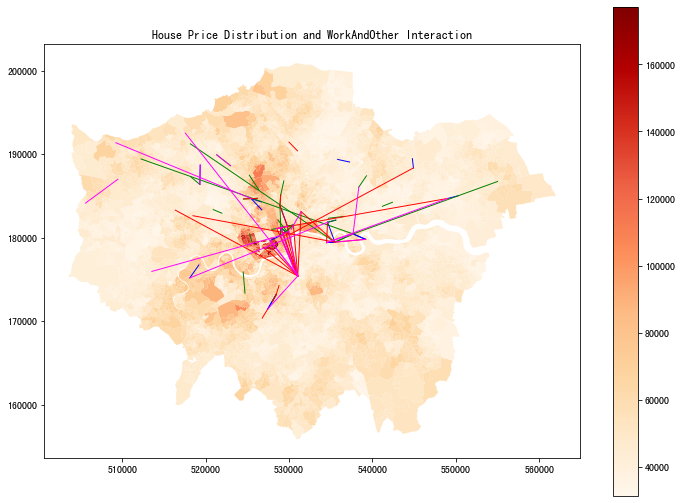

In [578]:
alphas = [1, 1, 1, 1]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, income_df,'fsip_ampeak_workandother(relative)','house_pri','House Price Distribution and WorkAndOther Interaction',lines,alphas)

#### To Edu and Other

**Flows Description**

线路描述：

上班人群与其他人群的容易发生交互线路分布比较聚集，且呈现竖向分布趋势


这两个组别发生交互最高的前5条线路为: Oxford Circus - Holborn	, Canada Water - Whitechapel, Balham - Tooting Broadway, Southfields - Putney Bridge, Charing Cross - Regent's Park.


交互指数出现频次前5的起点站台包括: Brixton, Stockwell , Charing Cross, Oxford Circus, Kentish Town;终点站排前5的终点站台包括: Holborn, Tottenham Court Road, Green Park, Piccadilly Circus, Oxford Circus。与之前的组间交互类似，高强度交互起始站台中包括了大量枢纽站台。但是，起点站台中的Stockwell, Kentish Town都是属于Zone 2的住宅区，说明这两个地区的居民流动比较活跃


这两个团体的交互分布与白人族裔和黑人族裔在Brixton, Peckham, Camberwell的分布出现重合。可以推测教育团体和other团体中大部分交互发生与白人族裔和黑人族裔之间，亚洲族裔相对很少。且年龄段主要为工作年纪人员而非老年人。且交互多发地房价水平较高，因此可以推测居住在Westminster, Chelsea, Battersea, Brixton的学生群体和出行购物，旅行的人群发生交互的可能性较大。

In [606]:
sorted_df2 = od_matrix_new.sort_values(by='fsip_ampeak_eduandother(relative)', ascending=False).head(100)
sorted_df2.reset_index(drop=True, inplace=True)

In [615]:
sorted_df2.head(30)

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
0,669,Oxford Circus,607,Holborn,0,56,638,288,131,0,...,0.354353,15.141101,45.771078,0.330801,1.318989,4.169561,0.316338,10.873995,25.708049,0.422980
1,788,Canada Water,763,Whitechapel,0,184,182,0,0,0,...,0.358367,29.096902,23.783936,1.223385,2.835293,1.995146,1.421095,15.666147,12.707513,1.232826
2,512,Balham,727,Tooting Broadway,51,385,527,455,260,117,...,0.357876,19.844401,17.399059,1.140544,2.123676,1.343347,1.580884,11.261436,7.964740,1.413911
3,705,Southfields,678,Putney Bridge,1,191,11,0,11,0,...,0.354545,15.781466,13.184606,1.196961,1.496946,0.991657,1.509540,9.634885,6.692066,1.439747
4,718,Charing Cross,685,Regent's Park,39,420,167,66,37,15,...,0.354294,15.977632,13.786662,1.158919,1.490451,1.088423,1.369368,12.907907,8.162090,1.581446
5,788,Canada Water,787,Bermondsey,0,123,225,264,237,66,...,0.357656,29.096902,10.235291,2.842802,2.835293,0.883155,3.210415,15.666147,5.361708,2.921857
6,718,Charing Cross,669,Oxford Circus,98,1545,905,351,85,29,...,0.354336,15.977632,46.786058,0.341504,1.490451,4.419400,0.337252,12.907907,27.333197,0.472243
7,590,Green Park,669,Oxford Circus,0,86,530,333,82,25,...,0.357658,12.188054,46.786058,0.260506,1.159102,4.419400,0.262276,8.985804,27.333197,0.328751
8,619,Kentish Town,508,Archway,22,167,156,115,49,16,...,0.353025,15.078353,15.430389,0.977186,1.456930,1.337502,1.089292,11.755258,8.830943,1.331144
9,852,Canary Wharf,789,North Greenwich,0,205,631,1548,759,211,...,0.363487,22.713707,20.719564,1.096244,1.963642,1.619656,1.212382,10.259112,9.878305,1.038550


In [617]:
# 假设df是你的DataFrame，'column_name'是你想要计算占比的列名
value_counts = sorted_df2['station_destination'].value_counts()
total_rows = len(df)

# 计算各个值的占比
value_proportions = value_counts / total_rows

# 打印结果
print(value_proportions)

Holborn                 0.028807
Tottenham Court Road    0.024691
Green Park              0.020576
Piccadilly Circus       0.020576
Oxford Circus           0.020576
Balham                  0.020576
South Kensington        0.016461
Canary Wharf            0.016461
Tooting Broadway        0.016461
Angel                   0.016461
Whitechapel             0.012346
Knightsbridge           0.012346
Mile End                0.012346
Notting Hill Gate       0.008230
Sloane Square           0.008230
North Greenwich         0.008230
Colliers Wood           0.008230
Brixton                 0.008230
Wanstead                0.008230
Kentish Town            0.008230
Bond Street             0.008230
Swiss Cottage           0.004115
Leicester Square        0.004115
Stockwell               0.004115
East Putney             0.004115
Archway                 0.004115
Stepney Green           0.004115
Hampstead               0.004115
Marble Arch             0.004115
Leyton                  0.004115
Tufnell Pa

##### Ethnic(White)

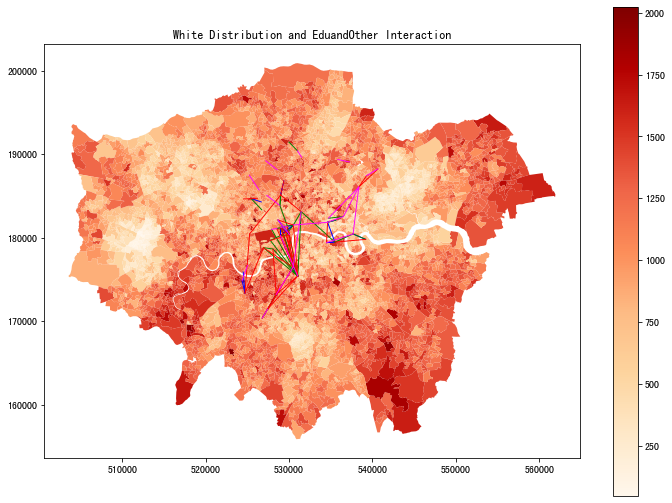

In [607]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, ethnic_df,'fsip_ampeak_eduandother(relative)','white_total','White Distribution and EduandOther Interaction',lines,alphas)

##### Ethnic(Asian)

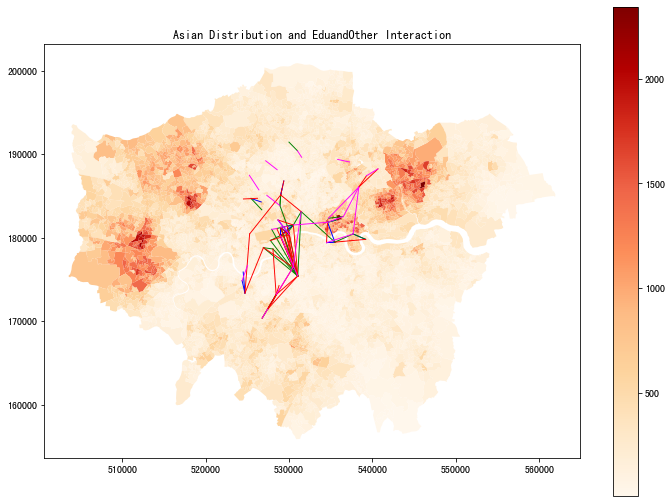

In [608]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, ethnic_df,'fsip_ampeak_eduandother(relative)','asian_total','Asian Distribution and EduandOther Interaction',lines,alphas)

##### Ethnic(Black)

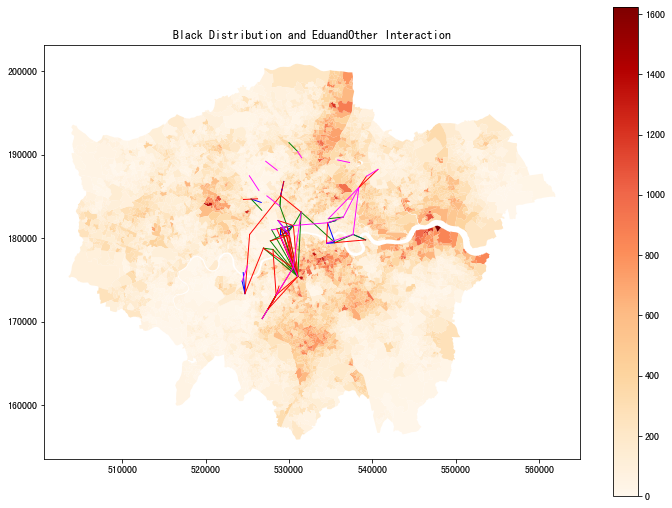

In [609]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, ethnic_df,'fsip_ampeak_eduandother(relative)','black_total','Black Distribution and EduandOther Interaction',lines,alphas)

##### Age(Young)

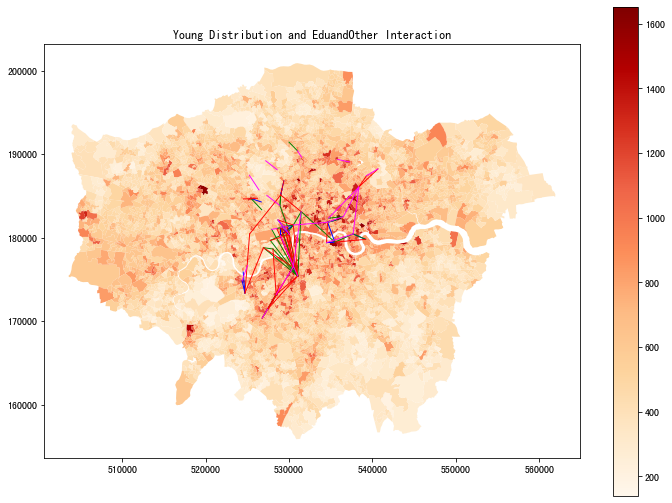

In [611]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, age_df,'fsip_ampeak_eduandother(relative)','young_age','Young Distribution and EduandOther Interaction',lines,alphas)

##### Age(Old)

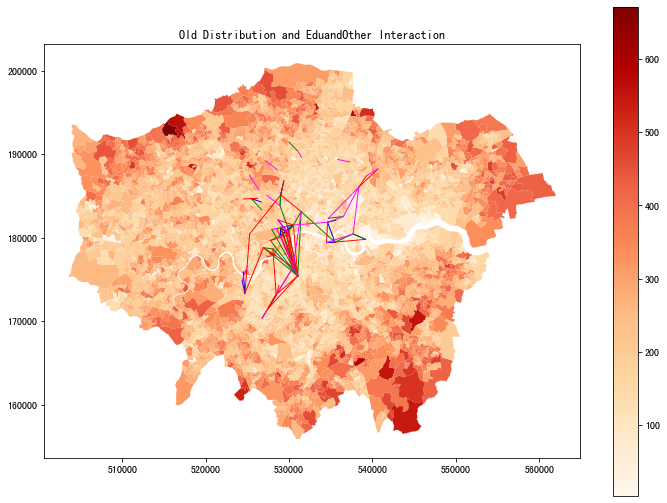

In [612]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]

# To work
plot_fsip(sorted_df2, age_df,'fsip_ampeak_eduandother(relative)','old_age','Old Distribution and EduandOther Interaction',lines,alphas)

##### House Price

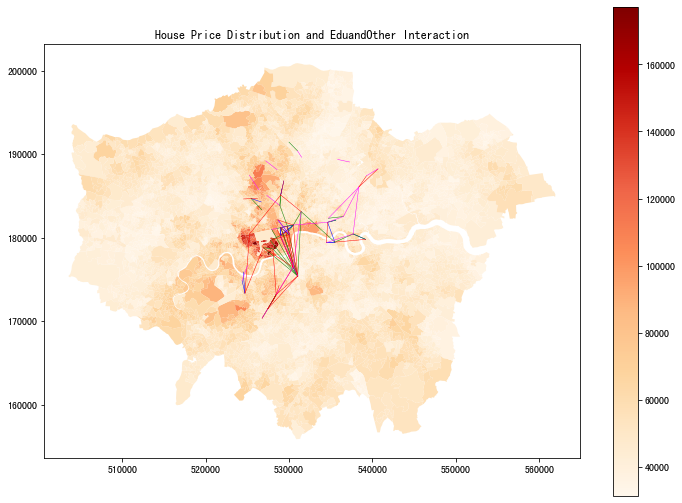

In [618]:
alphas = [1, 1, 1.0, 1.0]
#lines = [1.0, 1.0, 1.0, 1.0]
lines = [0.5, 0.5, 0.5, 0.5]

# To work
plot_fsip(sorted_df2, income_df,'fsip_ampeak_eduandother(relative)','house_pri','House Price Distribution and EduandOther Interaction',lines,alphas)

### Placed Based Measures

In [731]:
def odmatrix_vis_pb(od_df, col_name, lines, alphas):
    # 假设你有一个颜色序列 color，长度与 x 和 y 相同，用于映射点的颜色
color = [0.1, 0.4, 0.6, 0.8, 1.0]

# 绘制点，根据 color 映射不同的颜色
plt.scatter(x, y, c=color, cmap='viridis', s=100)
    
    
    
    for i in range(0,len(od_df)):
        x = od_df['orig_x'][i]
        y = od_df['orig_y'][i]
        tmp_fsip = od_df[col_name][i]
        # 绘制线条并设置宽度
        quan_25 = od_df[col_name].quantile(0.2)
        quan_50 = od_df[col_name].quantile(0.5)
        quan_75 = od_df[col_name].quantile(0.8)
        quan_100 = max(od_df[col_name])


        #print(fsip_ampeak_workandedu, max(od_matrix_cleaned["place_based_fsip(other)"]))
        if(quan_75 < tmp_fsip <= quan_100):
            #plt.plot(x1, y1, linewidth=tmp_fsip / max(od_df[col_name])*lines[0], color='Blue',alpha=alphas[0])
            
                        # 绘制点，根据 color 映射不同的颜色
            plt.scatter(x, y, c='red', cmap='viridis', s=100)

        elif(quan_50 < tmp_fsip <= quan_75):
            #plt.plot(x1, y1, linewidth=(tmp_fsip / max(od_df[col_name]))*lines[1], color="Green",alpha=alphas[1])
            plt.scatter(x, y, c='green', cmap='viridis', s=100)
        elif(quan_25 < tmp_fsip <= quan_50):
            #plt.plot(x1, y1, linewidth=(tmp_fsip / max(od_df[col_name]))*lines[2], color="Red",alpha=alphas[2])
            plt.scatter(x, y, c='blue', cmap='viridis', s=100)
        elif(tmp_fsip <= quan_25):
            #plt.plot(x1, y1, linewidth=(tmp_fsip / max(od_df[col_name]))*lines[3], color="magenta",alpha=alphas[3])
            plt.scatter(x, y, c='yellow', cmap='viridis', s=100)

In [924]:
def plot_fsip_inflow(df_fsip, df_demo, col_fsip, col_demo, title, lines, alphas):
    # 创建画布和坐标轴
    fig, ax = plt.subplots(figsize=(12, 9))

    # 绘制地图，并设置颜色条和标签名称
    scatter_plot1 = df_demo.plot(column=col_demo, cmap='OrRd', legend=True, ax=ax)
#     cbar1 = fig.colorbar(scatter_plot1, ax=ax)
#     cbar1.set_label('Colorbar 1 Label')

    # 设置标题和坐标轴标签等
    ax.set_title(title)
    ax.set_xlabel("X-axis")
    ax.set_ylabel("Y-axis")

    # 计算散点图颜色
    color = df_fsip[col_fsip] / df_fsip[col_fsip].max()

    # 绘制散点图，并设置颜色和大小等参数
    scatter_plot2 = ax.scatter(df_fsip['dest_x'], df_fsip['dest_y'], c=color, cmap='viridis', s=50, alpha=0.8)

    # 添加第二个颜色条，并设置标签名称
    cbar2 = fig.colorbar(scatter_plot2, ax=ax)
    cbar2.set_label('Colorbar 2 Label')
    #plt.savefig('test_inflow.pdf')
    # 显示图形
    #plt.show()

In [925]:
def plot_fsip_outflow(df_fsip, df_demo, col_fsip, col_demo,tittle,lines, alphas):
    ax = df_demo.plot(column=col_demo, cmap='OrRd', legend=True, figsize=(12,9))
    ax.set_title(tittle)
    
    #odmatrix_vis_pb(df_fsip,col_fsip, lines, alphas)
    
    color = df_fsip[col_fsip]/df_fsip[col_fsip].max()
    
    plt.scatter(df_fsip['orig_x'], df_fsip['orig_y'], c=color, cmap='viridis', s=50,alpha=0.8)
    # 添加颜色条
    plt.colorbar(label='Outflow Scale')
    #plt.savefig('test_outflow.pdf')
    #plt.show()

#### To Work

Flows Description

线路描述：

相比relative measures较为宏观的描述线路分布。Place-based指数反映了线路中在某一起点站或终点站的组内聚集交互情况。对于上班组，交互线路在整个地铁线路中占比都很高。为了了解该团体的聚集，该板块只将place based FSIP（work）前100的线路进行可视化分析。

对于前100的线路中，起点为Brixton, North Greenwich, Canada Water, Seven Sisters的站台出现频次最多，这说明有大量的上班族在这些地铁站进行中转或附近居住。而终点排名在该指数排名前100的站台出现频次最高的前五个站台为: Barkingside, Wimbledon Park, Northwood Hills, Fairlop, Redbridge

Outflow:


Inflow:


In [867]:
outflow_sorted_df = od_matrix_new.sort_values(by='relative_outflow(work)', ascending=False)
# 假设 df 是你的 DataFrame，column_name 是你想根据其唯一值进行筛选的列名
outflow_df = outflow_sorted_df.drop_duplicates(subset=['station_origin'])

inflow_sorted_df = od_matrix_new.sort_values(by='relative_inflow(work)', ascending=False)
inflow_df = inflow_sorted_df.drop_duplicates(subset=['station_destination'])

outflow_df.reset_index(drop=True, inplace=True)
inflow_df.reset_index(drop=True, inplace=True)

In [864]:
outflow_df['relative_outflow(work)']

0      31.067612
1      31.052347
2      29.096902
3      26.874125
4      26.566361
         ...    
153     7.426090
154     6.997896
155     6.317568
156     5.890587
157     2.615807
Name: relative_outflow(work), Length: 158, dtype: float64

##### Ethnic(White)

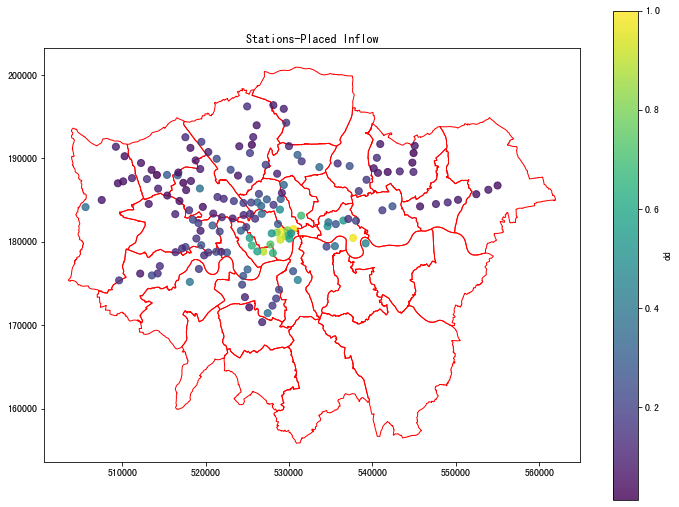

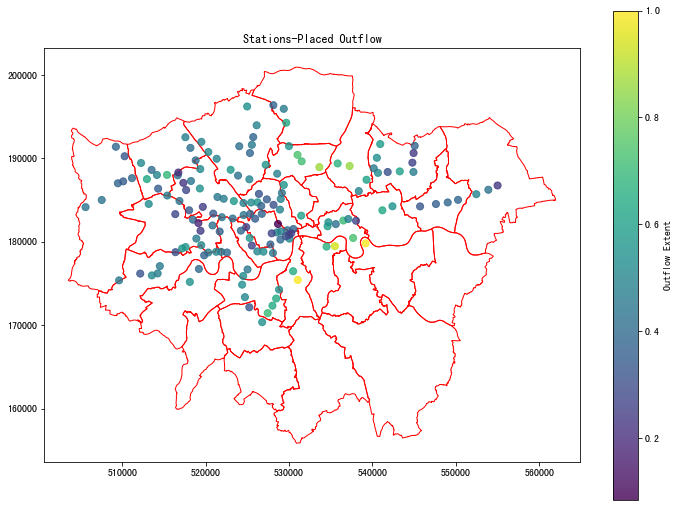

In [868]:
#We can check that this has occured by plotting the results
London.plot(figsize = (12,9), facecolor = "None", edgecolor = "r")
color = inflow_df['relative_inflow(work)']/inflow_df['relative_inflow(work)'].max()

plt.scatter(inflow_df['dest_x'], inflow_df['dest_y'], c=color, cmap='viridis', s=50,alpha=0.8)
# 添加颜色条
plt.title("Stations-Placed Inflow")
plt.colorbar(label='dd')
plt.show()

#We can check that this has occured by plotting the results
London.plot(figsize = (12, 9), facecolor = "None", edgecolor = "r")
color = outflow_df['relative_outflow(work)']/outflow_df['relative_outflow(work)'].max()

plt.scatter(outflow_df['orig_x'], outflow_df['orig_y'], c=color, cmap='viridis', s=50,alpha=0.8)
# 添加颜色条
plt.title("Stations-Placed Outflow")
plt.colorbar(label='Outflow Extent')
plt.show()

In [828]:
inflow_df['station_destination'].head(30)

0              Oxford Circus
1               Canary Wharf
2                    Holborn
3                 Green Park
4           South Kensington
5          Piccadilly Circus
6                Bond Street
7       Tottenham Court Road
8              Knightsbridge
9                      Angel
10          Leicester Square
11    High Street Kensington
12             Sloane Square
13             Charing Cross
14           Gloucester Road
15         Notting Hill Gate
16                  Mile End
17               Marble Arch
18               Whitechapel
19             Covent Garden
20               Camden Town
21                   Brixton
22           North Greenwich
23                  Richmond
24             Bethnal Green
25              Wembley Park
26                  Uxbridge
27          Tooting Broadway
28              Canada Water
29           St. John's Wood
Name: station_destination, dtype: object

In [827]:
outflow_df['station_origin'].head(30)

0         North Greenwich
1                 Brixton
2            Canada Water
3           Seven Sisters
4     Walthamstow Central
5              Wood Green
6            Canary Wharf
7           Turnpike Lane
8                Mile End
9        Tooting Broadway
10     Harrow-on-the-Hill
11        Blackhorse Road
12             Bermondsey
13              Stockwell
14            Tooting Bec
15                 Balham
16             Upton Park
17           Rayners Lane
18              Southgate
19            Leytonstone
20                  Angel
21             Gants Hill
22            Whitechapel
23               Woodford
24         Hendon Central
25        Willesden Green
26      Notting Hill Gate
27           South Ealing
28            Northfields
29                Archway
Name: station_origin, dtype: object

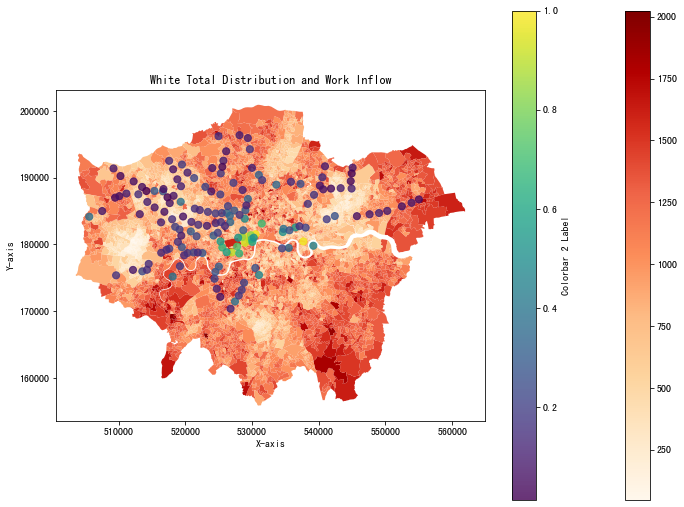

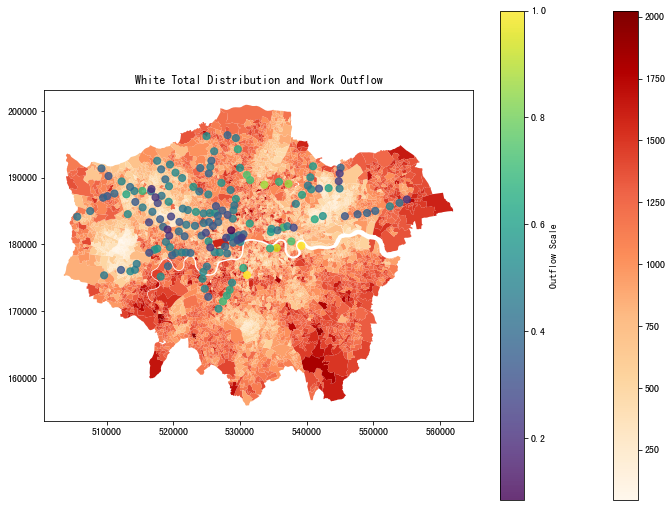

In [927]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]


plot_fsip_inflow(inflow_df, ethnic_df,'relative_inflow(work)','white_total','White Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, ethnic_df,'relative_outflow(work)','white_total','White Total Distribution and Work Outflow',lines,alphas)


##### Ethnic (Asian)

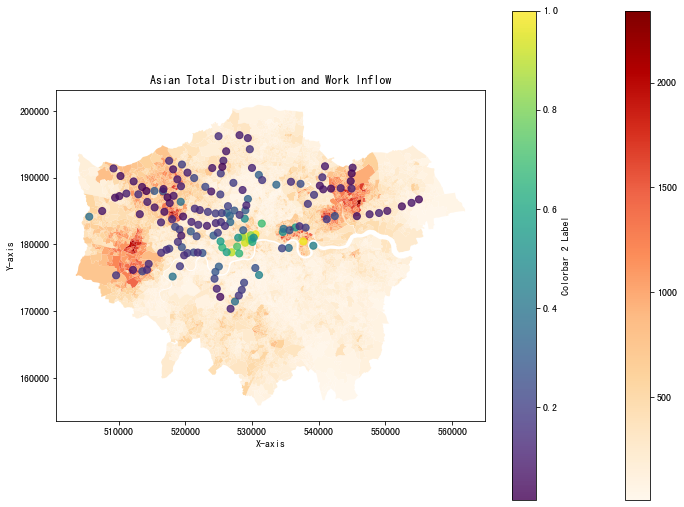

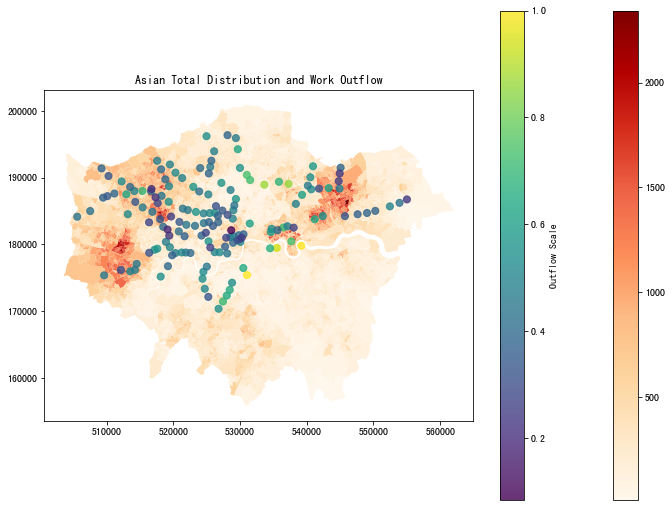

In [876]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]


plot_fsip_inflow(inflow_df, ethnic_df,'relative_inflow(work)','asian_total','Asian Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, ethnic_df,'relative_outflow(work)','asian_total','Asian Total Distribution and Work Outflow',lines,alphas)

In [835]:
fuck = od_matrix_new[od_matrix_new['station_origin'] == 'Canada Water']
# 假设你的DataFrame名为df，需要根据列名为'column_name'的列进行排序
fuck = fuck.sort_values(by='ampeak_flows', ascending=False)
fuck.head(30)

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
6403,788,Canada Water,852,Canary Wharf,548,4751,2023,1184,558,239,...,0.354124,29.096902,45.798127,0.635330,2.835293,3.987372,0.711068,15.666147,22.521573,0.695606
6397,788,Canada Water,524,Bond Street,105,1533,974,429,181,0,...,0.338361,29.096902,38.975502,0.746543,2.835293,3.519879,0.805509,15.666147,22.349188,0.700972
6426,788,Canada Water,590,Green Park,267,1331,629,290,107,34,...,0.338461,29.096902,43.463635,0.669454,2.835293,4.104732,0.690738,15.666147,25.464410,0.615217
6490,788,Canada Water,728,Tottenham Court Road,63,472,325,106,0,0,...,0.338189,29.096902,38.743370,0.751016,2.835293,3.546020,0.799570,15.666147,21.872125,0.716261
6465,788,Canada Water,669,Oxford Circus,28,432,317,121,33,0,...,0.338091,29.096902,46.786058,0.621914,2.835293,4.419400,0.641556,15.666147,27.333197,0.573155
6391,788,Canada Water,507,Angel,11,362,246,67,40,14,...,0.352052,29.096902,32.207660,0.903416,2.835293,2.767077,1.024652,15.666147,17.476667,0.896404
6480,788,Canada Water,708,South Kensington,21,361,211,0,0,0,...,0.337469,29.096902,41.979099,0.693128,2.835293,3.868176,0.732979,15.666147,23.268750,0.673270
6459,788,Canada Water,789,North Greenwich,67,319,355,473,403,144,...,0.352529,29.096902,20.719564,1.404320,2.835293,1.619656,1.750552,15.666147,9.878305,1.585915
6469,788,Canada Water,674,Piccadilly Circus,10,290,205,102,0,0,...,0.337382,29.096902,41.975525,0.693187,2.835293,3.695687,0.767190,15.666147,23.878899,0.656067
6449,788,Canada Water,626,Knightsbridge,13,279,268,0,0,0,...,0.337045,29.096902,33.830178,0.860087,2.835293,2.884534,0.982929,15.666147,19.144071,0.818329


##### Ethnic (Black)

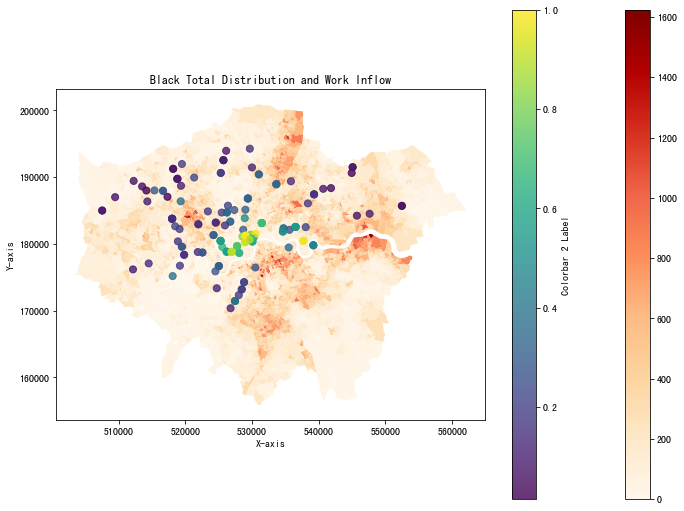

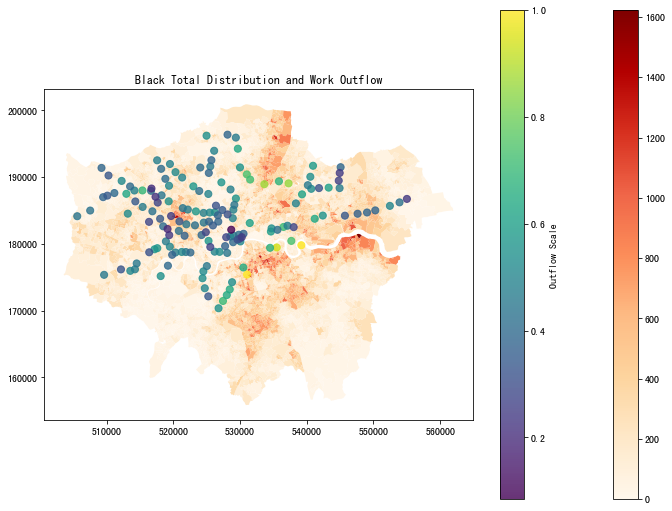

In [815]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]

plot_fsip_inflow(outflow_df, ethnic_df,'relative_inflow(work)','black_total','Black Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, ethnic_df,'relative_outflow(work)','black_total','Black Total Distribution and Work Outflow',lines,alphas)

##### Age(Young)

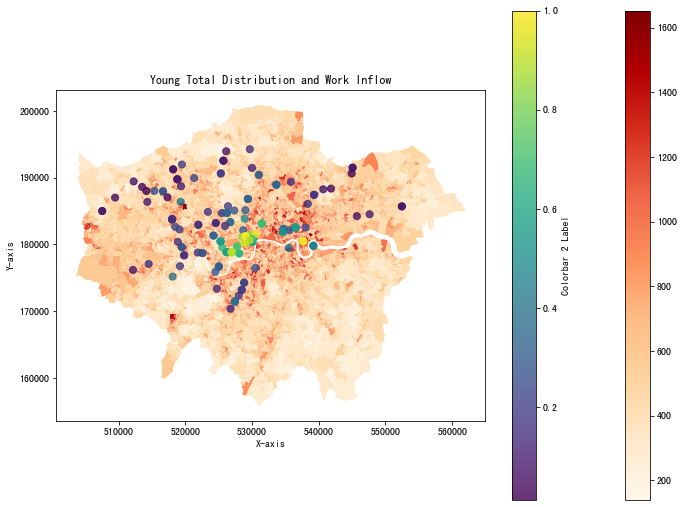

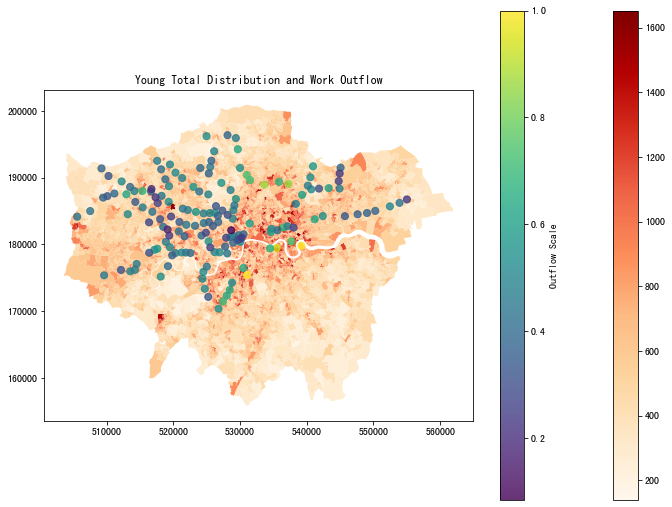

In [877]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]

plot_fsip_inflow(outflow_df, age_df,'relative_inflow(work)','young_age','Young Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, age_df,'relative_outflow(work)','young_age','Young Total Distribution and Work Outflow',lines,alphas)

##### Age(Old)

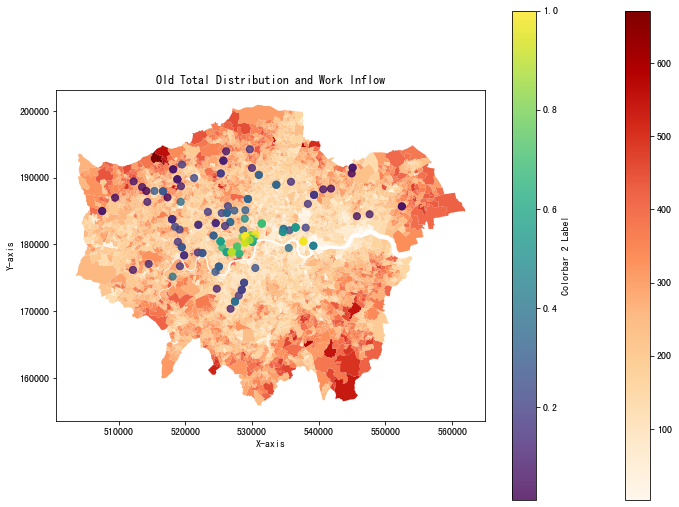

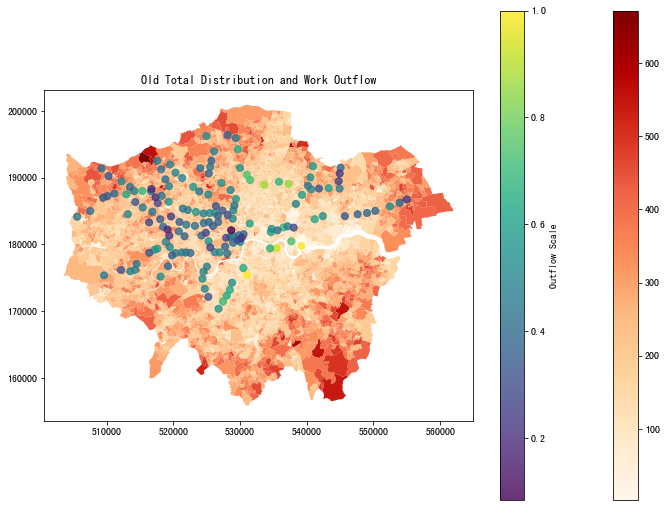

In [878]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]

plot_fsip_inflow(outflow_df, age_df,'relative_inflow(work)','old_age','Old Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, age_df,'relative_outflow(work)','old_age','Old Total Distribution and Work Outflow',lines,alphas)

##### House Price

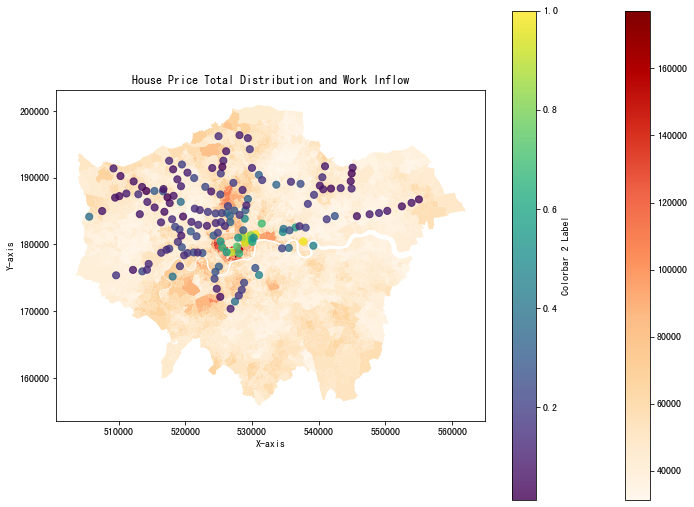

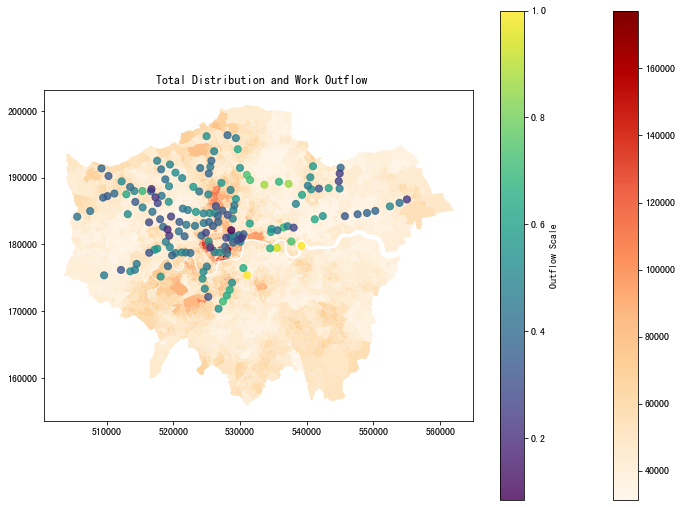

In [879]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]

plot_fsip_inflow(inflow_df, income_df,'relative_inflow(work)','house_pri','House Price Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, income_df,'relative_outflow(work)','house_pri',' Total Distribution and Work Outflow',lines,alphas)

#### To Edu

In [881]:
outflow_sorted_df = od_matrix_new.sort_values(by='relative_outflow(edu)', ascending=False)
# 假设 df 是你的 DataFrame，column_name 是你想根据其唯一值进行筛选的列名
outflow_df = outflow_sorted_df.drop_duplicates(subset=['station_origin'])

inflow_sorted_df = od_matrix_new.sort_values(by='relative_inflow(edu)', ascending=False)
inflow_df = inflow_sorted_df.drop_duplicates(subset=['station_destination'])

outflow_df.reset_index(drop=True, inplace=True)
inflow_df.reset_index(drop=True, inplace=True)

##### Ethnic(White)

In [888]:
outflow_df

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,fsip_ampeak_workandother(relative),relative_outflow(work),relative_inflow(work),place_based_fsip(work),relative_outflow(edu),relative_inflow(edu),place_based_fsip(edu),relative_outflow(other),relative_inflow(other),place_based_fsip(other)
0,778,Brixton,769,Woodford,0,0,0,0,0,51,...,NaN,31.052347,3.736692,0.000000,3.203100,0.295151,0.000000,19.916147,1.924895,0.000000
1,788,Canada Water,678,Putney Bridge,0,32,67,0,0,0,...,0.317003,29.096902,13.184606,2.206884,2.835293,0.991657,2.859146,15.666147,6.692066,2.341003
2,698,Seven Sisters,584,Golders Green,0,20,0,14,0,0,...,0.317899,26.874125,9.011963,2.982050,2.710400,0.722346,3.752219,13.115144,4.520879,2.901016
3,789,North Greenwich,771,Woodside Park,0,0,0,0,0,4,...,NaN,31.067612,4.741002,0.000000,2.575045,0.334131,0.000000,14.137112,2.158937,0.000000
4,742,Walthamstow Central,766,Willesden Junction,0,0,3,0,0,0,...,NaN,26.566361,6.398273,0.000000,2.343641,0.547021,0.000000,10.556554,3.639423,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153,576,Fairlop,605,High Street Kensington,0,4,5,0,0,0,...,0.282411,7.536080,30.908033,0.243823,0.415669,2.604973,0.159568,2.958910,16.980850,0.174250
154,709,South Kenton,669,Oxford Circus,2,53,11,0,0,0,...,0.306098,6.997896,46.786058,0.149572,0.411271,4.419400,0.093060,2.751567,27.333197,0.100668
155,671,Park Royal,505,Alperton,0,0,0,75,0,0,...,NaN,5.890587,6.733013,0.000000,0.393646,0.406434,0.000000,2.369893,3.226669,0.000000
156,737,Upminster Bridge,582,Gants Hill,0,0,0,6,0,0,...,NaN,7.433509,4.823570,0.000000,0.335317,0.420357,0.000000,3.747889,2.563977,0.000000


In [889]:
outflow_df[['station_origin','relative_outflow(edu)']]

,station_origin,relative_outflow(edu)
0,Brixton,3.203100
1,Canada Water,2.835293
2,Seven Sisters,2.710400
3,North Greenwich,2.575045
4,Walthamstow Central,2.343641
...,...,...
153,Fairlop,0.415669
154,South Kenton,0.411271
155,Park Royal,0.393646
156,Upminster Bridge,0.335317


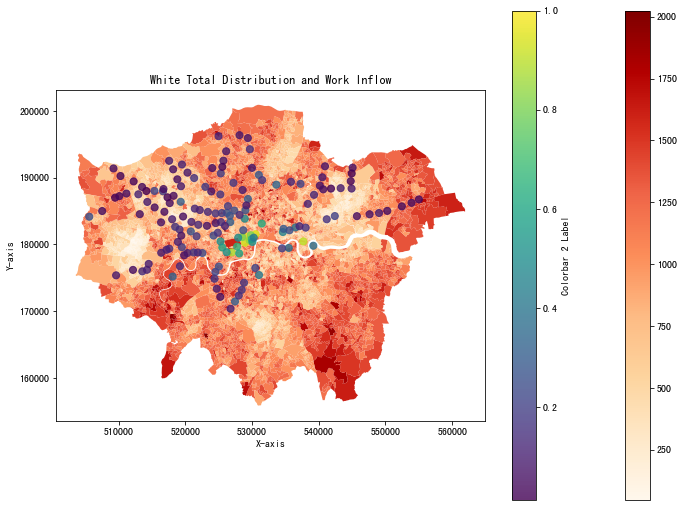

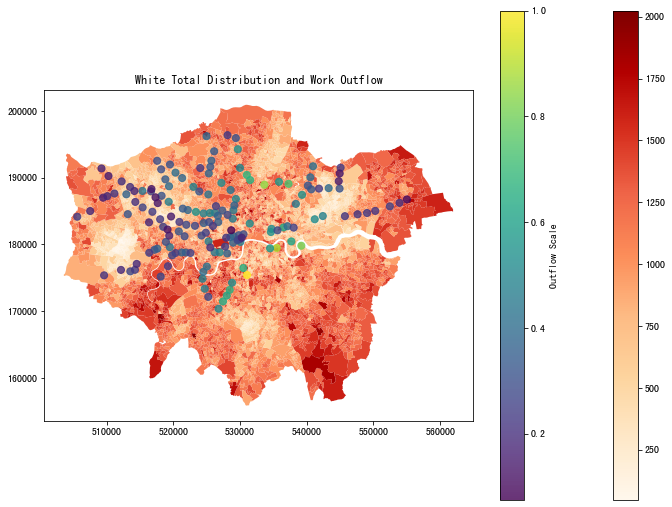

In [890]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(inflow_df, ethnic_df,'relative_inflow(edu)','white_total','White Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, ethnic_df,'relative_outflow(edu)','white_total','White Total Distribution and Work Outflow',lines,alphas)

##### Ethnic(Asian)

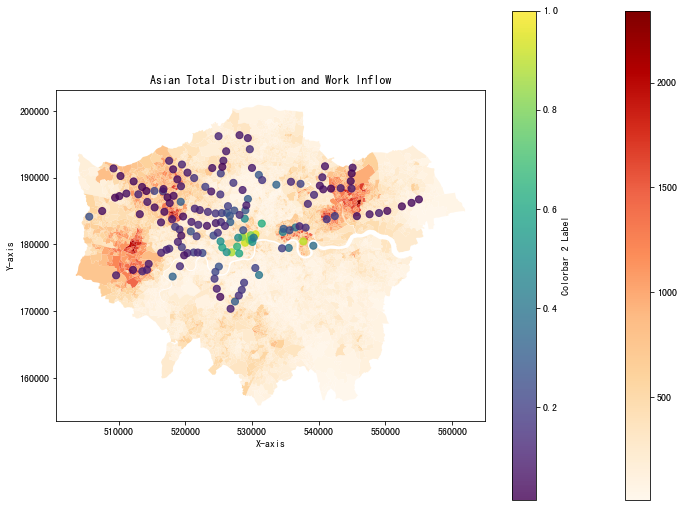

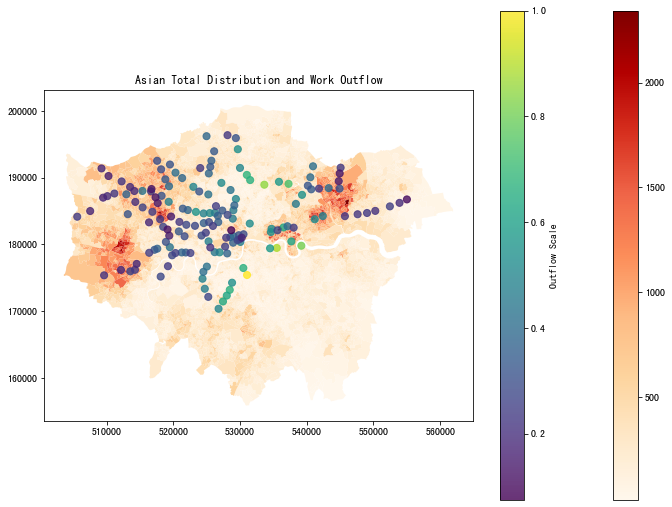

In [892]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(inflow_df, ethnic_df,'relative_inflow(edu)','asian_total','Asian Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, ethnic_df,'relative_outflow(edu)','asian_total','Asian Total Distribution and Work Outflow',lines,alphas)

##### Ethnic(Black)

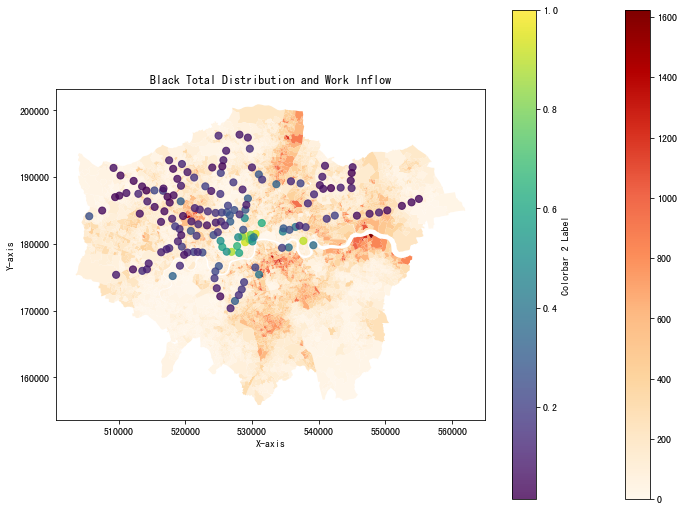

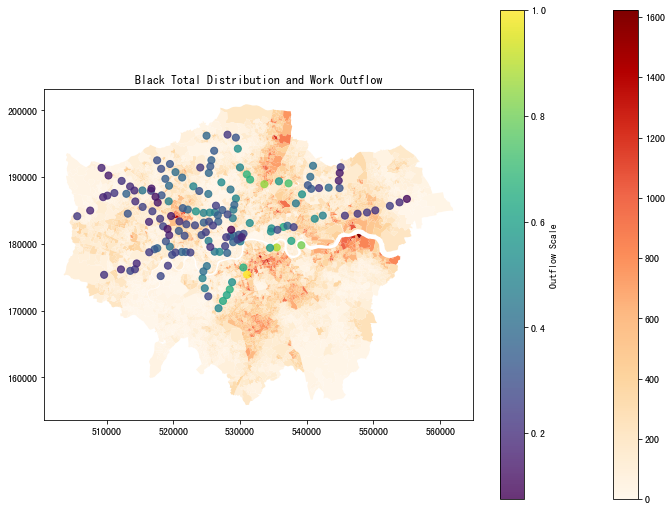

In [893]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(inflow_df, ethnic_df,'relative_inflow(edu)','black_total','Black Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, ethnic_df,'relative_outflow(edu)','black_total','Black Total Distribution and Work Outflow',lines,alphas)

##### Age(Young)

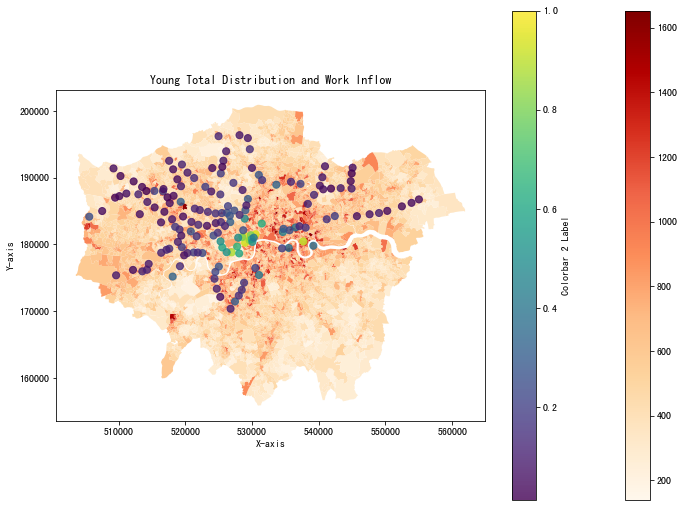

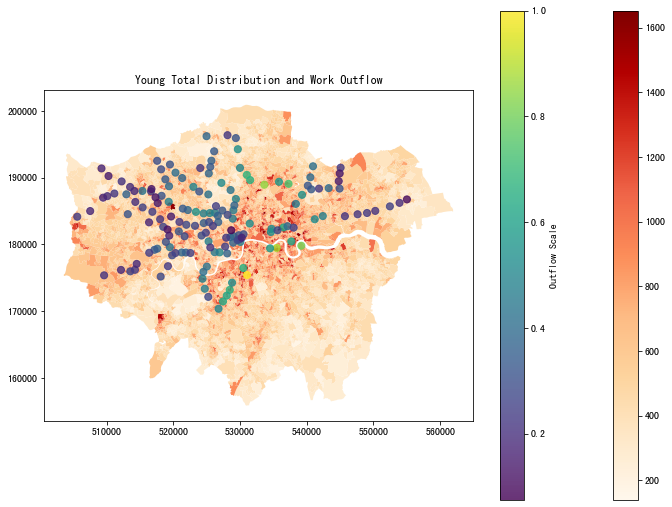

In [895]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(inflow_df, age_df,'relative_inflow(edu)','young_age','Young Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, age_df,'relative_outflow(edu)','young_age','Young Total Distribution and Work Outflow',lines,alphas)

##### Age(Old)

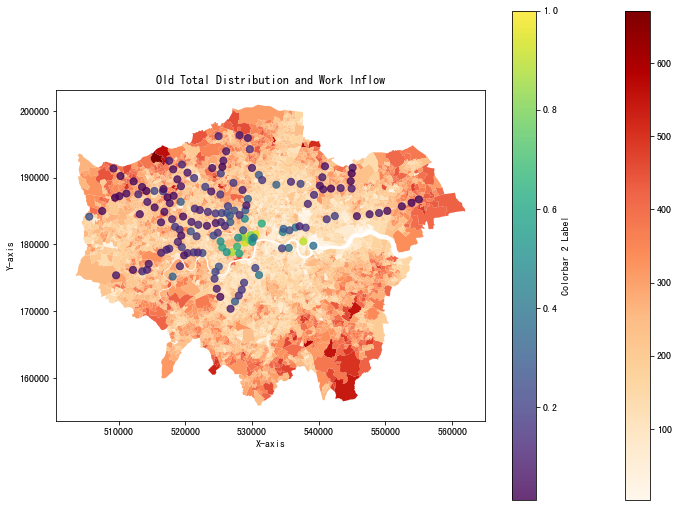

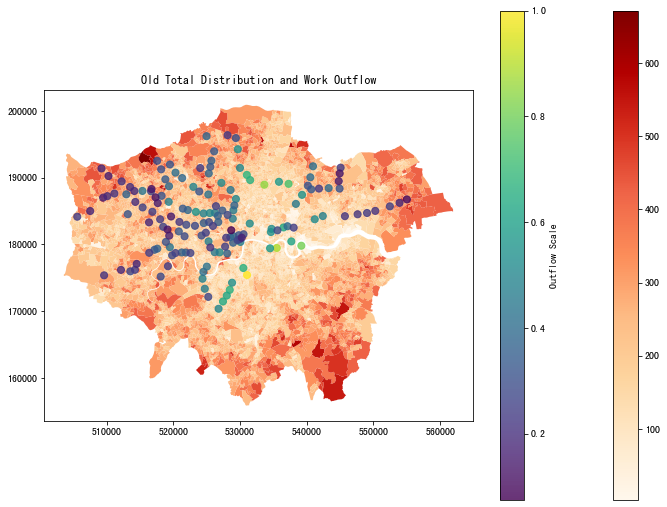

In [896]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(inflow_df, age_df,'relative_inflow(edu)','old_age','Old Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, age_df,'relative_outflow(edu)','old_age','Old Total Distribution and Work Outflow',lines,alphas)

##### House Price

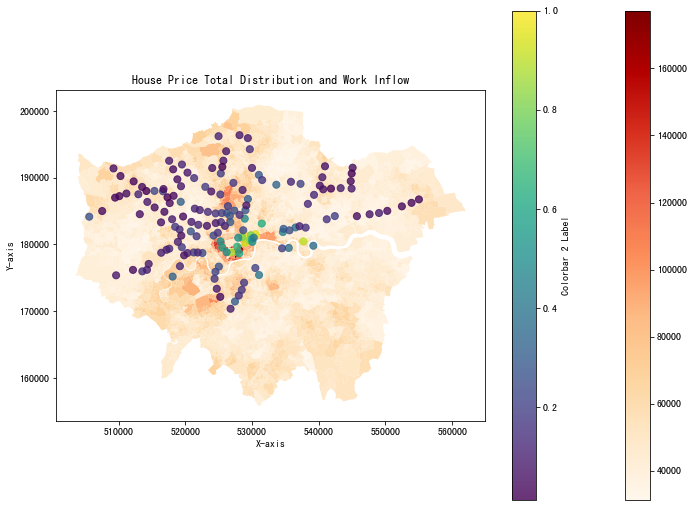

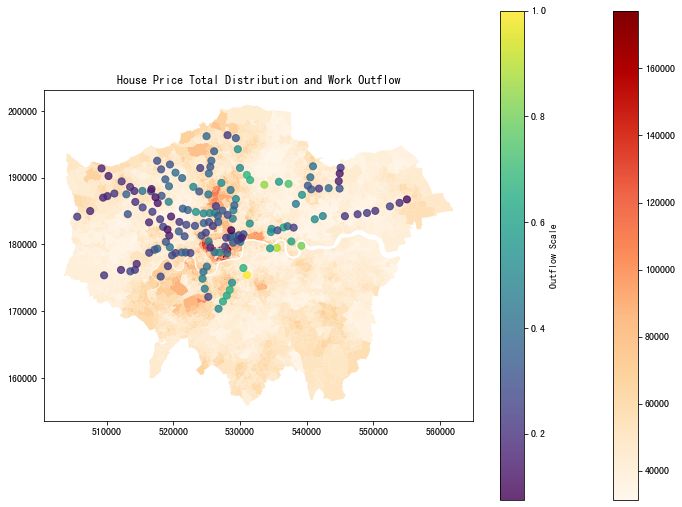

In [897]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(inflow_df, income_df,'relative_inflow(edu)','house_pri','House Price Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, income_df,'relative_outflow(edu)','house_pri','House Price Total Distribution and Work Outflow',lines,alphas)

#### To Other

In [902]:
outflow_sorted_df = od_matrix_new.sort_values(by='relative_outflow(other)', ascending=False)
# 假设 df 是你的 DataFrame，column_name 是你想根据其唯一值进行筛选的列名
outflow_df = outflow_sorted_df.drop_duplicates(subset=['station_origin'])

inflow_sorted_df = od_matrix_new.sort_values(by='relative_inflow(other)', ascending=False)
inflow_df = inflow_sorted_df.drop_duplicates(subset=['station_destination'])

outflow_df.reset_index(drop=True, inplace=True)
inflow_df.reset_index(drop=True, inplace=True)

##### Ethnic(White)

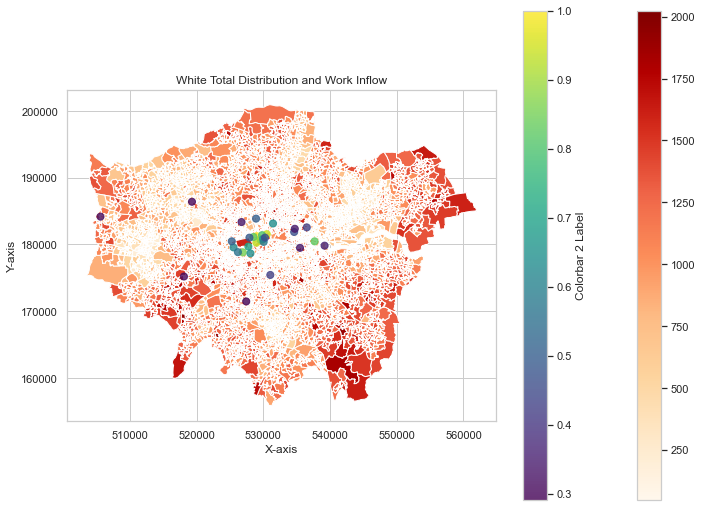

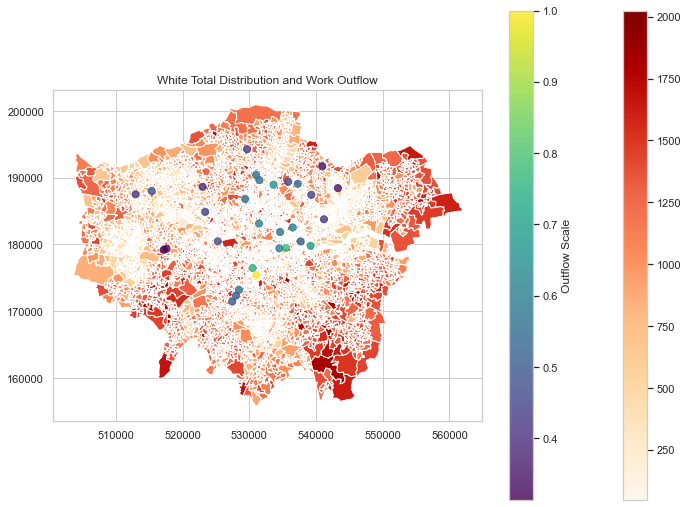

In [1783]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(work_inflow_df, ethnic_df,'relative_inflow(other)','white_total','White Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(work_outflow_df, ethnic_df,'relative_outflow(other)','white_total','White Total Distribution and Work Outflow',lines,alphas)

##### Ethnic(Asian)

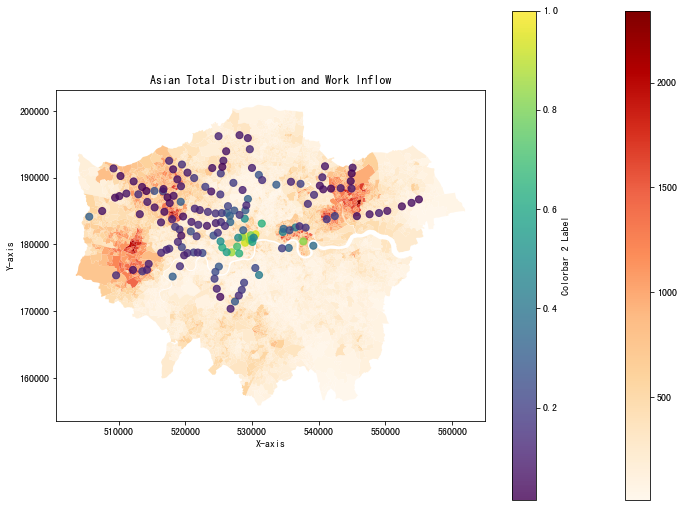

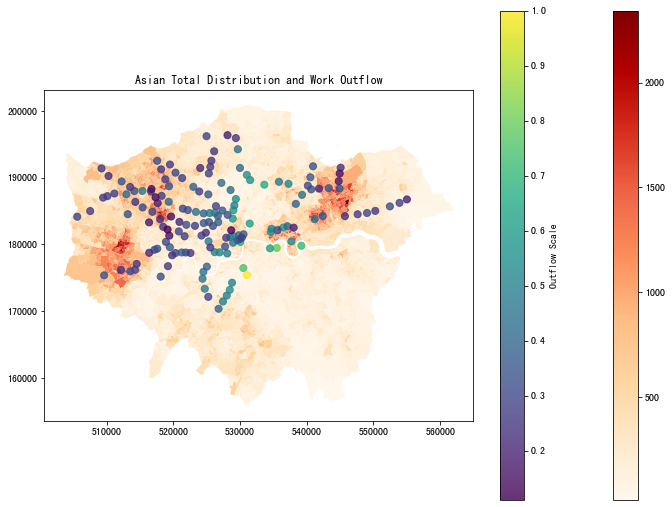

In [907]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(inflow_df, ethnic_df,'relative_inflow(other)','asian_total','Asian Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, ethnic_df,'relative_outflow(other)','asian_total','Asian Total Distribution and Work Outflow',lines,alphas)

##### Ethnic(Black)

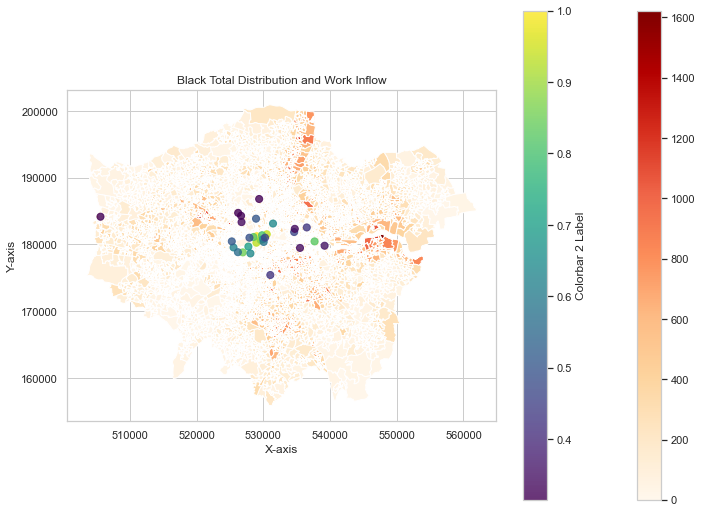

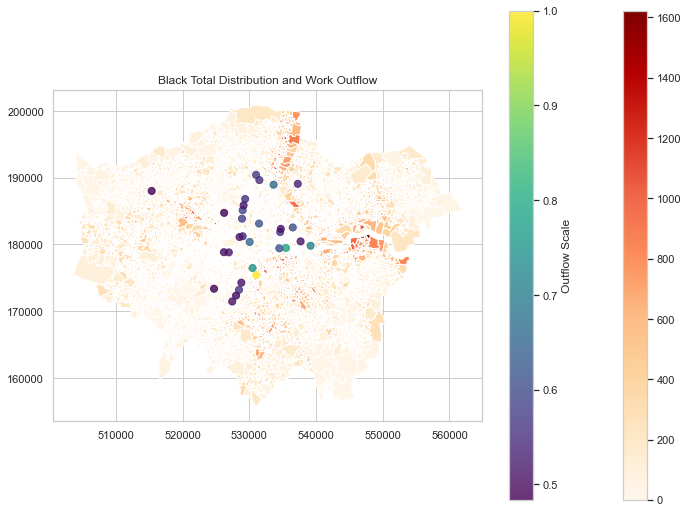

In [1781]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(other_inflow_df, ethnic_df,'relative_inflow(other)','black_total','Black Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(other_outflow_df, ethnic_df,'relative_outflow(other)','black_total','Black Total Distribution and Work Outflow',lines,alphas)

##### Age(Young)

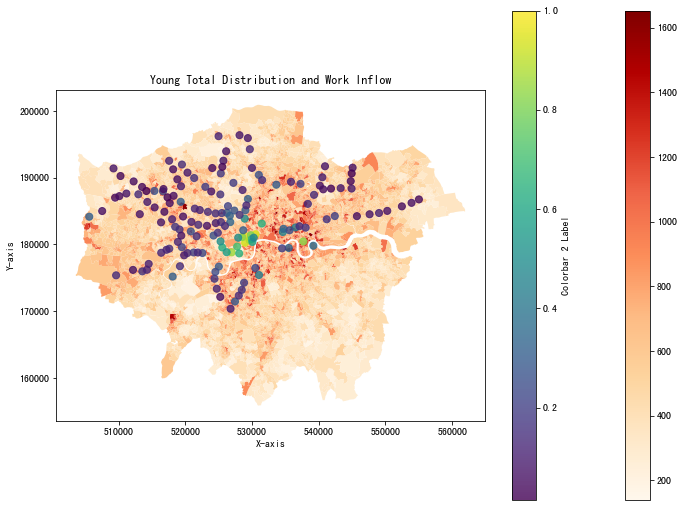

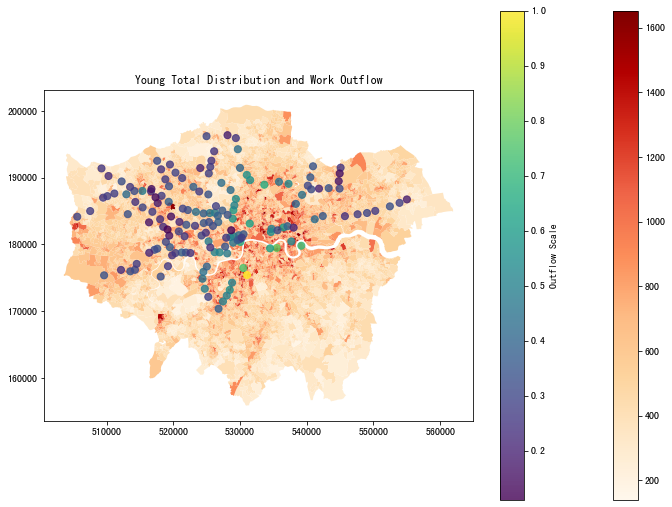

In [909]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(inflow_df, age_df,'relative_inflow(other)','young_age','Young Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, age_df,'relative_outflow(other)','young_age','Young Total Distribution and Work Outflow',lines,alphas)

##### Age(Old)

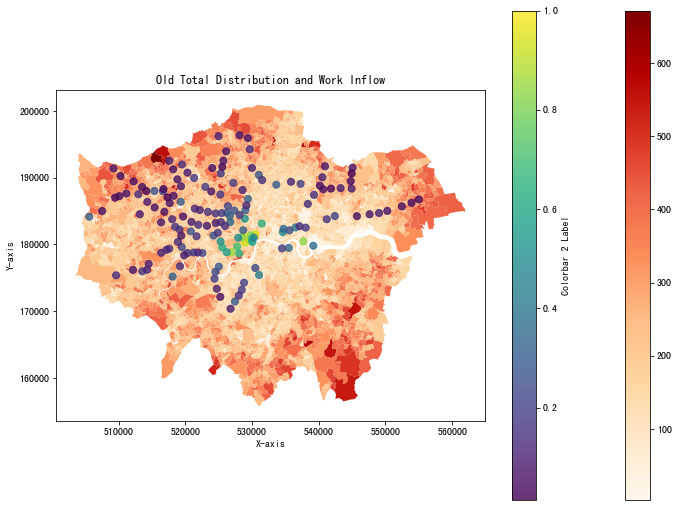

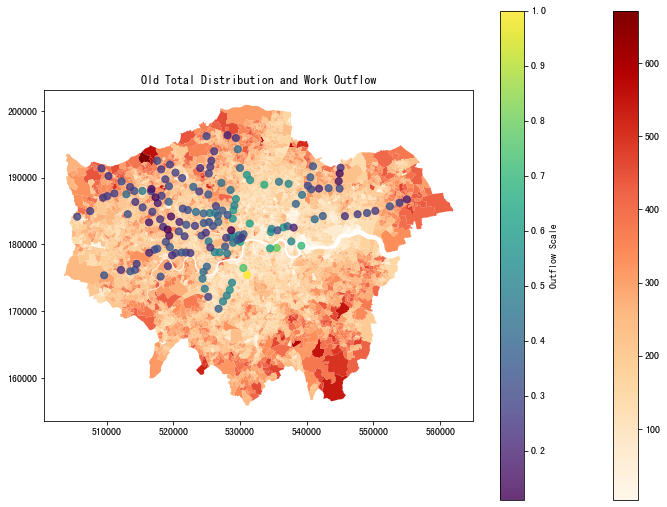

In [910]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(inflow_df, age_df,'relative_inflow(other)','old_age','Old Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, age_df,'relative_outflow(other)','old_age','Old Total Distribution and Work Outflow',lines,alphas)

##### House Price

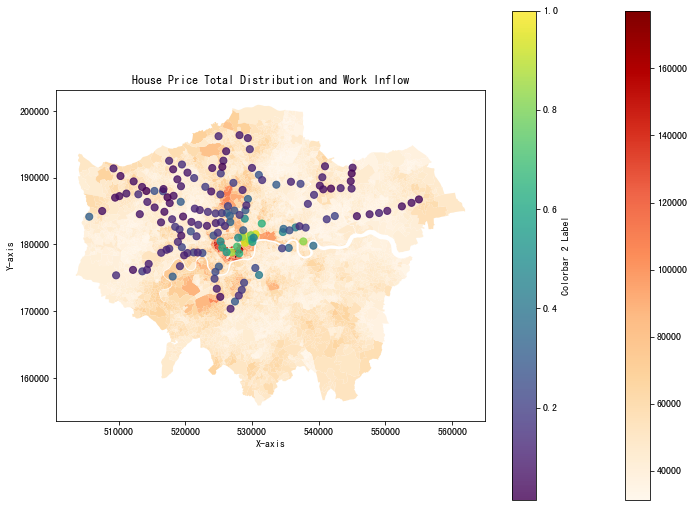

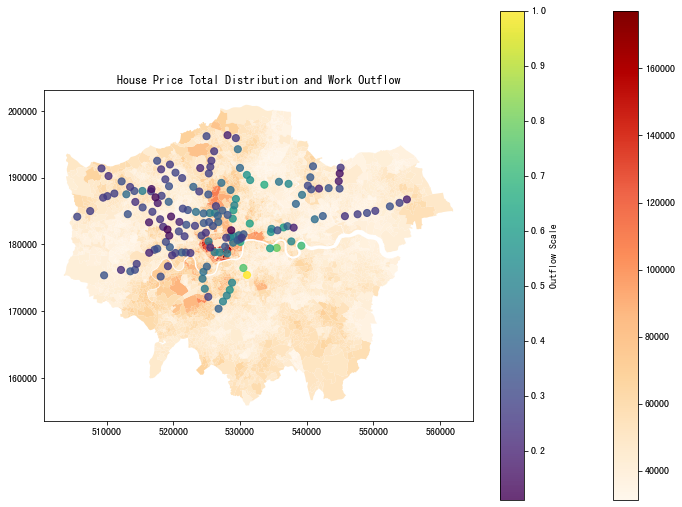

In [911]:
alphas = [1, 1, 1.0, 1.0]
lines = [1.0, 1.0, 1.0, 1.0]
#lines = [0.5, 0.5, 0.5, 0.5]
plot_fsip_inflow(inflow_df, income_df,'relative_inflow(other)','house_pri','House Price Total Distribution and Work Inflow',lines,alphas)

# To work
plot_fsip_outflow(outflow_df, income_df,'relative_outflow(other)','house_pri','House Price Total Distribution and Work Outflow',lines,alphas)

### Absolute Measures (6 combined images)

In [1441]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
# def odmatrix_vis_echo(ax, od_df, col_name, lines, alphas):
#     for i in range(0,len(od_df)):
#         x1 = [od_df['orig_x'][i],  od_df['dest_x'][i]]
#         y1 = [od_df['orig_y'][i],  od_df['dest_y'][i]]
#         tmp_fsip = od_df[col_name][i]
#         # 绘制线条并设置宽度
#         quan_25 = od_df[col_name].quantile(0.2)
#         quan_50 = od_df[col_name].quantile(0.5)
#         quan_75 = od_df[col_name].quantile(0.8)
#         quan_100 = max(od_df[col_name])


#         #print(fsip_ampeak_workandedu, max(od_matrix_cleaned["place_based_fsip(other)"]))
#         if(quan_75 < tmp_fsip <= quan_100):
#             ax.plot(x1, y1, linewidth=tmp_fsip / max(od_df[col_name])*lines[0], color='Blue',alpha=alphas[0])

#         elif(quan_50 < tmp_fsip <= quan_75):
#             ax.plot(x1, y1, linewidth=(tmp_fsip / max(od_df[col_name]))*lines[1], color="Green",alpha=alphas[1])

#         elif(quan_25 < tmp_fsip <= quan_50):
#             ax.plot(x1, y1, linewidth=(tmp_fsip / max(od_df[col_name]))*lines[2], color="Red",alpha=alphas[2])

#         elif(tmp_fsip <= quan_25):
#             ax.plot(x1, y1, linewidth=(tmp_fsip / max(od_df[col_name]))*lines[3], color="magenta",alpha=alphas[3])
def odmatrix_vis_echo(ax, od_df, col_name, lines, alphas):
    cmap = plt.get_cmap('coolwarm')  # 选择颜色映射
    norm = mcolors.Normalize(vmin=0, vmax=max(od_df[col_name]))  # 根据数据范围设置归一化

    for i in range(0, len(od_df)):
        x1 = [od_df['orig_x'][i], od_df['dest_x'][i]]
        y1 = [od_df['orig_y'][i], od_df['dest_y'][i]]
        tmp_fsip = od_df[col_name][i]
        #if(int(tmp_fsip) == 0): continue

        # 根据数据大小获取颜色
        color = cmap(norm(tmp_fsip))
#         print(tmp_fsip)
#         print(max(od_df[col_name]))
#         print(int(tmp_fsip / max(od_df[col_name])))
#         print((int(tmp_fsip) / int(max(od_df[col_name])) * lines))
        #tmp_fsip = int(tmp_fsip)
        
        # 绘制线条并设置宽度
        tmp_linewidth = 0.1
        tmp_alpha = 0.1
        if(tmp_fsip<5): 
            continue
        if(tmp_fsip>od_df[col_name].quantile(0.999)): tmp_linewidth,tmp_alpha = 5.0, 1.0
        elif(od_df[col_name].quantile(0.999)>tmp_fsip>od_df[col_name].quantile(0.995)): tmp_linewidth,tmp_alpha = 0.3, 0.6
        elif(od_df[col_name].quantile(0.995) >tmp_fsip>od_df[col_name].quantile(0.95)): tmp_linewidth,tmp_alpha = 0.1, 0.2
        ax.plot(x1, y1, linewidth=tmp_linewidth, color=color, alpha=tmp_alpha)

    # 创建颜色条
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])  # 不设置实际数据范围
    cbar = plt.colorbar(sm, ax=ax, orientation='vertical')
    cbar.set_label(col_name, rotation=270, labelpad=15)

In [ ]:
def plot_fsip(df_fsip, df_demo, col_fsip, col_demo,tittle,lines, alphas):
    ax = df_demo.plot(column=col_demo, cmap='OrRd', legend=True, figsize=(12,9))
    ax.set_title(tittle)
    
    odmatrix_vis(df_fsip,col_fsip, lines, alphas)
    
    plt.show()

In [1397]:
od_matrix_new[od_matrix_new['fsip_2work']>50]

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,relative_outflow(workandedu),relative_inflow(workandedu),place_based_fsip(workandedu),relative_outflow(eduandother),relative_inflow(eduandother),place_based_fsip(eduandother),relative_outflow(workandother),relative_inflow(workandother),place_based_fsip(workandother),relative_inflow_net(work)
38,500,Acton Town,655,Northfields,50,177,4,30,0,0,...,9.342471,3.477758,2.686349,6.326567,2.362223,2.678227,21.455004,9.034500,2.374786,9.382273
322,653,North Acton,640,Marble Arch,38,241,98,41,0,0,...,7.502993,14.525602,0.516536,5.007008,10.710652,0.467479,17.661286,35.936898,0.491453,-11.466145
330,653,North Acton,669,Oxford Circus,0,153,93,31,0,18,...,7.502993,28.545742,0.262841,5.007008,21.842209,0.229235,17.661286,70.686953,0.249852,-33.618021
721,734,Turnham Green,686,Richmond,60,509,259,105,8,4,...,8.920851,10.452002,0.853506,6.072309,7.080330,0.857631,22.049079,25.432517,0.866964,-2.591419
787,520,Bethnal Green,524,Bond Street,56,240,264,86,0,0,...,10.639799,23.296657,0.456709,8.227051,17.641470,0.466347,26.054496,58.386498,0.446242,-22.195827
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10636,789,North Greenwich,626,Knightsbridge,24,88,61,34,0,0,...,18.044475,19.661849,0.917741,12.069006,14.810394,0.814901,42.175344,50.366500,0.837369,-2.762566
10653,789,North Greenwich,669,Oxford Circus,33,149,103,48,0,0,...,18.044475,28.545742,0.632125,12.069006,21.842209,0.552554,42.175344,70.686953,0.596650,-15.718446
10655,789,North Greenwich,674,Piccadilly Circus,16,75,75,41,0,0,...,18.044475,24.760216,0.728769,12.069006,18.659710,0.646795,42.175344,62.420691,0.675663,-10.907913
10669,789,North Greenwich,708,South Kensington,28,99,63,30,13,0,...,18.044475,25.269005,0.714095,12.069006,18.898951,0.638607,42.175344,61.893233,0.681421,-10.911487


In [1400]:
od_matrix_new['fsip_2work'].quantile(0.95)

56.50069620457177

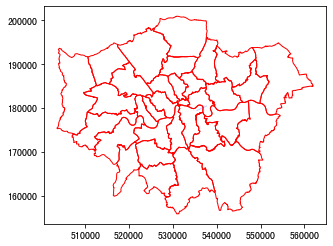

In [979]:
alphas = [0.2, 0.2, 0.2, 0.2]
lines = [1.0, 1.0, 10.0, 10.0]


London.plot(facecolor='None', edgecolor='r')
odmatrix_vis(test_od, 'fsip_2work', lines, alphas)
plt.savefig('test.pdf')
plt.show()

In [1267]:
od_matrix_new
# 按照'Salary'列进行升序排序
sorted_df = od_matrix_new.sort_values(by='fsip_2work')
sorted_df = sorted_df[['station_origin','station_destination','fsip_2work']]

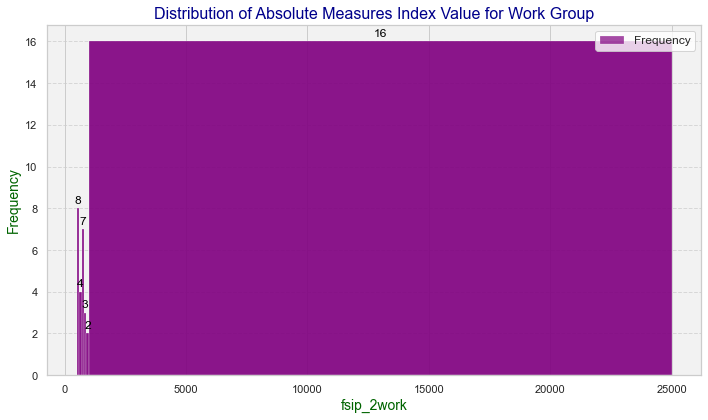

In [1618]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# 假设您有一个名为 df 的DataFrame，要绘制其中的一列 'column_name' 的直方图
column_name = 'fsip_2work'

# 设置风格
sns.set(style='whitegrid')
plt.figure(figsize=(10, 6))  # 设置图的大小

# 自定义 x 坐标范围和间隔
custom_bins = [ 500, 600,700, 800, 900, 1000,25000]  # 设置区间边界

# 绘制直方图，指定自定义的 bin 边界
sns.histplot(data=od_matrix_new, x=column_name, bins=custom_bins, color='purple', alpha=0.7)

# 添加标题和标签，并设置字体大小和颜色
plt.title('Distribution of Absolute Measures Index Value for Work Group', fontsize=16, color='darkblue')
plt.xlabel(column_name, fontsize=14, color='darkgreen')
plt.ylabel('Frequency', fontsize=14, color='darkgreen')

# 获取直方图数据
ax = sns.histplot(data=od_matrix_new, x=column_name, bins=custom_bins, color='purple', alpha=0.7)

# 使用 numpy 的 histogram 函数计算每个区间内的值的个数
hist, edges = np.histogram(od_matrix_new[column_name], bins=custom_bins)
for rect, edge, h in zip(ax.patches, edges, hist):
    height = rect.get_height()
    ax.annotate(f'{int(height)}', xy=(rect.get_x() + rect.get_width() / 2, height), 
                xytext=(0, 3), textcoords='offset points', ha='center', va='bottom', color='black', fontsize=12)

# 添加背景颜色渐变效果
ax.set_facecolor('#f2f2f2')
ax.grid(axis='y', linestyle='--', alpha=0.7)

# 显示图例
plt.legend(['Frequency'], loc='upper right', fontsize=12)

# 显示直方图
plt.tight_layout()
plt.show()


In [1665]:
?plt.pie

/var/folders/21/l9ygcw6d6w39m02vcn2t_j6r0000gn/T/ipykernel_72051/283479670.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  od_matrix_new['bin'] = pd.cut(od_matrix_new['fsip_2work'], bins=bins)


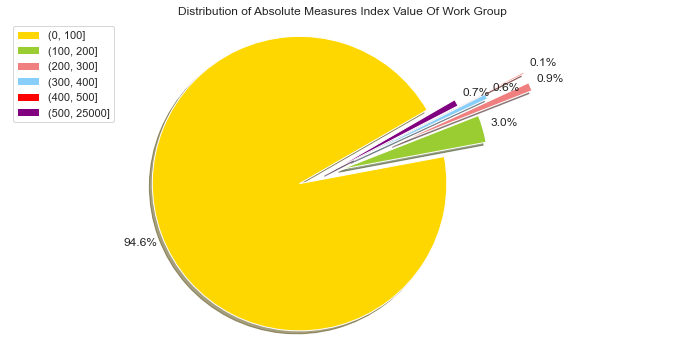

In [1682]:
import pandas as pd
import matplotlib.pyplot as plt

# 假设您有一个名为 df 的DataFrame，要绘制其中的一列 'column_name' 的分布区间饼图
column_name = 'fsip_2work'
colors_list = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue', 'red', 'purple']
explode_list = [0.2, 0.1, 0.5, 0.2, 0.5, 0] # ratio for each continent with which to offset each wedge.
# 划分值的区间
bins = [0, 100, 200, 300, 400, 500, 25000]

# 使用 cut 函数将列的值分为不同的区间
od_matrix_new['bin'] = pd.cut(od_matrix_new['fsip_2work'], bins=bins)

# 统计每个区间内的值的数量
bin_counts = od_matrix_new['bin'].value_counts().sort_index()

# 创建饼图
plt.figure(figsize=(12, 6))
plt.pie(bin_counts, labels=None, autopct='%1.1f%%', labeldistance=1.6, shadow=True, pctdistance=1.15, startangle=30, colors=colors_list,explode=explode_list)

# 添加标题
plt.title('Distribution of Absolute Measures Index Value Of Work Group')

# 显示图例
plt.legend(labels=bin_counts.index, loc='upper left')

# 显示饼图
plt.axis('equal')  # 让饼图呈现圆形
plt.savefig('absolute_measures_pie.pdf')
plt.show()


# colors_list = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue']
# explode_list = [0.1, 0, 0, 0] # ratio for each continent with which to offset each wedge.

# df['Job Acedemic Requiremnt(eng)'].value_counts().plot(kind='pie',
#                             figsize=(15, 6),
#                             autopct='%1.1f%%', 
#                             startangle=90,    
#                             shadow=True,       
#                             labels=None,         # turn off labels on pie chart
#                             pctdistance=1.12,    # the ratio between the center of each pie slice and the start of the text generated by autopct 
#                             colors=colors_list,  # add custom colors
#                             explode=explode_list # 'explode' lowest 3 continents
#                             )

# # scale the title up by 12% to match pctdistance
# plt.title('Job Acedemic Requirement Distribution', y=1.12) 

# plt.axis('equal') 

# # add legend
# plt.legend(labels=df['Job Acedemic Requiremnt(eng)'].value_counts().index, loc='upper left') 

# plt.show()

In [1574]:
#od_matrix_new[od_matrix_new['fsip_ampeak_eduandother'] > 2000]

sorted_df = od_matrix_new.sort_values(by='fsip_2work',ascending=False)
sorted_df[['station_origin','station_destination','fsip_2work']].head(20)
# 删除前20行数据
# sorted_df = sorted_df.drop(sorted_df.index[:20])
# sorted_df.reset_index(drop=True, inplace=True)

,station_origin,station_destination,fsip_2work
6403,Canada Water,Canary Wharf,21114.598847
976,Canary Wharf,Canada Water,9842.844413
6397,Canada Water,Bond Street,4063.581308
6426,Canada Water,Green Park,3745.001236
7901,Brixton,Oxford Circus,3606.678330
2890,Charing Cross,Oxford Circus,2958.147959
10597,North Greenwich,Canary Wharf,2716.653295
1037,Canary Wharf,North Greenwich,2438.051622
1003,Canary Wharf,Green Park,2358.409116
7864,Brixton,Green Park,1926.809882


In [1429]:
sorted_df[['station_origin','station_destination','fsip_2work']].head(10)

,station_origin,station_destination,fsip_2work
3029,Green Park,Oxford Circus,815.194824
6451,Canada Water,Leicester Square,792.015487
6396,Canada Water,Bermondsey,788.101476
10596,North Greenwich,Canada Water,763.160412
6299,Bermondsey,Canary Wharf,735.210800
2894,Charing Cross,Piccadilly Circus,729.376767
1368,Whitechapel,Stepney Green,719.155753
6438,Canada Water,Holborn,700.103180
6449,Canada Water,Knightsbridge,698.170484
6501,Canada Water,Whitechapel,693.380135


In [1440]:
fuck = sorted_df['fsip_2work'].quantile(0.95)
sorted_df[sorted_df['fsip_2work'] > fuck]

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,relative_outflow(workandedu),relative_inflow(workandedu),place_based_fsip(workandedu),relative_outflow(eduandother),relative_inflow(eduandother),place_based_fsip(eduandother),relative_outflow(workandother),relative_inflow(workandother),place_based_fsip(workandother),relative_inflow_net(work)
0,590,Green Park,669,Oxford Circus,0,86,530,333,82,25,...,7.558529,28.545742,0.264787,6.487799,21.842209,0.297030,20.928891,70.686953,0.296079,-34.598004
1,788,Canada Water,631,Leicester Square,19,256,313,266,164,0,...,18.255317,18.736771,0.974304,13.329421,14.214356,0.937744,42.958559,47.006834,0.913879,-2.393901
2,788,Canada Water,787,Bermondsey,0,123,225,264,237,66,...,18.255317,6.018939,3.032979,13.329421,4.331522,3.077306,42.958559,14.764110,2.909661,18.861611
3,789,North Greenwich,788,Canada Water,81,629,306,265,157,243,...,18.044475,10.700590,1.686307,12.069006,7.860499,1.535400,42.175344,25.262063,1.669513,13.805098
4,787,Bermondsey,852,Canary Wharf,161,1007,303,226,90,60,...,12.450929,26.917748,0.462555,9.532279,18.958976,0.502785,32.046301,64.383165,0.497743,-25.093262
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
529,669,Oxford Circus,550,Cockfosters,0,35,76,4,37,0,...,9.056001,2.348719,3.855719,7.621267,1.692859,4.502010,25.695006,6.065067,4.236558,11.000173
530,565,East Finchley,607,Holborn,9,152,29,0,0,0,...,10.775759,27.441461,0.392682,7.551994,20.541297,0.367649,24.524775,67.814661,0.361644,-28.355671
531,607,Holborn,728,Tottenham Court Road,0,8,199,89,0,0,...,6.674772,23.329334,0.286111,5.144168,17.484232,0.294218,18.089716,57.529025,0.314445,-27.072463
532,520,Bethnal Green,663,Notting Hill Gate,12,117,70,33,0,0,...,10.639799,15.368219,0.692325,8.227051,11.154866,0.737530,26.054496,38.145992,0.683021,-9.665500


In [1406]:
# 从DataFrame中随机抽样2条数据
sampled_data = sorted_df.sample(n=1000)
sampled_data.reset_index(drop=True, inplace=True)

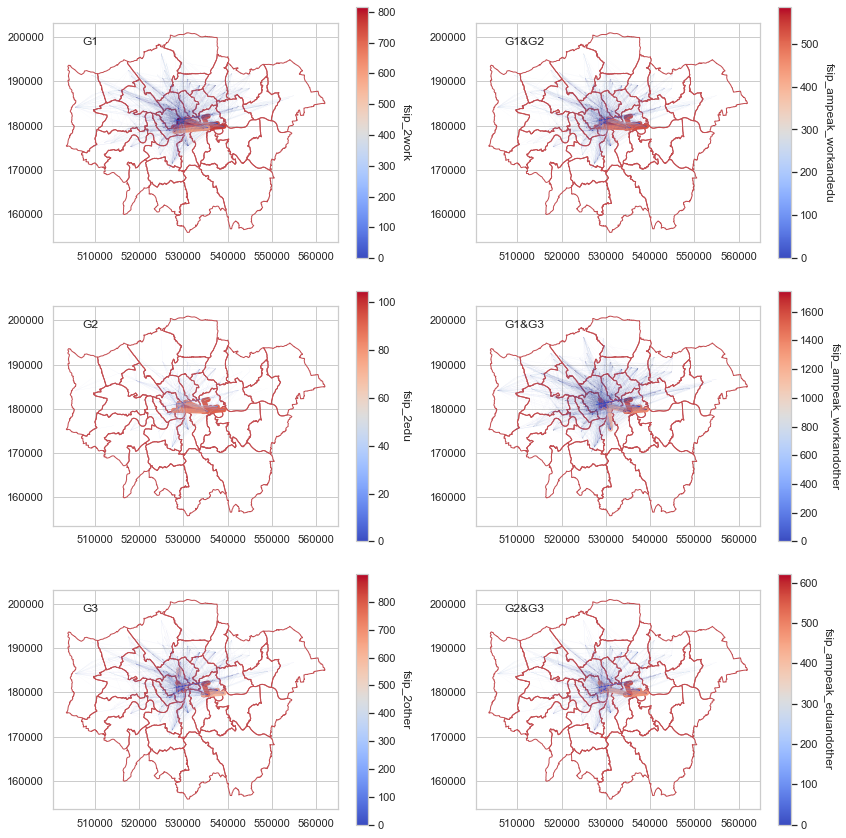

In [1442]:
import matplotlib.pyplot as plt
alphas = [0.2, 0.2, 0.2, 0.2]
lines = [10.0, 10.0, 10.0, 10.0]
# 创建画布和子图
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(12, 12))
plt.subplots_adjust(wspace=0.5, hspace=0.5)

# 在每个子图上绘制地图
London.plot(ax=axs[0, 0], facecolor='None', edgecolor='r')
axs[0, 0].annotate('G1', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[0, 1], facecolor='None', edgecolor='r')
axs[0, 1].annotate('G1&G2', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[1, 0], facecolor='None', edgecolor='r')
axs[1, 0].annotate('G2', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[1, 1], facecolor='None', edgecolor='r')
axs[1, 1].annotate('G1&G3', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[2, 0], facecolor='None', edgecolor='r')
axs[2, 0].annotate('G3', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[2, 1], facecolor='None', edgecolor='r')
axs[2, 1].annotate('G2&G3', xy=(0.1, 0.9), xycoords='axes fraction')



# 在每个子图上绘制线段
odmatrix_vis_echo(axs[0,0], sorted_df, 'fsip_2work', lines, alphas)
odmatrix_vis_echo(axs[0,1], sorted_df, 'fsip_ampeak_workandedu', lines, alphas)
odmatrix_vis_echo(axs[1,0], sorted_df, 'fsip_2edu', lines, alphas)
odmatrix_vis_echo(axs[1,1], sorted_df, 'fsip_ampeak_workandother', lines, alphas)
odmatrix_vis_echo(axs[2,0], sorted_df, 'fsip_2other', lines, alphas)
odmatrix_vis_echo(axs[2,1], sorted_df, 'fsip_ampeak_eduandother', lines, alphas)

# 调整子图之间的间距
plt.tight_layout()
plt.savefig('iwannadie1314159.pdf')
# 显示图形
plt.show()

### Relative Measures (6 combined images)

In [1527]:
tmp_df = od_matrix_new.sort_values(by='fsip_2work(relative)', ascending=False)
tmp_df= tmp_df[:500]
tmp_df['fsip_2work(relative)'].quantile(0.99)

0.2625648147284534

In [1571]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

def odmatrix_vis_relative3(ax, od_df, col_name, lines, alphas):
    cmap = plt.get_cmap('coolwarm')  # 选择颜色映射
    
    tmp_df = od_df.sort_values(by=col_name, ascending=False)
    tmp_df.reset_index(drop=True, inplace=True)
    
    
     # 设置抽样范围和步长
    start = 0
    end = 10000
    step = 1000
    sample_size = 200

    # 初始化一个空的DataFrame来存放抽样结果
    sampled_df = pd.DataFrame()

    # 进行抽样并存入sampled_df
    for i in range(start, end, step):
        sample = tmp_df.iloc[i:i+sample_size]
        sampled_df = pd.concat([sampled_df, sample])

    tmp_df = sampled_df
    tmp_df.reset_index(drop=True, inplace=True)

    norm = mcolors.Normalize(vmin=0, vmax=max(tmp_df[col_name]))  # 根据数据范围设置归一化
    
    for i in range(0, len(tmp_df)):
        x1 = [tmp_df['orig_x'][i], tmp_df['dest_x'][i]]
        y1 = [tmp_df['orig_y'][i], tmp_df['dest_y'][i]]
        tmp_fsip = tmp_df[col_name][i]
        #if(int(tmp_fsip) == 0): continue

        # 根据数据大小获取颜色
        color = cmap(norm(tmp_fsip))
#         print(tmp_fsip)
#         print(max(od_df[col_name]))
#         print(int(tmp_fsip / max(od_df[col_name])))
#         print((int(tmp_fsip) / int(max(od_df[col_name])) * lines))
        #tmp_fsip = int(tmp_fsip)
        
        # 绘制线条并设置宽度
        tmp_linewidth = 1
        tmp_alpha = 1

#         if(col_name=='fsip_2work(relative)' and tmp_fsip<0.10): continue
#         if(col_name=='fsip_2edu(relative)' and tmp_fsip<0.01): continue
#         if(col_name=='fsip_2other(relative)' and tmp_fsip<0.05): continue
#         if(col_name=='fsip_ampeak_workandedu(relative)' and tmp_fsip<0.025): continue
#         if(col_name=='fsip_ampeak_workandother(relative)' and tmp_fsip<0.10): continue
#         if(col_name=='fsip_ampeak_eduandother(relative)' and tmp_fsip<0.02): continue

        if(tmp_fsip>tmp_df[col_name].quantile(0.99)): tmp_linewidth,tmp_alpha = 1.5, 1
        elif(tmp_df[col_name].quantile(0.99)>=tmp_fsip>tmp_df[col_name].quantile(0.95)): tmp_linewidth,tmp_alpha = 0.8, 0.8            
        elif(tmp_df[col_name].quantile(0.95)>=tmp_fsip>tmp_df[col_name].quantile(0.90)): tmp_linewidth,tmp_alpha = 0.6, 0.6
        elif(tmp_df[col_name].quantile(0.90)>=tmp_fsip>tmp_df[col_name].quantile(0.85)): tmp_linewidth,tmp_alpha = 0.4, 0.4            
        else: continue
        ax.plot(x1, y1, linewidth=tmp_linewidth, color=color, alpha=tmp_alpha)

    # 创建颜色条
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])  # 不设置实际数据范围
    cbar = plt.colorbar(sm, ax=ax, orientation='vertical')
    cbar.set_label(col_name, rotation=270, labelpad=15)  

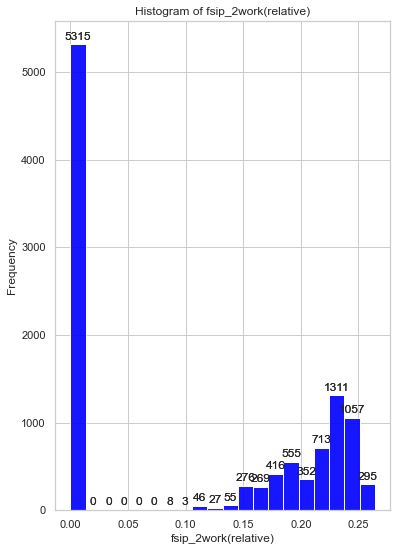

In [1492]:
import seaborn as sns
import matplotlib.pyplot as plt

# 假设您有一个名为 df 的DataFrame，要绘制其中的一列 'column_name' 的直方图
column_name = 'fsip_2work(relative)'

# 设置风格
sns.set(style='whitegrid')

# 绘制直方图
sns.histplot(data=od_matrix_new, x=column_name, bins=20, color='blue', alpha=0.7)

# 添加标题和标签
plt.title('Histogram of ' + column_name)
plt.xlabel(column_name)
plt.ylabel('Frequency')

# 获取直方图数据
ax = sns.histplot(data=od_matrix_new, x=column_name, bins=20, color='blue', alpha=0.7)
for rect in ax.patches:
    height = rect.get_height()
    ax.annotate(f'{int(height)}', xy=(rect.get_x() + rect.get_width() / 2, height), 
                xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')

# 显示直方图
plt.show()

In [1452]:
od_matrix_new[od_matrix_new['fsip_2work(relative)']>0.01]

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,relative_outflow(workandedu),relative_inflow(workandedu),place_based_fsip(workandedu),relative_outflow(eduandother),relative_inflow(eduandother),place_based_fsip(eduandother),relative_outflow(workandother),relative_inflow(workandother),place_based_fsip(workandother),relative_inflow_net(work)
0,500,Acton Town,505,Alperton,0,50,0,99,0,0,...,9.342471,3.411165,2.738792,6.326567,2.304111,2.745773,21.455004,9.416650,2.278412,9.069138
1,500,Acton Town,507,Angel,1,10,2,0,3,0,...,9.342471,18.791078,0.497176,6.326567,13.815537,0.457931,21.455004,46.859360,0.457860,-16.405509
7,500,Acton Town,526,Boston Manor,0,39,0,36,0,0,...,9.342471,3.491198,2.676008,6.326567,2.419759,2.614545,21.455004,9.328944,2.299832,9.258687
9,500,Acton Town,778,Brixton,4,12,12,8,0,5,...,9.342471,12.345571,0.756747,6.326567,9.078305,0.696889,21.455004,31.206019,0.687528,-5.569046
12,500,Acton Town,852,Canary Wharf,22,35,25,0,0,0,...,9.342471,26.917748,0.347075,6.326567,18.958976,0.333698,21.455004,64.383165,0.333239,-29.995976
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10688,789,North Greenwich,753,West Acton,6,16,0,0,0,0,...,18.044475,2.180816,8.274186,12.069006,1.386099,8.707173,42.175344,5.595359,7.537558,26.845732
10690,789,North Greenwich,758,West Hampstead,0,39,0,26,5,0,...,18.044475,5.912391,3.051976,12.069006,4.396584,2.745087,42.175344,14.144104,2.981832,21.560760
10693,789,North Greenwich,763,Whitechapel,1,21,64,0,0,45,...,18.044475,13.728760,1.314356,12.069006,10.046574,1.201306,42.175344,34.534734,1.221244,7.283676
10694,789,North Greenwich,765,Willesden Green,0,5,45,3,63,41,...,18.044475,4.601919,3.921076,12.069006,3.194973,3.777499,42.175344,11.535384,3.656172,22.856621


In [1500]:
fuck = sorted_df['fsip_2work(relative)'].quantile(0.99)
sorted_df[sorted_df['fsip_2work(relative)'] > fuck]

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,relative_outflow(workandedu),relative_inflow(workandedu),place_based_fsip(workandedu),relative_outflow(eduandother),relative_inflow(eduandother),place_based_fsip(eduandother),relative_outflow(workandother),relative_inflow(workandother),place_based_fsip(workandother),relative_inflow_net(work)
94,742,Walthamstow Central,590,Green Park,208,361,131,71,36,0,...,15.842263,26.547790,0.596745,9.958901,20.322724,0.490038,33.515447,65.758322,0.509676,-16.897274
131,742,Walthamstow Central,640,Marble Arch,0,302,198,0,0,0,...,15.842263,14.525602,1.090644,9.958901,10.710652,0.929813,33.515447,35.936898,0.932619,1.932179
279,650,Newbury Park,788,Canada Water,303,582,0,0,46,0,...,7.722064,10.700590,0.721648,5.048596,7.860499,0.642274,19.102776,25.262063,0.756184,-2.658560
326,742,Walthamstow Central,626,Knightsbridge,96,153,25,40,0,5,...,15.842263,19.661849,0.805736,9.958901,14.810394,0.672426,33.515447,50.366500,0.665431,-7.263817
328,566,East Ham,607,Holborn,24,208,128,0,0,0,...,10.264601,27.441461,0.374054,6.661730,20.541297,0.324309,22.358889,67.814661,0.329706,-28.567594
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3329,675,Pinner,579,Finchley Road,18,31,19,27,5,0,...,6.787365,9.006696,0.753591,4.315266,6.550049,0.658814,20.626674,23.656756,0.871915,-0.125197
3353,675,Pinner,696,St. John's Wood,0,31,19,24,0,0,...,6.787365,9.413299,0.721040,4.315266,7.125160,0.605638,20.626674,24.276354,0.849661,-0.128977
3366,675,Pinner,524,Bond Street,20,33,23,5,0,0,...,6.787365,23.296657,0.291345,4.315266,17.641470,0.244609,20.626674,58.386498,0.353278,-22.899022
3382,595,Hanger Lane,728,Tottenham Court Road,5,19,20,0,0,0,...,6.571430,23.329334,0.281681,3.919753,17.484232,0.224188,15.142287,57.529025,0.263211,-26.146550


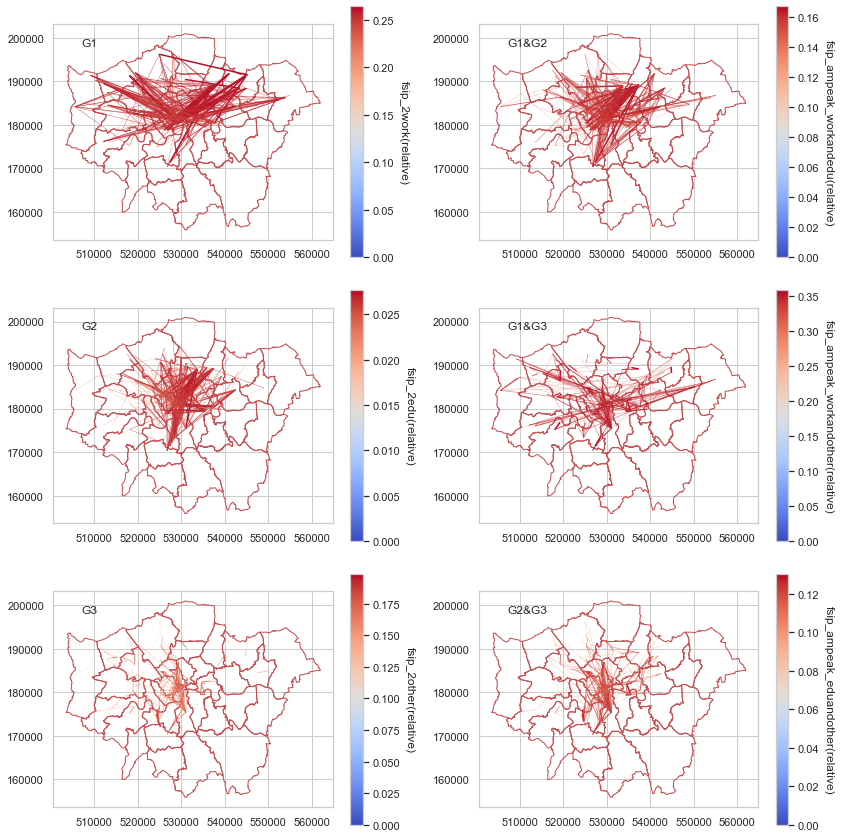

In [1572]:
import matplotlib.pyplot as plt
alphas = [0.05, 0.05, 0.05, 0.05]
lines = [1.0, 1.0, 1.0, 1.0]
# 创建画布和子图
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(12, 12))
plt.subplots_adjust(wspace=0.5, hspace=0.5)

# 在每个子图上绘制地图
London.plot(ax=axs[0, 0], facecolor='None', edgecolor='r')
axs[0, 0].annotate('G1', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[0, 1], facecolor='None', edgecolor='r')
axs[0, 1].annotate('G1&G2', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[1, 0], facecolor='None', edgecolor='r')
axs[1, 0].annotate('G2', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[1, 1], facecolor='None', edgecolor='r')
axs[1, 1].annotate('G1&G3', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[2, 0], facecolor='None', edgecolor='r')
axs[2, 0].annotate('G3', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[2, 1], facecolor='None', edgecolor='r')
axs[2, 1].annotate('G2&G3', xy=(0.1, 0.9), xycoords='axes fraction')



# 在每个子图上绘制线段
odmatrix_vis_relative3(axs[0,0], sorted_df, 'fsip_2work(relative)', lines, alphas)
odmatrix_vis_relative3(axs[1,0], sorted_df, 'fsip_2edu(relative)', lines, alphas)
odmatrix_vis_relative3(axs[2,0], sorted_df, 'fsip_2other(relative)', lines, alphas)
odmatrix_vis_relative3(axs[0,1], sorted_df, 'fsip_ampeak_workandedu(relative)', lines, alphas)
odmatrix_vis_relative3(axs[1,1], sorted_df, 'fsip_ampeak_workandother(relative)', lines, alphas)
odmatrix_vis_relative3(axs[2,1], sorted_df, 'fsip_ampeak_eduandother(relative)', lines, alphas)

# 调整子图之间的间距
plt.tight_layout()
plt.savefig('fuckyoubitch1.pdf')
# 显示图形
plt.show()

### Place-Based Measures (2x6 combined images)

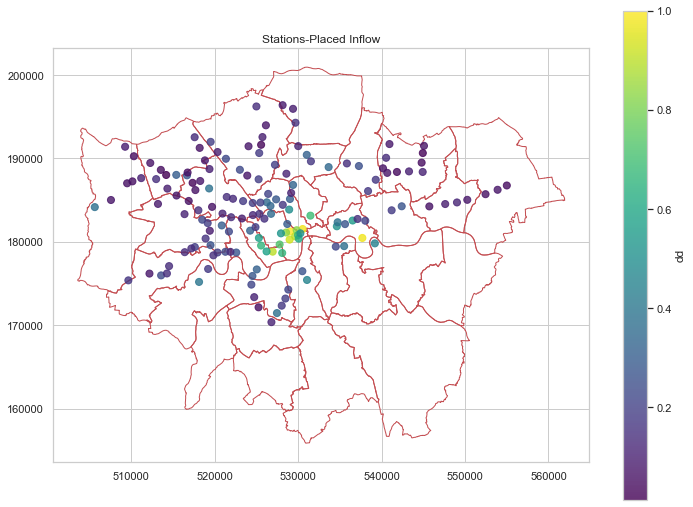

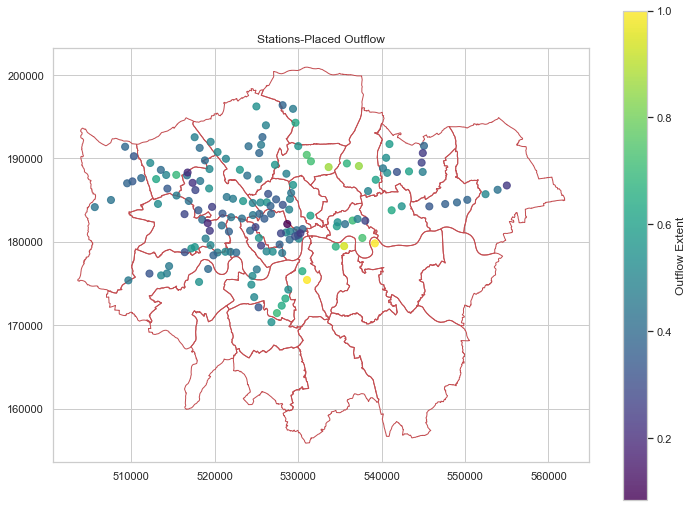

In [1697]:
#We can check that this has occured by plotting the results
London.plot(figsize = (12,9), facecolor = "None", edgecolor = "r")
color = inflow_df['relative_inflow(work)']/inflow_df['relative_inflow(work)'].max()

plt.scatter(inflow_df['dest_x'], inflow_df['dest_y'], c=color, cmap='viridis', s=50,alpha=0.8)
# 添加颜色条
plt.title("Stations-Placed Inflow")
plt.colorbar(label='dd')
plt.show()

#We can check that this has occured by plotting the results
London.plot(figsize = (12, 9), facecolor = "None", edgecolor = "r")
color = outflow_df['relative_outflow(work)']/outflow_df['relative_outflow(work)'].max()

plt.scatter(outflow_df['orig_x'], outflow_df['orig_y'], c=color, cmap='viridis', s=50,alpha=0.8)
# 添加颜色条
plt.title("Stations-Placed Outflow")
plt.colorbar(label='Outflow Extent')
plt.show()

In [1695]:
work_inflow_df

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,relative_inflow(workandedu),place_based_fsip(workandedu),relative_outflow(eduandother),relative_inflow(eduandother),place_based_fsip(eduandother),relative_outflow(workandother),relative_inflow(workandother),place_based_fsip(workandother),relative_inflow_net(work),bin
0,613,Hounslow West,669,Oxford Circus,24,21,47,6,16,0,...,28.545742,0.170221,3.269881,21.842209,0.149705,13.619744,70.686953,0.192677,-36.662288,"(0.0, 100.0]"
1,592,Hainault,852,Canary Wharf,79,260,34,0,0,0,...,26.917748,0.223322,3.870969,18.958976,0.204176,15.549357,64.383165,0.241513,-33.734659,"(0.0, 100.0]"
2,556,Dagenham Heathway,607,Holborn,0,11,63,0,0,0,...,27.441461,0.222354,4.263008,20.541297,0.207534,16.920446,67.814661,0.249510,-33.851143,"(0.0, 100.0]"
3,766,Willesden Junction,590,Green Park,0,21,39,0,0,0,...,26.547790,0.274325,4.925900,20.322724,0.242384,19.645430,65.758322,0.298752,-29.543029,"(0.0, 100.0]"
4,611,Hounslow Central,708,South Kensington,17,7,14,4,0,0,...,25.269005,0.296976,4.928822,18.898951,0.260799,21.090514,61.893233,0.340756,-25.963164,"(0.0, 100.0]"
5,672,Parsons Green,674,Piccadilly Circus,4,84,24,39,0,0,...,24.760216,0.352295,6.462345,18.659710,0.346326,20.692473,62.420691,0.331500,-28.021977,"(0.0, 100.0]"
6,551,Colindale,524,Bond Street,0,62,0,0,0,3,...,23.296657,0.376701,5.292330,17.641470,0.299994,18.836598,58.386498,0.322619,-23.497490,"(0.0, 100.0]"
7,596,Harlesden,728,Tottenham Court Road,2,22,18,114,1,45,...,23.329334,0.241424,3.428306,17.484232,0.196080,13.568818,57.529025,0.235860,-28.067959,"(0.0, 100.0]"
8,664,Oakwood,626,Knightsbridge,11,24,18,0,0,0,...,19.661849,0.391477,4.551677,14.810394,0.307330,17.087045,50.366500,0.339254,-19.519628,"(0.0, 100.0]"
9,598,Harrow-on-the-Hill,507,Angel,0,16,0,0,0,0,...,18.791078,0.584434,7.338688,13.815537,0.531191,28.755950,46.859360,0.613665,-10.756887,"(0.0, 100.0]"


In [1712]:
edu_inflow_df

,From,station_origin,To,station_destination,early_flows,ampeak_flows,midday_flows,pmpeak_flows,evening_flows,late_flows,...,relative_inflow(workandedu),place_based_fsip(workandedu),relative_outflow(eduandother),relative_inflow(eduandother),place_based_fsip(eduandother),relative_outflow(workandother),relative_inflow(workandother),place_based_fsip(workandother),relative_inflow_net(work),bin
0,617,Kensal Green,669,Oxford Circus,2,131,53,0,0,0,...,28.545742,0.242806,4.385288,21.842209,0.200771,16.906373,70.686953,0.239172,-33.582962,"(0.0, 100.0]"
1,657,Northolt,607,Holborn,20,53,30,39,0,0,...,27.441461,0.298204,5.248741,20.541297,0.255521,20.891516,67.814661,0.308068,-29.521844,"(0.0, 100.0]"
2,720,Sudbury Hill,590,Green Park,19,22,0,0,0,0,...,26.547790,0.267051,4.468169,20.322724,0.219861,18.907674,65.758322,0.287533,-28.905204,"(0.0, 100.0]"
3,512,Balham,852,Canary Wharf,91,488,0,0,0,0,...,26.917748,0.482787,9.767797,18.958976,0.515207,29.876299,64.383165,0.464039,-25.953727,"(200.0, 300.0]"
4,743,Wanstead,708,South Kensington,0,0,2,0,0,0,...,25.269005,0.000000,5.275005,18.898951,0.000000,20.573438,61.893233,0.332402,-25.568817,NaN
5,662,Northwood Hills,674,Piccadilly Circus,1,43,5,43,0,0,...,24.760216,0.182255,2.951868,18.659710,0.158195,13.574576,62.420691,0.217469,-31.663419,"(0.0, 100.0]"
6,626,Knightsbridge,728,Tottenham Court Road,0,17,113,44,0,0,...,23.329334,0.265630,4.752012,17.484232,0.271788,17.841403,57.529025,0.310129,-27.232567,"(0.0, 100.0]"
7,663,Notting Hill Gate,524,Bond Street,0,206,320,120,48,0,...,23.296657,0.447455,7.659317,17.641470,0.434165,25.951235,58.386498,0.444473,-21.337410,"(200.0, 300.0]"
8,727,Tooting Broadway,626,Knightsbridge,2,3,0,0,0,0,...,19.661849,0.678654,9.032021,14.810394,0.609843,29.698889,50.366500,0.589656,-12.027081,"(0.0, 100.0]"
9,591,Gunnersbury,631,Leicester Square,0,0,0,12,28,0,...,18.736771,0.000000,4.223437,14.214356,0.000000,15.099806,47.006834,0.321226,-19.898856,NaN


In [1738]:
outflow_sorted_df = od_matrix_new.sort_values(by='relative_outflow(work)', ascending=False)
# 假设 df 是你的 DataFrame，column_name 是你想根据其唯一值进行筛选的列名
work_outflow_df = outflow_sorted_df.drop_duplicates(subset=['station_origin'])

inflow_sorted_df = od_matrix_new.sort_values(by='relative_inflow(work)', ascending=False)
work_inflow_df = inflow_sorted_df.drop_duplicates(subset=['station_destination'])

work_outflow_df.reset_index(drop=True, inplace=True)
work_inflow_df.reset_index(drop=True, inplace=True)

work_outflow_df = work_outflow_df[:30]
work_inflow_df = work_inflow_df[:30]

color1 = work_outflow_df['relative_outflow(work)']/work_outflow_df['relative_outflow(work)'].max()
color2 = work_inflow_df['relative_inflow(work)']/work_inflow_df['relative_inflow(work)'].max()

In [1739]:
outflow_sorted_df = od_matrix_new.sort_values(by='relative_outflow(edu)', ascending=False)
# 假设 df 是你的 DataFrame，column_name 是你想根据其唯一值进行筛选的列名
edu_outflow_df = outflow_sorted_df.drop_duplicates(subset=['station_origin'])

inflow_sorted_df = od_matrix_new.sort_values(by='relative_inflow(edu)', ascending=False)
edu_inflow_df = inflow_sorted_df.drop_duplicates(subset=['station_destination'])

edu_outflow_df.reset_index(drop=True, inplace=True)
edu_inflow_df.reset_index(drop=True, inplace=True)

edu_outflow_df = edu_outflow_df[:30]
edu_inflow_df = edu_inflow_df[:30]

color3 = edu_outflow_df['relative_outflow(edu)']/edu_outflow_df['relative_outflow(edu)'].max()
color4 = edu_inflow_df['relative_inflow(edu)']/edu_inflow_df['relative_inflow(edu)'].max()

In [1740]:
outflow_sorted_df = od_matrix_new.sort_values(by='relative_outflow(other)', ascending=False)
# 假设 df 是你的 DataFrame，column_name 是你想根据其唯一值进行筛选的列名
other_outflow_df = outflow_sorted_df.drop_duplicates(subset=['station_origin'])

inflow_sorted_df = od_matrix_new.sort_values(by='relative_inflow(other)', ascending=False)
other_inflow_df = inflow_sorted_df.drop_duplicates(subset=['station_destination'])

other_outflow_df.reset_index(drop=True, inplace=True)
other_inflow_df.reset_index(drop=True, inplace=True)

other_outflow_df = other_outflow_df[:30]
other_inflow_df = other_inflow_df[:30]

color5 = other_outflow_df['relative_outflow(other)']/other_outflow_df['relative_outflow(other)'].max()
color6 = other_inflow_df['relative_inflow(other)']/other_inflow_df['relative_inflow(other)'].max()

In [1741]:
outflow_sorted_df = od_matrix_new.sort_values(by='relative_outflow(workandedu)', ascending=False)
# 假设 df 是你的 DataFrame，column_name 是你想根据其唯一值进行筛选的列名
workandedu_outflow_df = outflow_sorted_df.drop_duplicates(subset=['station_origin'])

inflow_sorted_df = od_matrix_new.sort_values(by='relative_inflow(workandedu)', ascending=False)
workandedu_inflow_df = inflow_sorted_df.drop_duplicates(subset=['station_destination'])

workandedu_outflow_df.reset_index(drop=True, inplace=True)
workandedu_inflow_df.reset_index(drop=True, inplace=True)

workandedu_outflow_df = workandedu_outflow_df[:30]
workandedu_inflow_df = workandedu_inflow_df[:30]

color7 = workandedu_outflow_df['relative_outflow(workandedu)']/workandedu_outflow_df['relative_outflow(workandedu)'].max()
color8 = workandedu_inflow_df['relative_inflow(workandedu)']/workandedu_inflow_df['relative_inflow(workandedu)'].max()

In [1742]:
outflow_sorted_df = od_matrix_new.sort_values(by='relative_outflow(workandother)', ascending=False)
# 假设 df 是你的 DataFrame，column_name 是你想根据其唯一值进行筛选的列名
workandother_outflow_df = outflow_sorted_df.drop_duplicates(subset=['station_origin'])

inflow_sorted_df = od_matrix_new.sort_values(by='relative_inflow(workandother)', ascending=False)
workandother_inflow_df = inflow_sorted_df.drop_duplicates(subset=['station_destination'])

workandother_outflow_df.reset_index(drop=True, inplace=True)
workandother_inflow_df.reset_index(drop=True, inplace=True)

workandother_outflow_df = workandother_outflow_df[:30]
workandother_inflow_df = workandother_inflow_df[:30]

color9 = workandother_outflow_df['relative_outflow(workandother)']/workandother_outflow_df['relative_outflow(workandother)'].max()
color10 = workandother_inflow_df['relative_inflow(workandother)']/workandother_inflow_df['relative_inflow(workandother)'].max()

In [1743]:
outflow_sorted_df = od_matrix_new.sort_values(by='relative_outflow(eduandother)', ascending=False)
# 假设 df 是你的 DataFrame，column_name 是你想根据其唯一值进行筛选的列名
eduandother_outflow_df = outflow_sorted_df.drop_duplicates(subset=['station_origin'])

inflow_sorted_df = od_matrix_new.sort_values(by='relative_inflow(eduandother)', ascending=False)
eduandother_inflow_df = inflow_sorted_df.drop_duplicates(subset=['station_destination'])

eduandother_outflow_df.reset_index(drop=True, inplace=True)
eduandother_inflow_df.reset_index(drop=True, inplace=True)

eduandother_outflow_df = eduandother_outflow_df[:30]
eduandother_inflow_df = eduandother_inflow_df[:30]

color11 = eduandother_outflow_df['relative_outflow(eduandother)']/eduandother_outflow_df['relative_outflow(eduandother)'].max()
color12 = workandedu_inflow_df['relative_inflow(eduandother)']/workandedu_inflow_df['relative_inflow(eduandother)'].max()

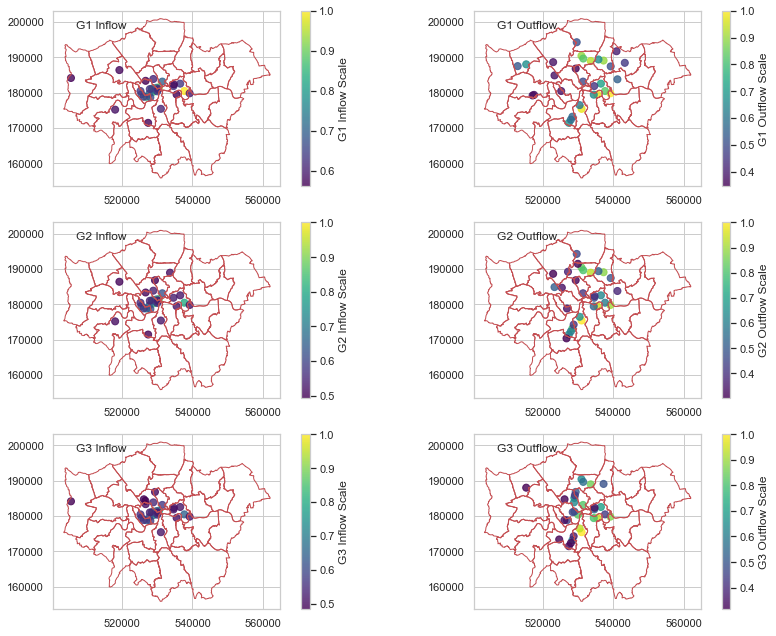

In [1744]:
import matplotlib.pyplot as plt
import geopandas as gpd

# 假设已经有London的地图数据
# London = gpd.read_file('london_map.shp')

# 函数用于绘制散点图
def odmatrix_vis(ax, x, y, c, s, alpha):
    sc = ax.scatter(x, y, c=c, cmap='viridis', s=s, alpha=alpha)
    return sc

# 创建画布和子图
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(12, 9))
plt.subplots_adjust(wspace=0.5, hspace=0.5)

# 在每个子图上绘制地图并添加颜色条
sc1 = odmatrix_vis(axs[0, 0], work_inflow_df['dest_x'], work_inflow_df['dest_y'], color1, s=50, alpha=0.8)
cbar1 = plt.colorbar(sc1, ax=axs[0, 0])
cbar1.set_label('G1 Inflow Scale')

sc2 = odmatrix_vis(axs[0, 1], work_outflow_df['orig_x'], work_outflow_df['orig_y'], color2, s=50, alpha=0.8)
cbar2 = plt.colorbar(sc2, ax=axs[0, 1])
cbar2.set_label('G1 Outflow Scale')

sc3 = odmatrix_vis(axs[1, 0], edu_inflow_df['dest_x'], edu_inflow_df['dest_y'], color3, s=50, alpha=0.8)
cbar3 = plt.colorbar(sc3, ax=axs[1, 0])
cbar3.set_label('G2 Inflow Scale')

sc4 = odmatrix_vis(axs[1, 1], edu_outflow_df['orig_x'], edu_outflow_df['orig_y'], color4, s=50, alpha=0.8)
cbar4 = plt.colorbar(sc4, ax=axs[1, 1])
cbar4.set_label('G2 Outflow Scale')

sc5 = odmatrix_vis(axs[2, 0], other_inflow_df['dest_x'], other_inflow_df['dest_y'], color5, s=50, alpha=0.8)
cbar5 = plt.colorbar(sc5, ax=axs[2, 0])
cbar5.set_label('G3 Inflow Scale')

sc6 = odmatrix_vis(axs[2, 1], other_outflow_df['orig_x'], other_outflow_df['orig_y'], color6, s=50, alpha=0.8)
cbar6 = plt.colorbar(sc6, ax=axs[2, 1])
cbar6.set_label('G3 Outflow Scale')

# 在每个子图上绘制地图
London.plot(ax=axs[0, 0], facecolor='None', edgecolor='r')
axs[0, 0].annotate('G1 Inflow', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[0, 1], facecolor='None', edgecolor='r')
axs[0, 1].annotate('G1 Outflow', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[1, 0], facecolor='None', edgecolor='r')
axs[1, 0].annotate('G2 Inflow', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[1, 1], facecolor='None', edgecolor='r')
axs[1, 1].annotate('G2 Outflow', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[2, 0], facecolor='None', edgecolor='r')
axs[2, 0].annotate('G3 Inflow', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[2, 1], facecolor='None', edgecolor='r')
axs[2, 1].annotate('G3 Outflow', xy=(0.1, 0.9), xycoords='axes fraction')

# 调整子图之间的间距
plt.tight_layout()
plt.savefig('Place_Based_Measures_Intra.pdf')
# 显示图形
plt.show()


In [1775]:
pd.array(eduandother_inflow_df['station_destination'])

<PandasArray>
[         'Oxford Circus',                'Holborn',             'Green Park',
           'Canary Wharf',       'South Kensington',      'Piccadilly Circus',
            'Bond Street',   'Tottenham Court Road',          'Knightsbridge',
       'Leicester Square',                  'Angel',          'Sloane Square',
 'High Street Kensington',          'Charing Cross',        'Gloucester Road',
      'Notting Hill Gate',            'Camden Town',            'Marble Arch',
            'Whitechapel',          'Covent Garden',                'Brixton',
               'Mile End',        'North Greenwich',           'Canada Water',
        "St. John's Wood",               'Richmond',          'Seven Sisters',
          'Bethnal Green',                'Archway',           'Wembley Park']
Length: 30, dtype: object

In [1777]:
pd.array(eduandother_outflow_df['station_origin'])

<PandasArray>
[            'Brixton',        'Canada Water',     'North Greenwich',
       'Seven Sisters',           'Stockwell', 'Walthamstow Central',
          'Wood Green',            'Mile End',              'Balham',
       'Turnpike Lane',          'Bermondsey',               'Angel',
    'Tooting Broadway',        'Canary Wharf',         'Tooting Bec',
         'Whitechapel',       'Charing Cross',             'Archway',
       'Clapham South',        'Kentish Town',    'South Kensington',
         'Camden Town',       'Bethnal Green',     'Blackhorse Road',
      'West Hampstead',     'Willesden Green',         'Leytonstone',
           'Southgate',   'Notting Hill Gate',       'Finchley Road']
Length: 30, dtype: object

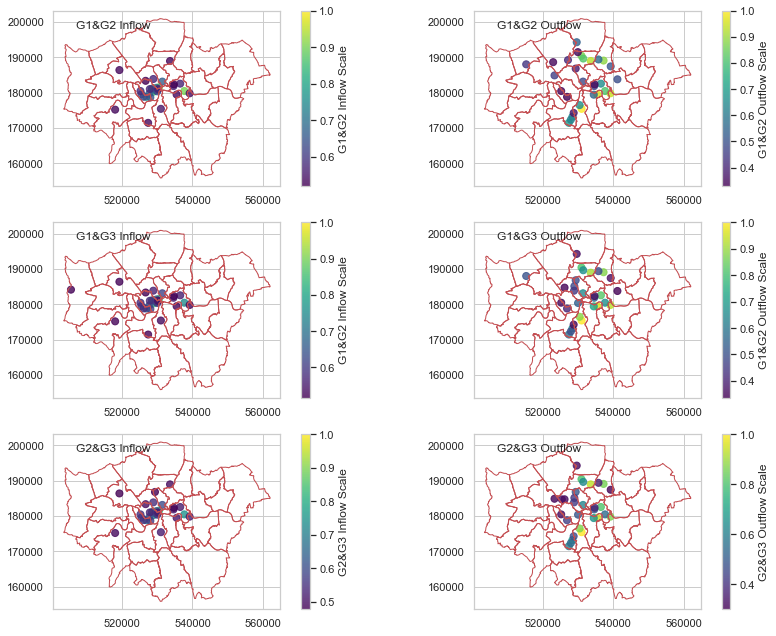

In [1745]:
import matplotlib.pyplot as plt
import geopandas as gpd

# 假设已经有London的地图数据
# London = gpd.read_file('london_map.shp')

# 函数用于绘制散点图
def odmatrix_vis(ax, x, y, c, s, alpha):
    sc = ax.scatter(x, y, c=c, cmap='viridis', s=s, alpha=alpha)
    return sc

# 创建画布和子图
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(12, 9))
plt.subplots_adjust(wspace=0.5, hspace=0.5)

# 在每个子图上绘制地图并添加颜色条
sc1 = odmatrix_vis(axs[0, 0], workandedu_inflow_df['dest_x'], workandedu_inflow_df['dest_y'], color7, s=50, alpha=0.8)
cbar1 = plt.colorbar(sc1, ax=axs[0, 0])
cbar1.set_label('G1&G2 Inflow Scale')

sc2 = odmatrix_vis(axs[0, 1], workandedu_outflow_df['orig_x'], workandedu_outflow_df['orig_y'], color8, s=50, alpha=0.8)
cbar2 = plt.colorbar(sc2, ax=axs[0, 1])
cbar2.set_label('G1&G2 Outflow Scale')

sc3 = odmatrix_vis(axs[1, 0], workandother_inflow_df['dest_x'], workandother_inflow_df['dest_y'], color9, s=50, alpha=0.8)
cbar3 = plt.colorbar(sc3, ax=axs[1, 0])
cbar3.set_label('G1&G2 Inflow Scale')

sc4 = odmatrix_vis(axs[1, 1], workandother_outflow_df['orig_x'], workandother_outflow_df['orig_y'], color10, s=50, alpha=0.8)
cbar4 = plt.colorbar(sc4, ax=axs[1, 1])
cbar4.set_label('G1&G2 Outflow Scale')

sc5 = odmatrix_vis(axs[2, 0], eduandother_inflow_df['dest_x'], eduandother_inflow_df['dest_y'], color11, s=50, alpha=0.8)
cbar5 = plt.colorbar(sc5, ax=axs[2, 0])
cbar5.set_label('G2&G3 Inflow Scale')

sc6 = odmatrix_vis(axs[2, 1], eduandother_outflow_df['orig_x'], eduandother_outflow_df['orig_y'], color12, s=50, alpha=0.8)
cbar6 = plt.colorbar(sc6, ax=axs[2, 1])
cbar6.set_label('G2&G3 Outflow Scale')

# 在每个子图上绘制地图
London.plot(ax=axs[0, 0], facecolor='None', edgecolor='r')
axs[0, 0].annotate('G1&G2 Inflow', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[0, 1], facecolor='None', edgecolor='r')
axs[0, 1].annotate('G1&G2 Outflow', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[1, 0], facecolor='None', edgecolor='r')
axs[1, 0].annotate('G1&G3 Inflow', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[1, 1], facecolor='None', edgecolor='r')
axs[1, 1].annotate('G1&G3 Outflow', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[2, 0], facecolor='None', edgecolor='r')
axs[2, 0].annotate('G2&G3 Inflow', xy=(0.1, 0.9), xycoords='axes fraction')

London.plot(ax=axs[2, 1], facecolor='None', edgecolor='r')
axs[2, 1].annotate('G2&G3 Outflow', xy=(0.1, 0.9), xycoords='axes fraction')

# 调整子图之间的间距
plt.tight_layout()

plt.savefig('Place_Based_Measures_Inter.pdf')
# 显示图形
plt.show()


In [1030]:
od_matrix_new['relative_outflow(eduandother)']

0         6.326567
1         6.326567
2         6.326567
3         6.326567
4         6.326567
           ...    
10693    12.069006
10694    12.069006
10695    12.069006
10696    12.069006
10697    12.069006
Name: relative_outflow(eduandother), Length: 10698, dtype: float64

In [ ]:
outflow_sorted_df = od_matrix_new.sort_values(by='relative_outflow(eduandother)', ascending=False)
# 假设 df 是你的 DataFrame，column_name 是你想根据其唯一值进行筛选的列名
eduandother_outflow_df = outflow_sorted_df.drop_duplicates(subset=['station_origin'])

inflow_sorted_df = od_matrix_new.sort_values(by='relative_inflow(eduandother)', ascending=False)
eduandother_inflow_df = inflow_sorted_df.drop_duplicates(subset=['station_destination'])

eduandother_outflow_df.reset_index(drop=True, inplace=True)
eduandother_inflow_df.reset_index(drop=True, inplace=True)

-----

In [1034]:
def show_values_on_bars(axs, h_v="v", space=0.4):
    def _show_on_single_plot(ax):
        if h_v == "v":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() / 2
                _y = p.get_y() + p.get_height()
                value = int(p.get_height())
                ax.text(_x, _y, value, ha="center") 
        elif h_v == "h":
            for p in ax.patches:
#                 print(p)
                _x = p.get_x() + p.get_width() + float(space)
                _y = (p.get_y()-0.25) + p.get_height()
                value = int(p.get_width())
                ax.text(_x, _y, value, ha="left")

    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _show_on_single_plot(ax)
    else:
        _show_on_single_plot(axs)

In [1035]:
# Inflow top30 stations
workandother_inflow_head30 = workandother_inflow_df.head(30)
# Outflow top30 stations
workandother_outflow_head30 = workandother_outflow_df.head(30)




In [1061]:
workandother_inflow_df['relative_inflow(workandother)']

0      70.686953
1      67.814661
2      65.758322
3      64.383165
4      62.420691
         ...    
153     2.516888
154     2.139700
155     1.790610
156     1.432543
157     1.001368
Name: relative_inflow(workandother), Length: 158, dtype: float64

#### Outflow and Inflow

In [1078]:
od_matrix_new.isna().sum()

From                                  0
station_origin                        0
To                                    0
station_destination                   0
early_flows                           0
ampeak_flows                          0
midday_flows                          0
pmpeak_flows                          0
evening_flows                         0
late_flows                            0
total_flows                           0
orig_x                                0
orig_y                                0
dest_x                                0
dest_y                                0
orig_coord_lat                        0
orig_coord_lon                        0
dest_coord_lat                        0
dest_coord_lon                        0
fsip                                  0
fsip_ampeak                           0
station_dis                           0
ampeak_2work_flows                    0
ampeak_2edu_flows                     0
ampeak_2other_flows                   0


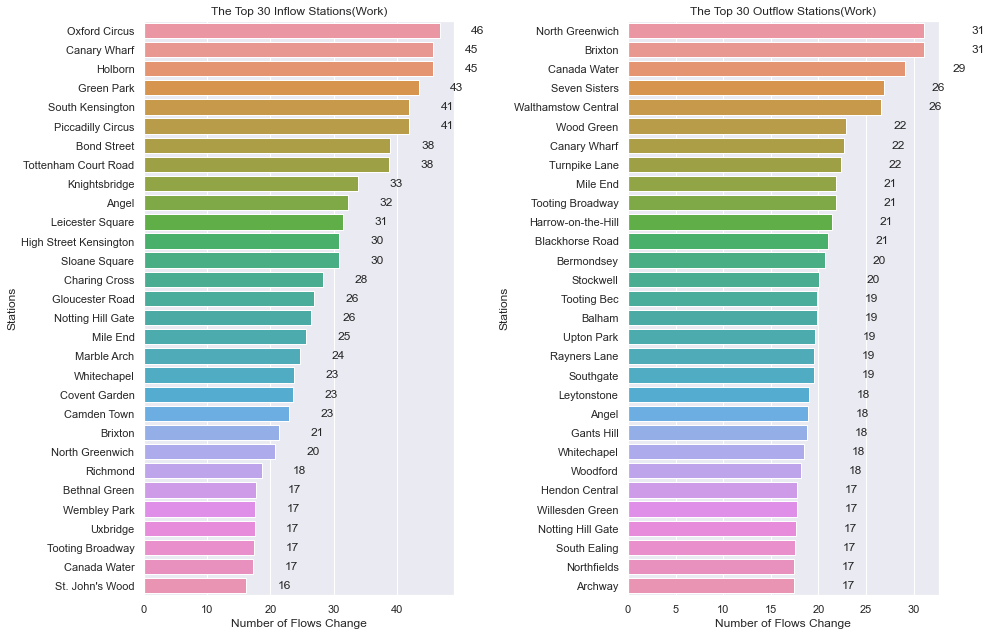

In [1180]:
import matplotlib.pyplot as plt
import seaborn as sns

work_inflow_head30  = work_inflow_df.head(30)
work_outflow_head30 = work_outflow_df.head(30)

# 创建一个2x1的子图布局
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 9))

# 绘制第一个图
sns.barplot(y=list(work_inflow_head30['station_destination']), 
            x=list(work_inflow_head30['relative_inflow(work)']), ax=axs[0])
show_values_on_bars(axs[0], "h", 5.0)
axs[0].set_ylabel('Stations')
axs[0].set_xlabel('Number of Flows Change')
axs[0].set_title('The Top 30 Inflow Stations(Work)')

# 绘制第二个图
sns.barplot(y=list(work_outflow_head30['station_origin']), 
            x=list(work_outflow_head30['relative_outflow(work)']), ax=axs[1])
show_values_on_bars(axs[1], "h", 5.0)
axs[1].set_ylabel('Stations')
axs[1].set_xlabel('Number of Flows Change')
axs[1].set_title('The Top 30 Outflow Stations(Work)')

# 调整子图之间的间距
plt.tight_layout()

plt.savefig('Work_OutandInFlow.pdf')
# 显示图形
plt.show()



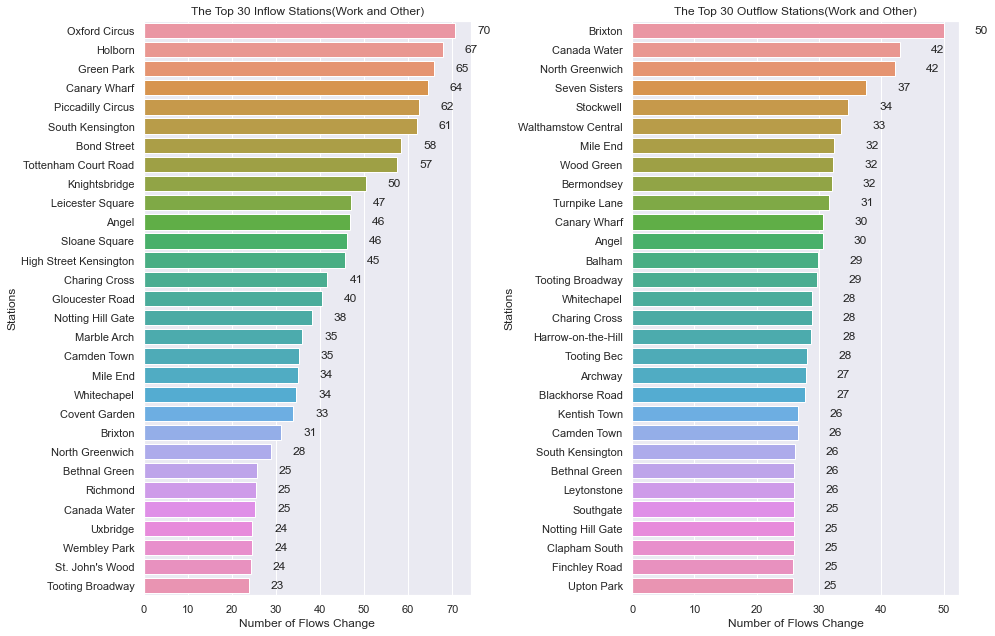

In [1082]:
import matplotlib.pyplot as plt
import seaborn as sns

# 创建一个2x1的子图布局
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 9))

# 绘制第一个图
sns.barplot(y=list(workandother_inflow_head30['station_destination']), 
            x=list(workandother_inflow_head30['relative_inflow(workandother)']), ax=axs[0])
show_values_on_bars(axs[0], "h", 5.0)
axs[0].set_ylabel('Stations')
axs[0].set_xlabel('Number of Flows Change')
axs[0].set_title('The Top 30 Inflow Stations(Work and Other)')

# 绘制第二个图
sns.barplot(y=list(workandother_outflow_head30['station_origin']), 
            x=list(workandother_outflow_head30['relative_outflow(workandother)']), ax=axs[1])
show_values_on_bars(axs[1], "h", 5.0)
axs[1].set_ylabel('Stations')
axs[1].set_xlabel('Number of Flows Change')
axs[1].set_title('The Top 30 Outflow Stations(Work and Other)')

# 调整子图之间的间距
plt.tight_layout()

plt.savefig('gofuckyourself.pdf')
# 显示图形
plt.show()